In [1]:
# Standard libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
from sklearn.model_selection import train_test_split

# For Machine Learning (Torch)
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

In [2]:
learning_rate = 0.001
Batch_size = 64
root = "tensile_fatigue_data_v14.xlsx"
root2 = "heatmap_AMed_metals.xlsx"

## Correlation Analysis

In [3]:
df1 = pd.read_excel(root)
df2 = pd.read_excel(root2)

df2.head(5)

,Fatigue limit,"Layer thickness,um","Stress ratio,R","Surface roughness,um, Ra or Sa",porosity,"Yield strength,MPa","Tensile strength, MPa",Total strain
0,210.0,30,0.1,13.0,0.0040,870,1050,0.075
1,510.0,30,0.1,0.5,0.0040,870,1050,0.075
2,112.5,30,0.1,13.1,0.0010,453,573,0.460
3,200.0,30,0.1,0.5,0.0003,453,573,0.460
4,90.0,50,0.1,15.0,0.0027,453,573,0.460


Text(0.5, 1.0, 'Correlation Heatmap of various inputs to Fatigue in AM materials')

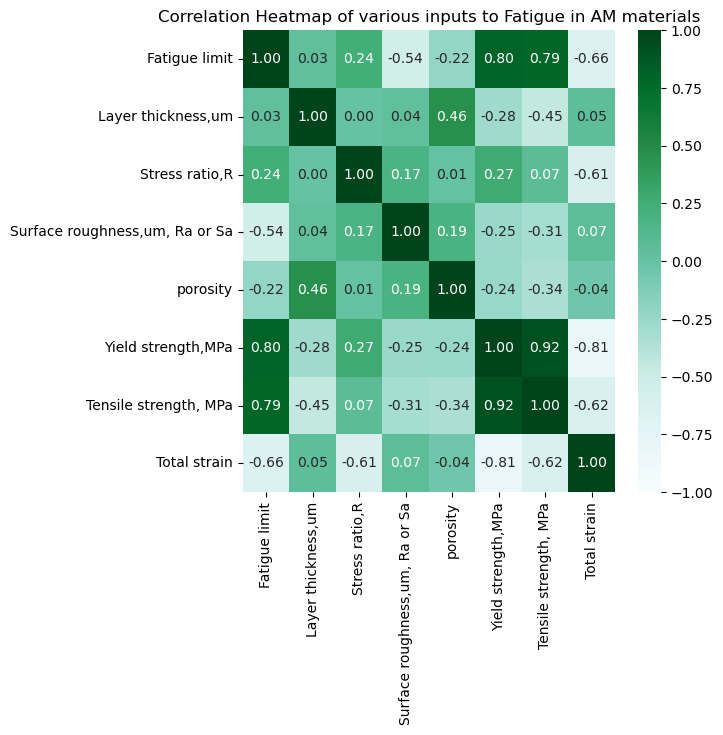

In [25]:
f, axes = plt.subplots(1, 1, figsize = (6,6))

g1 = sb.heatmap(df2.corr(), vmin = -1, vmax = 1, annot = True, fmt = ".2f", cmap = "BuGn")
g1.set_title("Correlation Heatmap of various inputs to Fatigue in AM materials")

Text(0.5, 1.0, 'Correlation Heatmap of Tensile inputs to Fatigue Constants')

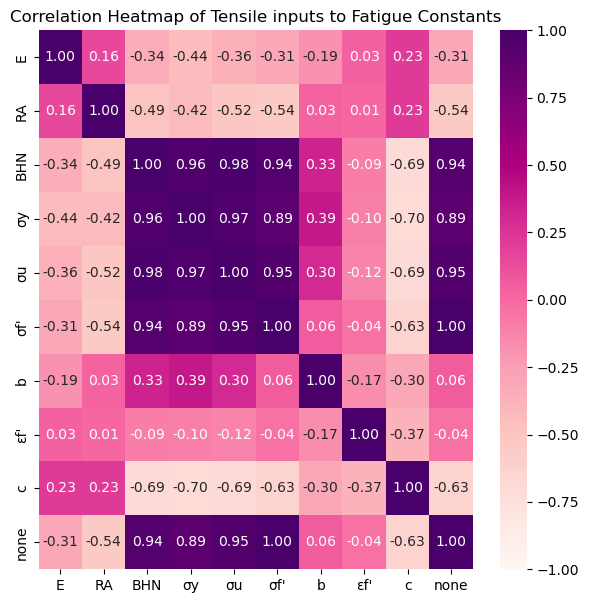

In [28]:
f, axes = plt.subplots(1, 1, figsize = (7, 7), sharey = True)

g2 = sb.heatmap(df1.corr(), vmin = -1, vmax = 1, annot = True, fmt = ".2f", cmap = "RdPu")
g2.set_title("Correlation Heatmap of Tensile inputs to Fatigue Constants")

## Deep Neural Network

In [4]:
# Very simple Deep Neural Network with 3 hidden layers

class NeuralNetwork(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
        nn.Linear(5, 32), nn.ReLU(),
        nn.Linear(32, 64), nn.ReLU(),
        nn.Linear(64, 64), nn.ReLU(),
        nn.Linear(64, 32), nn.ReLU(),
        nn.Linear(32, 5)
        )

    def forward(self, x):
        y = self.net(x)
        return y
            
    def loss_f(self, x, y):
        loss_func = nn.MSELoss()
        return loss_func(self.forward(x),y)

class SingleOutputNeuralNetwork(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
        nn.Linear(7, 32), nn.ReLU(),
        nn.Linear(32, 64), nn.ReLU(),
        nn.Linear(64, 64), nn.ReLU(),
        nn.Linear(64, 32), nn.ReLU(),
        nn.Linear(32, 1)
        )

    def forward(self, x):
        y = self.net(x)
        return y
            
    def loss_f(self, x, y):
        loss_func = nn.MSELoss()
        return loss_func(self.forward(x),y)

## Single Output

In [103]:
df_x = pd.read_excel(root,usecols=[0,1,2,3,4])
df_y = pd.read_excel(root,usecols=[5])

df_x_train, df_x_test, df_y_train, df_y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 100)

# Training Set
df_x_train = np.array(df_x_train,dtype = np.float32)
df_y_train = np.array(df_y_train,dtype = np.float32)

df_x_train = torch.from_numpy(df_x_train)   #Create Tensor from numpy array
df_y_train = torch.from_numpy(df_y_train)

# Test Set
df_x_test = np.array(df_x_test,dtype = np.float32)
df_y_test = np.array(df_y_test,dtype = np.float32)

df_x_test = torch.from_numpy(df_x_test)
df_y_test = torch.from_numpy(df_y_test)


# Create PyTorch datasets and dataloaders
train_dataset = TensorDataset(df_x_train, df_y_train)
train_loader = DataLoader(train_dataset, batch_size=Batch_size, shuffle=True)

Epoch 1, loss: 26637.177734375
Train set
[1.24       1.044      1.3260001  0.54       1.08       1.825
 1.622      0.989      1.         1.45       1.24       1.255
 2.105      1.127      1.168      1.4        2.17       0.515
 1.162      1.928      2.69       1.117      2.275      1.585
 0.97800004 1.04       3.17       1.04       2.07       1.855
 2.24       1.2        1.93       1.78       1.655      1.043
 1.094      2.585      1.54       2.         1.895      0.821
 2.725      2.655      1.585      1.22       0.895      1.86      ]
[0.02668139 0.02499691 0.0308803  0.02069659 0.0311392  0.03834381
 0.02604461 0.0265111  0.03278752 0.02911886 0.02601756 0.02875132
 0.0511687  0.02782223 0.02814161 0.03053314 0.04649152 0.02101224
 0.03135397 0.03596676 0.049615   0.02619827 0.04661676 0.03545244
 0.02491219 0.02949348 0.06252244 0.0318569  0.04910105 0.03854653
 0.05303222 0.03063322 0.04195169 0.04143474 0.0408962  0.02016388
 0.02690235 0.05012548 0.02337629 0.0433164  0.04008812

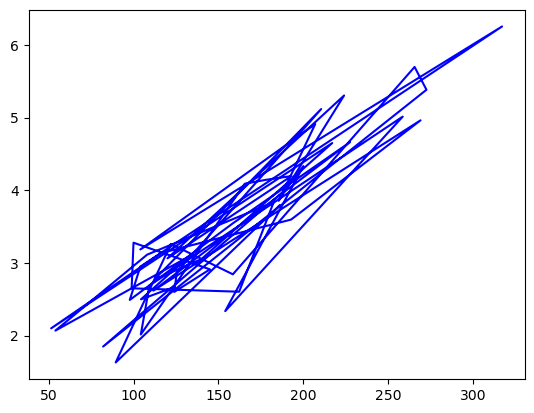

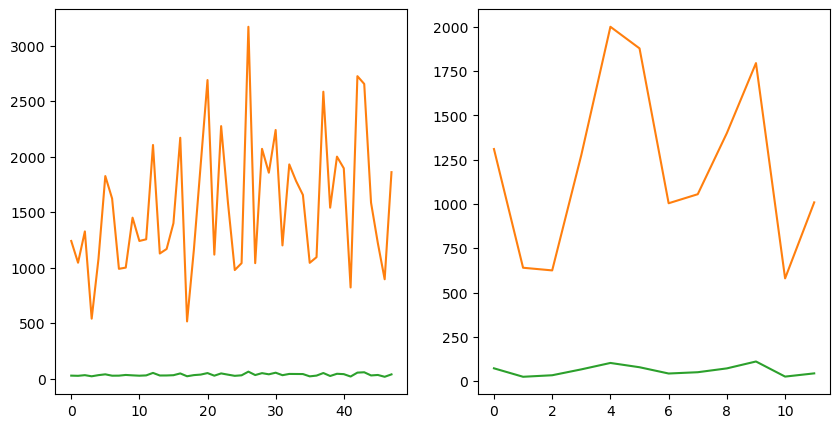

Epoch 11, loss: 8813.7197265625
Train set
[2.         1.22       1.855      3.17       2.105      1.825
 0.515      2.17       1.622      1.895      1.094      1.08
 2.07       1.162      1.04       0.895      1.044      1.585
 1.585      0.54       1.3260001  1.         2.24       1.2
 1.043      1.168      1.4        1.78       2.275      1.655
 2.69       2.655      0.97800004 1.54       1.24       2.725
 1.86       1.117      1.04       1.93       0.821      0.989
 1.24       1.255      1.45       1.127      1.928      2.585     ]
[1.0006874  0.54317975 0.8812275  1.3906633  1.1518087  0.8368219
 0.28302154 1.098088   0.4013653  0.8974456  0.4256192  0.42923528
 1.1952004  0.42703563 0.47301438 0.23806113 0.45776963 0.6175364
 0.7736282  0.2526861  0.4107406  0.50257844 1.1844434  0.44395187
 0.30334735 0.3963092  0.42735156 0.94275916 1.0442735  0.89111036
 1.1383798  1.1915467  0.43243304 0.31837726 0.53181607 1.2238926
 0.83476985 0.3629005  0.42301828 0.95795107 0.27042523 0.41

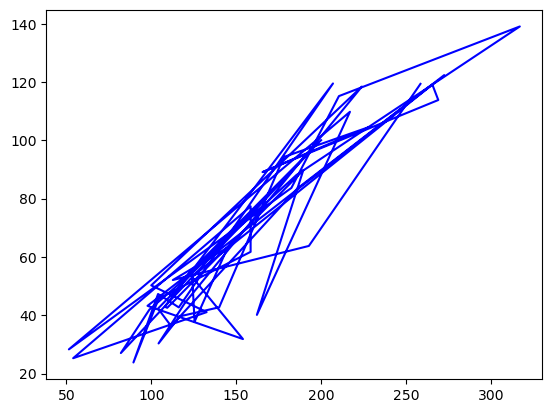

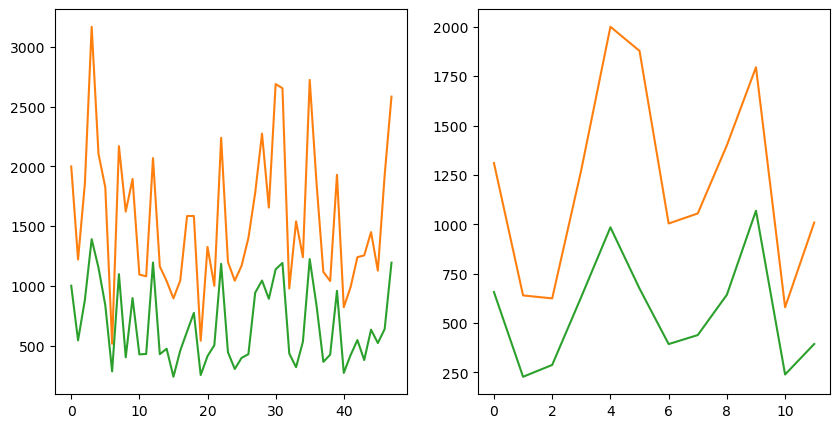

Epoch 21, loss: 3071.661865234375
Train set
[1.168      1.162      1.54       2.69       2.24       1.044
 1.78       2.         1.127      1.24       1.22       0.895
 0.821      1.855      1.255      2.07       2.725      1.08
 1.622      2.17       1.825      1.117      3.17       1.24
 1.655      2.105      1.094      1.93       0.97800004 2.275
 1.2        0.54       1.4        1.928      1.585      0.989
 1.043      2.655      1.86       1.895      1.585      1.3260001
 1.45       1.         1.04       2.585      0.515      1.04      ]
[1.1612637  1.2460152  0.9422146  3.1953998  3.3320222  1.3245409
 2.6738763  2.8396308  1.493068   1.5367907  1.5495465  0.70547754
 0.79934984 2.5096989  1.1075522  3.3558917  3.4820385  1.2505097
 1.1717935  3.107364   2.37516    1.0649018  3.9414458  1.5696515
 2.5312784  3.2329102  1.234138   2.7163765  1.2559148  2.9671226
 1.2833664  0.7286281  1.2408851  1.83138    1.7627554  1.2215532
 0.893434   3.3692517  2.3822298  2.5465243  2.216616  

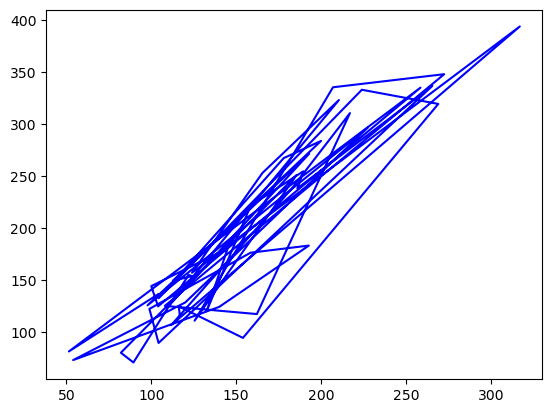

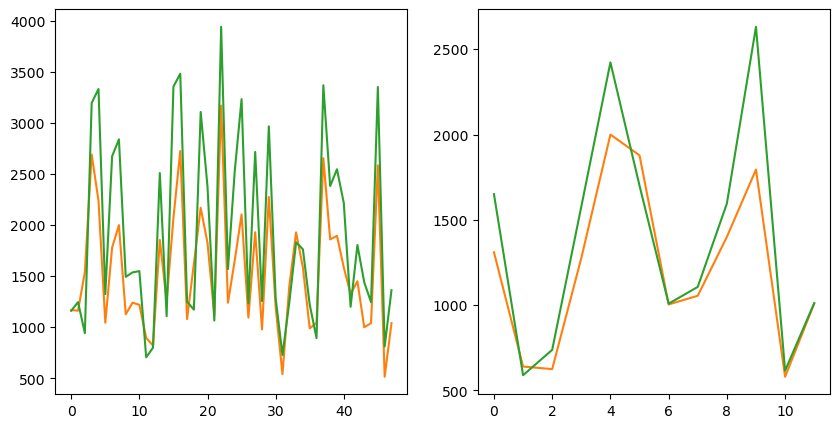

Epoch 31, loss: 805.1829223632812
Train set
[1.45       1.044      1.094      1.127      1.54       1.928
 1.24       2.17       1.825      1.117      1.93       2.105
 2.725      2.655      1.78       1.24       0.895      1.855
 2.07       2.24       0.54       1.         1.043      2.275
 1.04       1.255      1.86       2.585      1.655      1.585
 1.168      0.97800004 1.04       1.162      0.989      1.4
 0.515      2.         1.3260001  1.622      1.585      1.08
 2.69       1.22       0.821      1.2        1.895      3.17      ]
[1.2772214  1.0010656  0.92993826 1.0648094  0.71032053 1.3647606
 1.0873222  2.2039394  1.6797158  0.7980933  1.9234751  2.2881289
 2.4661906  2.4207013  1.8930508  1.1127129  0.52833563 1.7797194
 2.3784554  2.3549368  0.5252174  1.0427513  0.67263395 2.0993447
 1.0369346  0.8276871  1.6837904  2.37422    1.7871559  1.5660908
 0.870451   0.9190074  0.9156052  0.9053236  0.91848785 0.9050194
 0.58466685 2.0118148  0.8960511  0.87500846 1.2479185  0.910

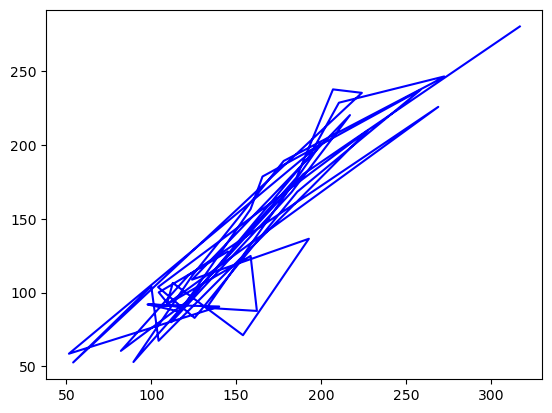

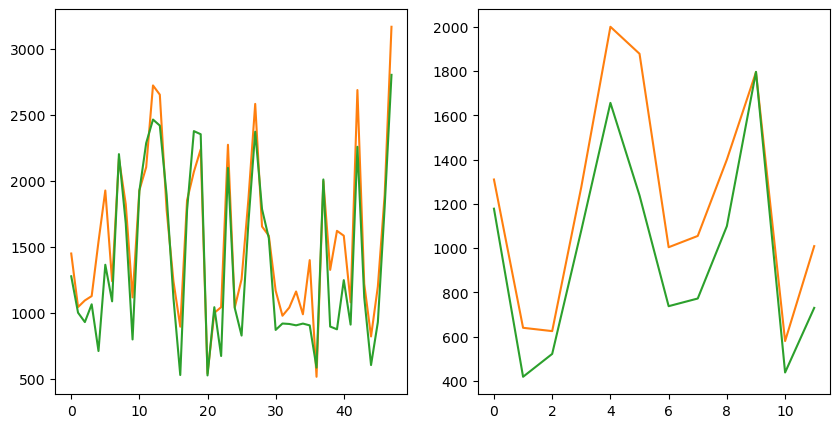

Epoch 41, loss: 569.9786987304688
Train set
[1.4        0.989      1.622      1.08       1.855      0.515
 1.04       1.168      1.117      2.725      2.17       1.825
 1.162      1.585      0.821      1.         0.97800004 1.78
 1.93       1.24       1.585      3.17       2.585      1.043
 0.895      1.895      1.3260001  1.127      1.094      2.
 2.07       1.255      1.86       1.54       1.24       2.655
 1.655      1.928      2.275      2.69       1.45       1.04
 2.24       1.22       1.044      1.2        2.105      0.54      ]
[0.9839108  1.0221158  0.96779954 0.9895284  1.8246502  0.6130403
 1.1614265  0.9688135  0.8885106  2.5659707  2.2332535  1.6708876
 0.98210007 1.5732993  0.68123573 1.1216804  0.9986882  1.9013085
 1.9335828  1.1083359  1.2508423  2.9542866  2.3531787  0.7537108
 0.59383917 1.8019702  0.99206567 1.1219677  1.0354992  2.036424
 2.3688245  0.9182988  1.6880325  0.80006236 1.1292219  2.5735526
 1.7750201  1.4950092  2.1019154  2.2369566  1.2787203  1.004568

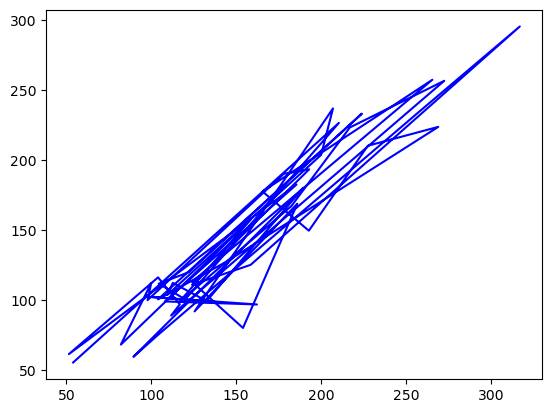

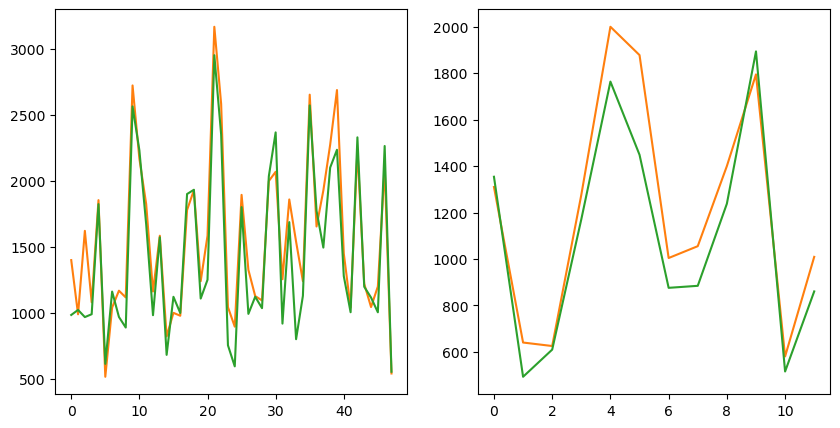

Epoch 51, loss: 492.6408996582031
Train set
[1.08       0.97800004 1.22       1.         1.93       2.655
 1.54       1.2        1.585      1.3260001  1.127      0.821
 1.04       1.162      1.24       2.725      2.69       2.275
 1.855      2.585      2.105      1.117      0.895      1.043
 1.255      0.515      0.989      1.655      1.895      1.928
 0.54       2.24       2.         1.094      1.45       1.86
 2.07       1.044      1.622      3.17       1.825      1.78
 1.585      2.17       1.04       1.24       1.168      1.4       ]
[1.1323643  1.141742   1.3536196  1.2722455  2.127007   2.8818598
 0.9375139  1.1429385  1.3691885  1.1484869  1.2604693  0.79947317
 1.1560953  1.1228416  1.2260015  2.8472478  2.4143968  2.310225
 2.0182502  2.555097   2.4518974  1.0329925  0.6954833  0.88018286
 1.0649852  0.6915085  1.1868533  1.9231732  1.9797173  1.7142823
 0.62546426 2.520759   2.2435036  1.2024366  1.3978142  1.852966
 2.5832386  1.2967772  1.1196178  3.2904794  1.8181473  2.09

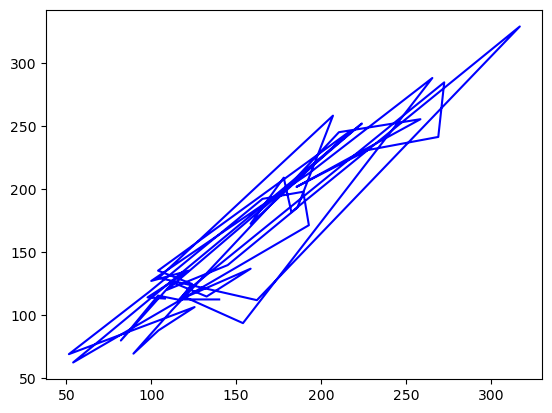

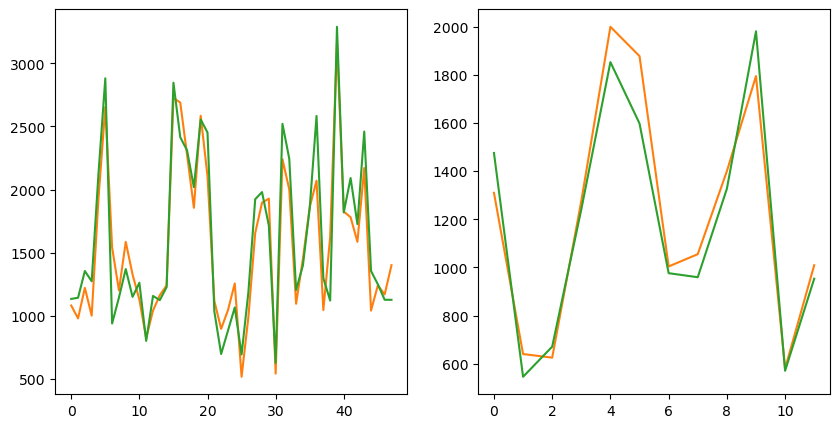

Epoch 61, loss: 436.4692077636719
Train set
[1.928      1.08       1.127      0.54       1.22       1.585
 1.86       0.821      1.78       2.725      1.585      2.07
 1.45       1.         1.825      1.043      1.93       1.04
 2.105      0.989      1.094      0.895      1.24       1.4
 2.69       0.515      1.3260001  2.24       1.855      0.97800004
 1.895      3.17       1.655      1.044      2.655      1.255
 1.117      2.17       2.585      1.24       1.168      1.162
 1.54       1.622      2.         1.04       2.275      1.2       ]
[1.6190399  1.0600239  1.1549746  0.58168846 1.2538837  1.2577256
 1.6938483  0.7697102  1.9019156  2.5940216  1.5811355  2.3527033
 1.2844757  1.1824429  1.6683737  0.8435499  1.9336653  1.2995491
 2.2533267  1.1323167  1.1480801  0.6677284  1.1257321  1.0543331
 2.2261648  0.6406242  1.0908539  2.3177118  1.8323312  1.0705026
 1.8038694  3.0146258  1.7662522  1.2398462  2.6597235  1.0131612
 0.98548144 2.228857   2.3457434  1.1451381  1.0732361  1

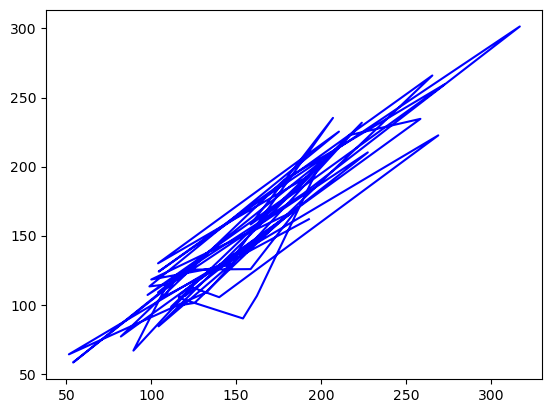

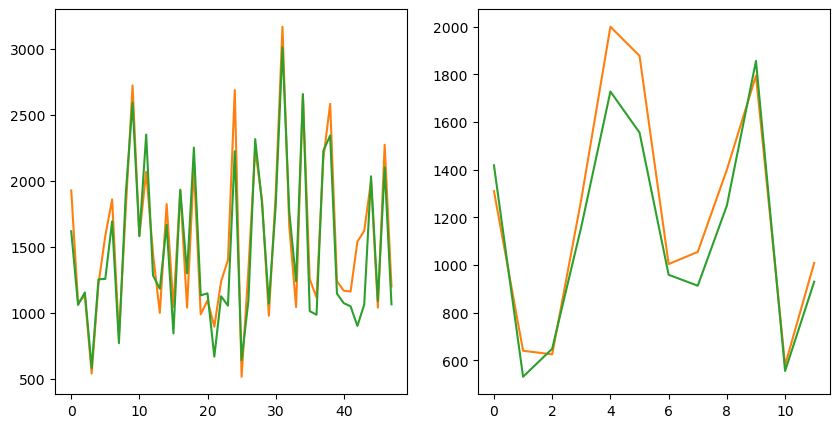

Epoch 71, loss: 399.872802734375
Train set
[1.4        1.78       0.895      2.07       1.168      2.
 1.825      1.127      1.162      1.54       2.655      2.105
 1.04       1.2        2.17       1.24       1.86       1.855
 1.24       0.97800004 1.655      3.17       1.622      1.3260001
 1.04       1.928      1.45       1.         1.255      1.93
 1.895      2.585      2.24       0.821      1.08       1.044
 1.117      2.69       2.275      2.725      0.989      1.094
 0.515      1.22       1.043      1.585      1.585      0.54      ]
[1.1487831  1.9945204  0.7399011  2.4526956  1.1819116  2.1384337
 1.7475563  1.2450497  1.1438867  0.9972749  2.8562002  2.3423748
 1.4326085  1.1567816  2.3403716  1.1987396  1.7792434  1.9381671
 1.2154595  1.1664755  1.8408883  3.215527   1.1678871  1.1983396
 1.1920172  1.7663347  1.3511348  1.2818468  1.1144996  2.0281434
 1.8915917  2.442926   2.4091225  0.85344267 1.1560818  1.363921
 1.0859249  2.3139606  2.2043383  2.7540526  1.2460212  1.26

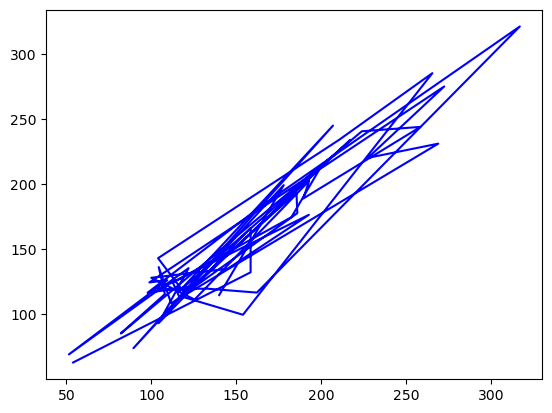

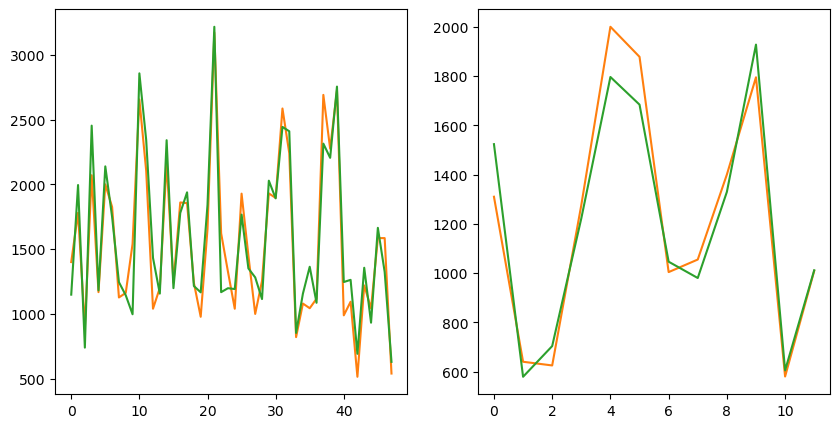

Epoch 81, loss: 387.4328308105469
Train set
[2.275      2.105      2.69       2.655      1.585      1.044
 1.168      0.515      0.895      1.094      1.24       1.04
 0.54       2.07       1.86       1.22       1.585      0.821
 2.24       1.043      1.2        1.255      1.         1.3260001
 1.08       1.78       1.117      3.17       2.585      1.54
 2.         1.928      1.825      1.162      1.24       0.97800004
 1.45       1.622      1.93       0.989      2.725      1.127
 1.855      1.895      1.4        1.04       2.17       1.655     ]
[2.1252227  2.27561    2.2477984  2.7336686  1.2728804  1.3299346
 1.1515218  0.66879827 0.7239991  1.230513   1.149486   1.3990582
 0.60978967 2.3750868  1.7120185  1.3026633  1.5999124  0.835785
 2.3401437  0.9108969  1.1146752  1.084794   1.2334454  1.1654391
 1.1169765  1.9173615  1.0584694  3.066308   2.372608   0.9752416
 2.0521367  1.711279   1.6905943  1.1045766  1.1650953  1.1274235
 1.299856   1.1357408  1.9471695  1.214115   2.62496

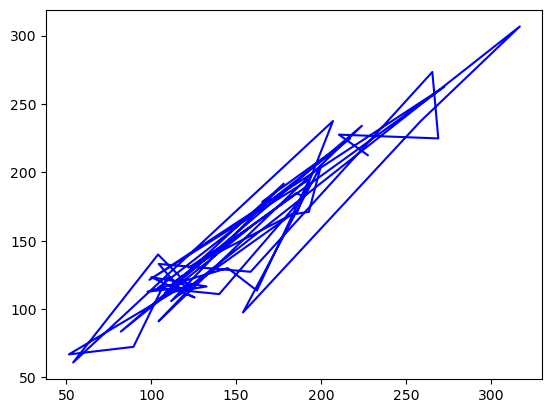

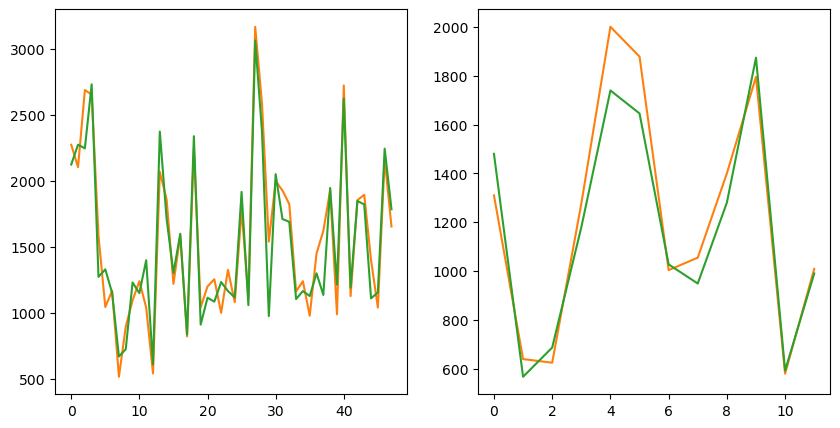

Epoch 91, loss: 382.6784362792969
Train set
[1.044      1.825      1.162      3.17       1.895      1.3260001
 1.04       1.86       1.117      1.622      1.928      1.78
 1.655      1.855      1.585      2.07       1.24       1.168
 1.93       0.515      1.45       1.127      0.989      2.105
 2.585      2.655      1.08       1.24       0.54       0.97800004
 2.24       1.094      2.275      1.043      1.22       2.
 2.725      0.821      1.2        2.69       1.04       1.4
 0.895      2.17       1.         1.585      1.54       1.255     ]
[1.3685777  1.7225945  1.1356059  3.1312733  1.8568969  1.1998956
 1.1881077  1.7470964  1.0909698  1.1688526  1.7556963  1.9544427
 1.8189908  1.8859035  1.6332203  2.4177089  1.1767378  1.18641
 1.9858699  0.6876126  1.3262099  1.2207791  1.2500666  2.3148816
 2.4155912  2.7942362  1.1482655  1.1916285  0.6276224  1.1580364
 2.3807132  1.2664747  2.165394   0.93981916 1.3349048  2.0907142
 2.678325   0.8634507  1.1442486  2.2867992  1.4399004  1

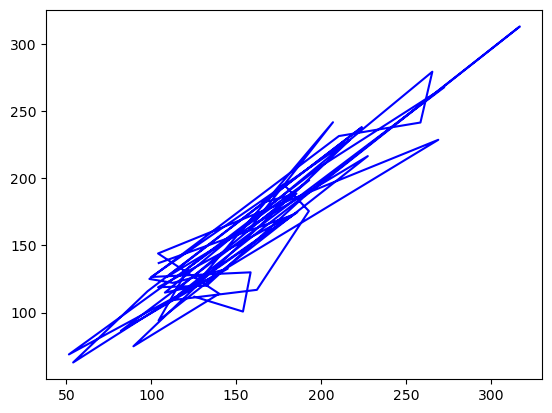

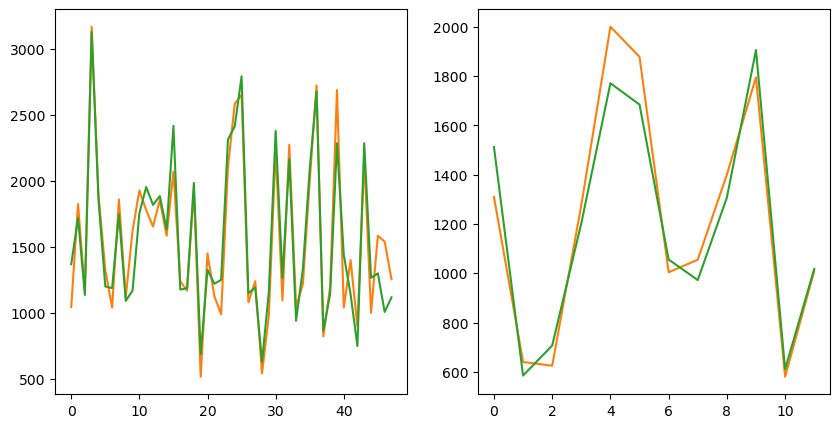

In [132]:
model = SingleOutputNeuralNetwork()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
loss_func = torch.nn.MSELoss()  # this is for regression mean squared loss

# Train the model
num_epochs = 100 #100000
losses = []

plt.ion()

for epoch in range(num_epochs):
    for x_batch, y_batch in train_loader:
        # Forward pass
        y_predict = model(x_batch)
        loss = loss_func(y_predict, y_batch)
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        losses.append(loss.item())
        y_test_predict = model(df_x_test)
        
        if epoch % 10 == 0:
            print(f"Epoch {epoch+1}, loss: {loss.item()}")
            print("Train set")
            print(y_batch.data.numpy().squeeze()/100)
            print(y_predict.detach().numpy().squeeze()/100)
            print("Test set")
            print(df_y_test.data.numpy().squeeze()/100)
            print(y_test_predict.detach().numpy().squeeze()/100)
            
            plt.cla()
            plt.plot(y_batch,y_predict.detach().numpy(),'b-')

            fig, axes = plt.subplots(1, 2, figsize = (10,5))
            # axes[0].scatter(y_batch,y_predict.detach().numpy())
            # axes[1].scatter(df_y_test,y_test_predict.detach().numpy())

            axes[0].plot(y_batch.data.numpy().squeeze()*10,'tab:orange', label = 'real')
            axes[1].plot(df_y_test.data.numpy().squeeze()*10, 'tab:orange',label = 'real')

            axes[0].plot(y_predict.detach().numpy()*10,'tab:green',label = 'pred')
            axes[1].plot(y_test_predict.detach().numpy()*10,'tab:green',label = 'pred')
            
            # fig, axs = plt.subplots(1, 2,figsize =(5,5))
            # # Real Values
            # axs[0, 0].plot(y_batch.data.numpy().squeeze()*10,'tab:orange', label = 'real')
            # axs[0, 0].set_title('σf')
            # axs[0, 0].legend(fontsize ='large')
            
            # axs[0, 1].plot(df_y_test.data.numpy().squeeze()*10, 'tab:orange',label = 'real')
            # axs[0, 1].set_title('σf')
            # axs[0, 1].legend(fontsize ='large')    
                          
    
            # # Predicted Values

            # axs[0, 0].plot(y_predict.detach().numpy()*10,'tab:green',label = 'pred')
            # axs[0, 0].set_title('σf')
            # axs[0, 0].legend(fontsize ='large')

            # axs[0, 1].plot(y_test_predict.detach().numpy()*10,'tab:green',label = 'pred')
            # axs[0, 1].set_title('σf')
            # axs[0, 1].legend(fontsize ='large')
        
            plt.draw();plt.pause(0.05)
                 
plt.ioff()
plt.show()

## Multiple Output

In [5]:
df_x = pd.read_excel(root,usecols=[0,1,2,3,4])
df_y = pd.read_excel(root,usecols=[5,6,7,8,9])

df_x_train, df_x_test, df_y_train, df_y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 100)

# Training Set
df_x_train = np.array(df_x_train,dtype = np.float32)
df_y_train = np.array(df_y_train,dtype = np.float32)

df_x_train = torch.from_numpy(df_x_train)   #Create Tensor from numpy array
df_y_train = torch.from_numpy(df_y_train)

# Test Set
df_x_test = np.array(df_x_test,dtype = np.float32)
df_y_test = np.array(df_y_test,dtype = np.float32)

df_x_test = torch.from_numpy(df_x_test)
df_y_test = torch.from_numpy(df_y_test)


# Create PyTorch datasets and dataloaders
train_dataset = TensorDataset(df_x_train, df_y_train)
train_loader = DataLoader(train_dataset, batch_size=Batch_size, shuffle=True)

Epoch 1, loss: 15432.2626953125
Train set
[1.928      1.655      1.22       1.895      0.515      1.78
 1.622      1.45       1.86       1.168      1.825      1.3260001
 0.821      2.275      1.585      1.585      2.585      0.895
 1.127      1.04       1.         1.255      2.         1.54
 2.105      2.17       1.4        1.04       1.93       2.725
 1.2        2.24       2.07       1.117      0.989      1.094
 1.044      0.97800004 3.17       0.54       1.162      1.24
 1.08       2.655      1.855      2.69       1.24       1.043     ]
[0.02686732 0.04647914 0.02717912 0.04641703 0.0135853  0.04956247
 0.02193094 0.03228081 0.04450839 0.02396865 0.04320963 0.02399241
 0.02031717 0.05601069 0.03178052 0.04103849 0.06211405 0.0178495
 0.02560349 0.02384594 0.02598082 0.02310278 0.05236958 0.02243375
 0.05710484 0.05667165 0.02366288 0.02633675 0.0500308  0.06319617
 0.0232996  0.05999267 0.0598531  0.02296552 0.02319062 0.02327965
 0.02516358 0.02255984 0.06954222 0.01252956 0.0236539

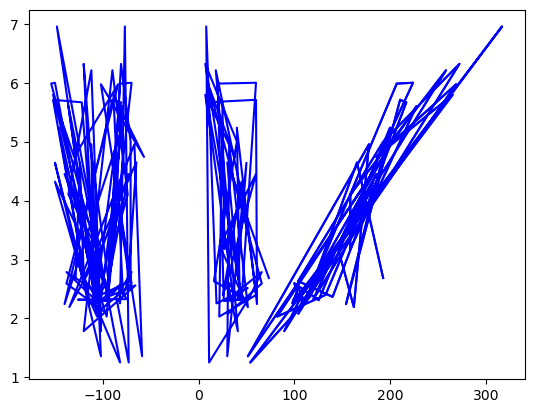

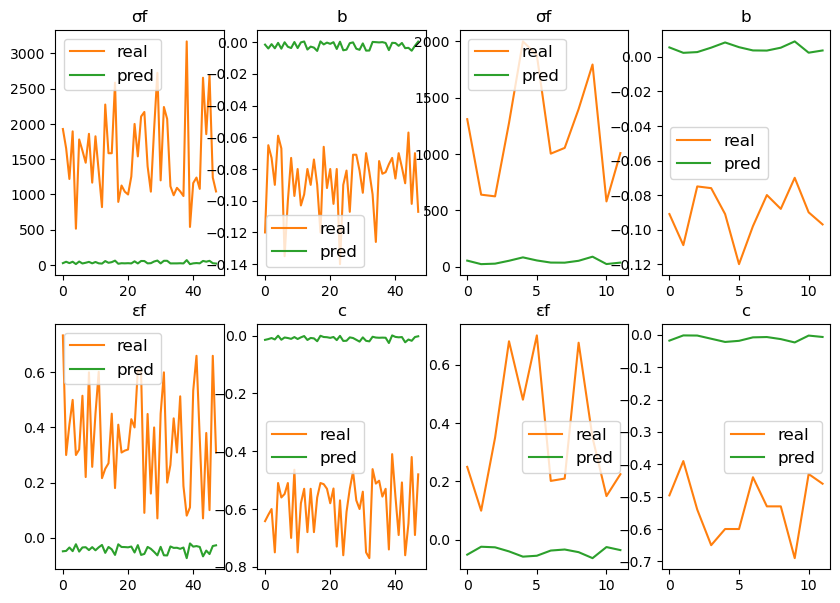

Epoch 11, loss: 11046.1748046875
Train set
[1.22       1.895      2.725      2.         2.105      1.585
 1.24       0.895      1.622      1.2        2.17       1.094
 1.86       1.127      1.043      1.255      1.044      2.69
 0.821      2.585      0.989      1.08       1.93       2.655
 2.24       1.54       1.24       1.162      2.275      0.97800004
 1.78       0.515      1.585      1.655      3.17       2.07
 1.45       1.4        1.         1.3260001  0.54       1.825
 1.04       1.168      1.928      1.855      1.117      1.04      ]
[0.29027268 0.45342618 0.6157984  0.5043113  0.5650368  0.40011743
 0.2898149  0.1491893  0.2245082  0.24423482 0.54942966 0.23559238
 0.42750984 0.2823174  0.1793097  0.21505824 0.25177515 0.5609166
 0.1662356  0.5889351  0.23438998 0.24073777 0.48244268 0.5984269
 0.58206993 0.18682818 0.28557068 0.2404149  0.52801573 0.23575088
 0.475378   0.16156727 0.32003066 0.4500621  0.69274974 0.587399
 0.32722962 0.2380572  0.27161673 0.23107754 0.1476785

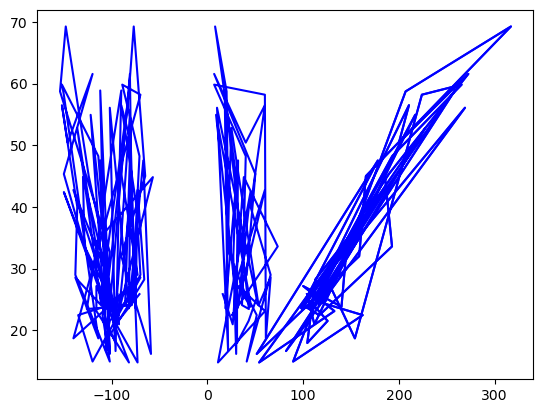

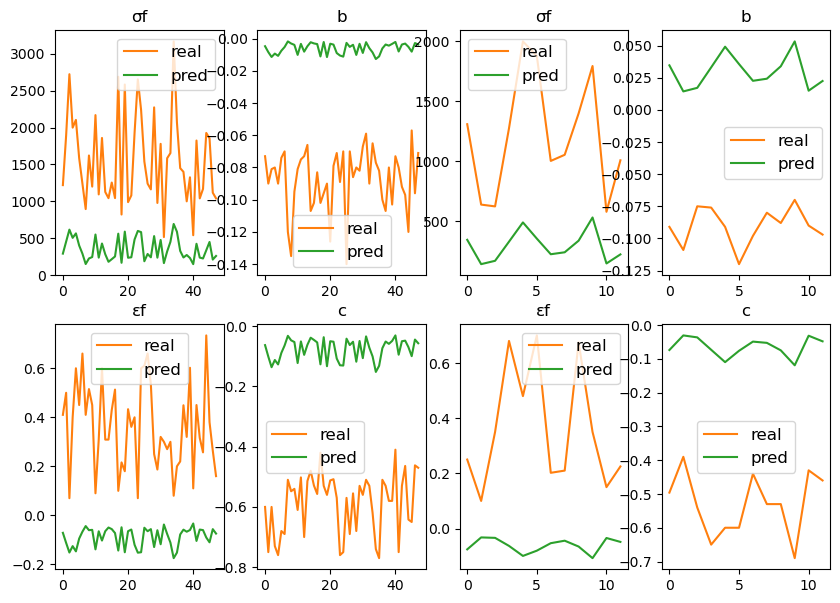

Epoch 21, loss: 3421.84765625
Train set
[1.162      2.69       2.585      2.275      3.17       0.821
 0.989      1.044      2.17       1.117      1.622      1.93
 1.86       1.24       1.895      1.168      1.45       1.585
 1.         1.2        1.855      1.24       2.24       2.07
 1.78       2.105      1.255      0.97800004 0.895      1.04
 2.655      1.08       1.4        0.54       1.585      1.043
 1.655      2.725      0.515      2.         1.04       1.094
 1.825      1.928      1.54       1.22       1.127      1.3260001 ]
[0.7792186  1.7705929  1.863787   1.6760615  2.1877148  0.53506905
 0.76009566 0.80876505 1.7410982  0.6800031  0.729854   1.5317032
 1.3617909  0.93320733 1.4424391  0.7322556  1.0470353  1.278249
 0.86991537 0.7866187  1.424606   0.9231344  1.8406758  1.8586633
 1.5092446  1.7913262  0.70172983 0.7716429  0.48195708 0.83253944
 1.8906444  0.7803806  0.7685955  0.48148382 1.0240957  0.57870716
 1.4291403  1.9490852  0.52869815 1.6003668  0.7727001  0.76376

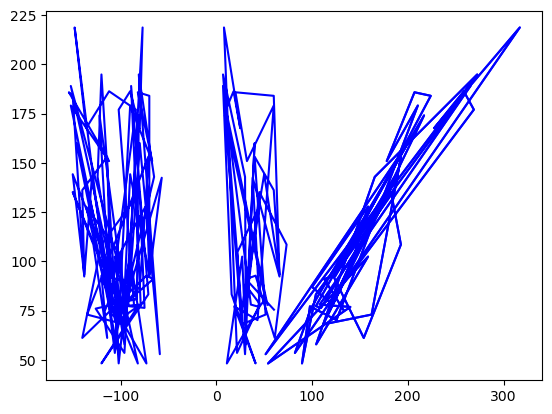

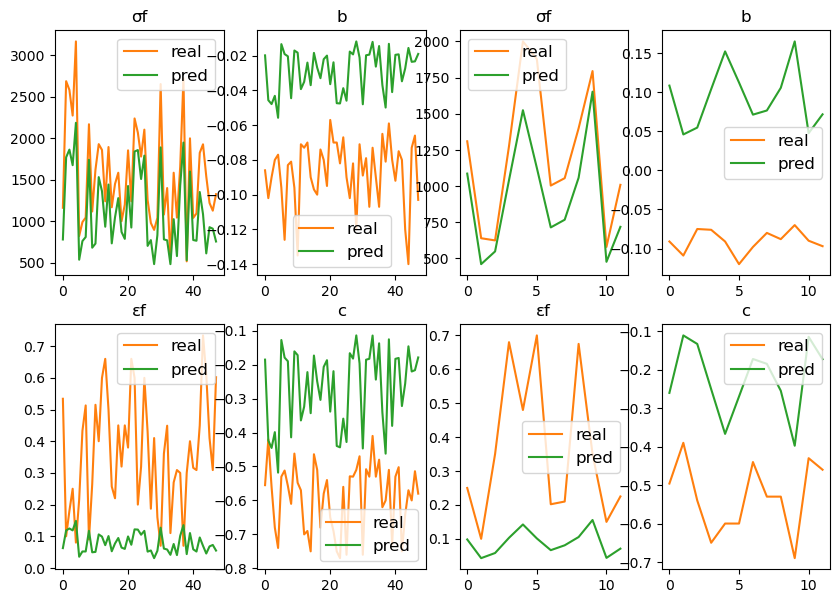

Epoch 31, loss: 2128.92626953125
Train set
[1.255      1.928      1.08       1.04       1.24       1.3260001
 2.105      2.         0.989      1.117      1.4        1.
 0.97800004 1.45       2.585      1.043      1.855      1.86
 0.54       2.69       0.895      1.22       2.07       1.54
 2.17       1.585      0.821      2.24       1.93       2.655
 1.127      1.04       1.825      1.094      2.725      1.78
 0.515      1.044      3.17       1.895      1.585      1.622
 2.275      1.168      1.655      1.162      1.24       1.2       ]
[1.3284423  2.0277174  1.4683871  1.4594607  1.746829   1.4262222
 3.3121908  2.964646   1.4360892  1.2922696  1.4440416  1.6228441
 1.4500449  1.9479023  3.446081   1.1055193  2.6423202  2.529797
 0.91879576 3.276061   0.9214008  1.7270744  3.4318964  1.1740444
 3.2208152  1.9059172  1.022951   3.4073462  2.8376029  3.4995606
 1.710041   1.5664557  2.5081315  1.439136   3.6145837  2.79628
 1.0051572  1.526869   4.053768   2.6738563  2.3804214  1.378297

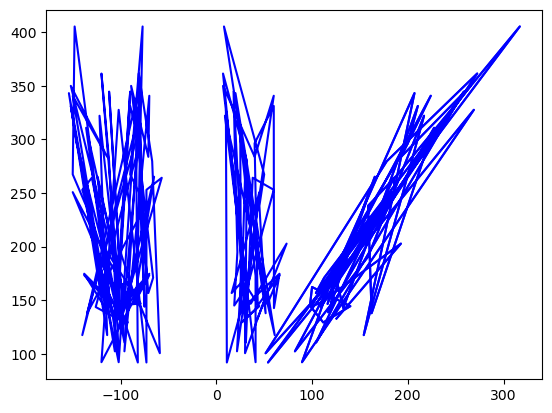

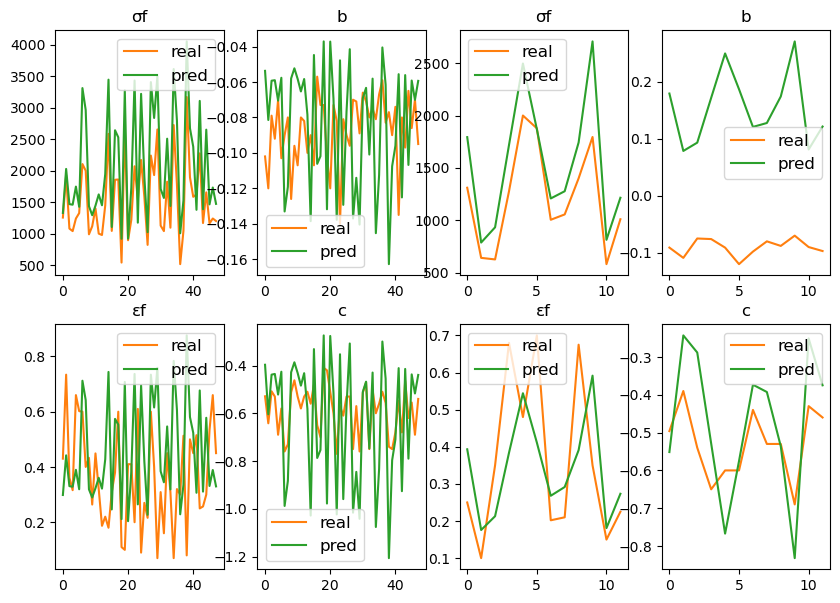

Epoch 41, loss: 982.7040405273438
Train set
[2.17       3.17       1.78       1.855      1.168      0.821
 2.585      1.127      1.22       1.3260001  0.515      1.255
 1.45       1.2        1.08       1.93       1.585      1.094
 1.86       2.24       1.117      1.044      1.         2.275
 1.585      0.54       1.895      0.989      1.04       0.895
 2.69       1.54       1.4        1.043      0.97800004 1.622
 2.         1.928      1.162      2.105      2.725      2.655
 1.24       2.07       1.655      1.825      1.04       1.24      ]
[2.089002   2.6329465  1.8094246  1.7123957  0.94389373 0.7094508
 2.2310276  1.1179672  1.1417909  0.96375895 0.6638161  0.9023753
 1.2590947  0.9780775  0.9787258  1.8366634  1.2326316  0.9736369
 1.6348038  2.202473   0.88173765 1.0336571  1.0758637  2.009235
 1.5373213  0.61249787 1.7294648  0.9734333  0.9754739  0.6412475
 2.1170712  0.8054009  0.96304095 0.75941175 0.97072273 0.9293875
 1.9197824  1.3574334  0.9748018  2.1450622  2.3423848  2.2

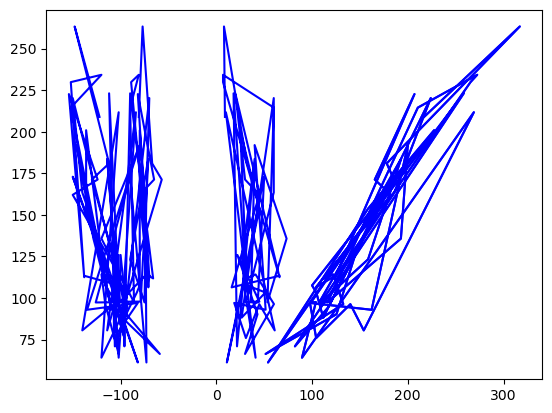

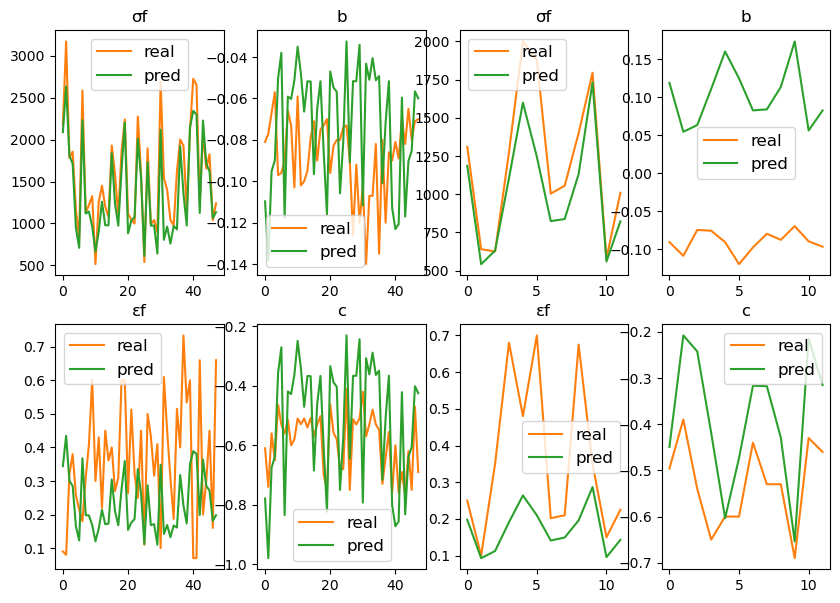

Epoch 51, loss: 867.9171752929688
Train set
[2.275      1.127      1.04       0.54       1.78       2.585
 0.895      1.168      1.162      1.825      1.54       0.97800004
 1.585      1.4        1.93       1.08       1.3260001  0.821
 1.655      1.2        1.585      1.895      1.855      1.044
 1.622      2.655      1.04       1.         1.24       0.515
 2.725      2.105      2.17       1.094      3.17       1.22
 1.24       2.07       0.989      2.24       1.117      1.255
 1.86       2.         2.69       1.043      1.45       1.928     ]
[1.9679327  1.1324663  1.1197478  0.64012635 1.7736093  2.1818173
 0.68771803 0.9953322  1.0028622  1.5889701  0.858571   0.9983151
 1.218152   0.98837584 1.800172   1.0071759  1.011746   0.7599721
 1.6741121  1.0003814  1.5172665  1.6970905  1.6979957  1.0837591
 0.9734901  2.3128676  1.012054   1.0968813  1.12831    0.68831
 2.3262599  2.0971384  2.0519164  1.0229241  2.6346178  1.1610479
 1.1219331  2.177673   1.0240805  2.1526985  0.9320471  

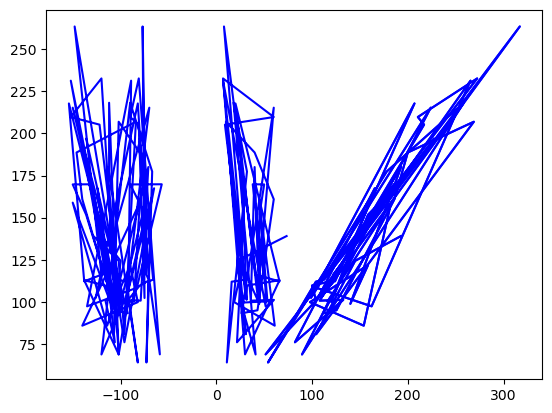

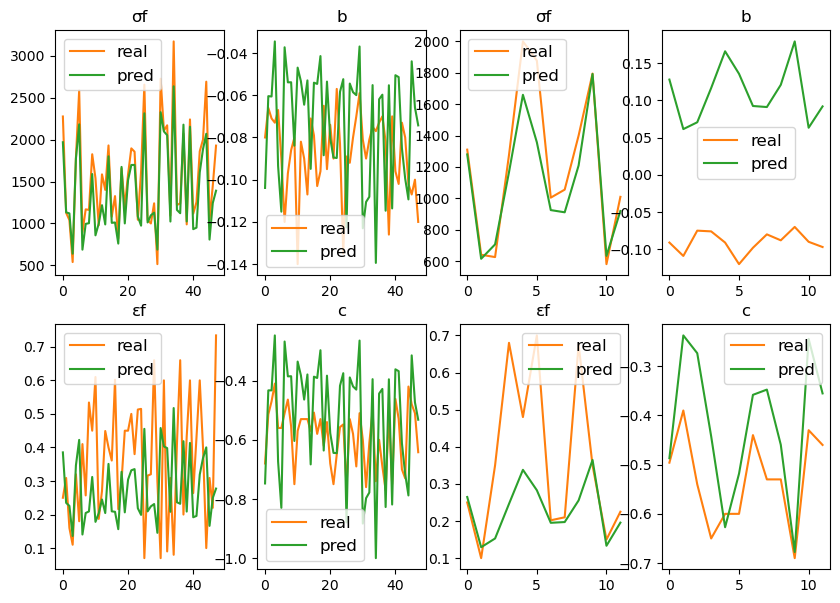

Epoch 61, loss: 776.5807495117188
Train set
[1.127      1.928      1.117      1.855      2.585      1.655
 1.04       1.54       2.69       1.         1.24       2.24
 1.585      1.895      1.93       0.515      0.895      1.044
 2.07       1.24       1.585      1.622      1.3260001  1.043
 1.04       2.655      0.97800004 2.105      3.17       1.255
 1.825      2.725      2.17       1.162      1.2        1.094
 2.275      1.86       0.989      1.168      1.08       1.45
 2.         1.22       0.821      0.54       1.78       1.4       ]
[1.34506    1.6595476  1.1487854  1.9872993  2.4992933  1.92942
 1.235964   1.065844   2.364138   1.3055228  1.3212669  2.4601662
 1.4223174  1.9761962  2.0969558  0.8406121  0.85588837 1.3263017
 2.5062594  1.3283757  1.7691761  1.1921617  1.2409734  1.0001006
 1.3720592  2.7211564  1.2015605  2.4025276  3.0884173  1.1681297
 1.8417039  2.7214403  2.3872092  1.2204468  1.1979536  1.2528424
 2.2846856  1.8731987  1.256342   1.2247711  1.2257352  1.4499

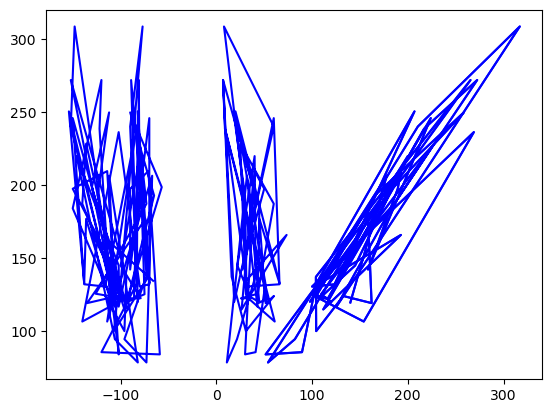

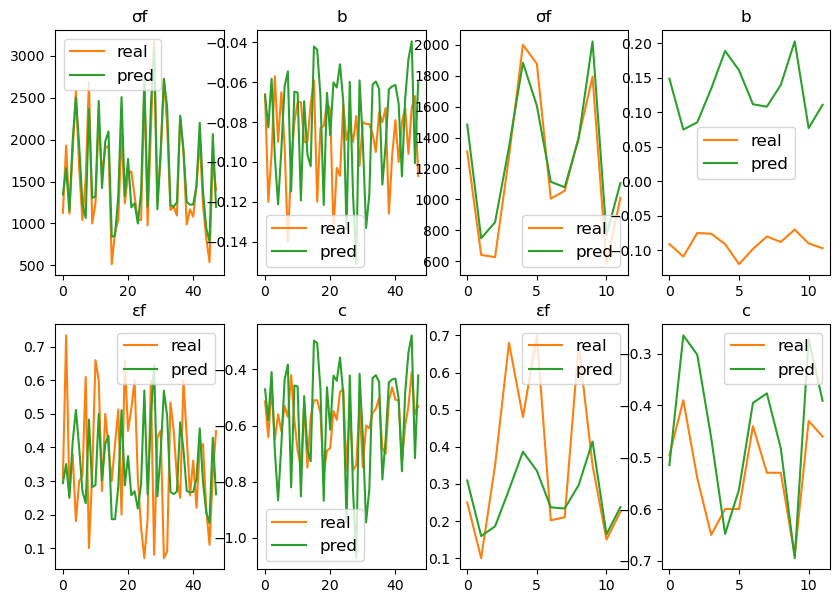

Epoch 71, loss: 682.2999267578125
Train set
[1.255      1.         1.86       1.162      2.585      3.17
 1.24       1.825      0.54       2.17       1.3260001  1.168
 1.24       0.895      1.93       2.725      1.094      0.97800004
 2.         1.585      1.45       1.54       1.043      1.585
 1.4        1.895      2.69       1.08       1.044      0.515
 1.2        1.04       2.655      1.855      1.78       1.655
 1.117      1.928      1.622      0.989      2.275      0.821
 2.24       2.105      1.22       2.07       1.127      1.04      ]
[1.1561501  1.2517657  1.7556999  1.1941704  2.342916   2.894905
 1.2507879  1.7275983  0.776349   2.225081   1.2250918  1.2137192
 1.2479236  0.862632   1.955206   2.5447772  1.2379272  1.1728754
 2.0521014  1.335554   1.3621995  1.0658438  0.99874026 1.6622293
 1.1679806  1.8450049  2.220179   1.199342   1.310511   0.82725316
 1.1646893  1.2132955  2.5601013  1.8595097  1.9257656  1.8109398
 1.1409421  1.5959111  1.1759391  1.2427895  2.1366317

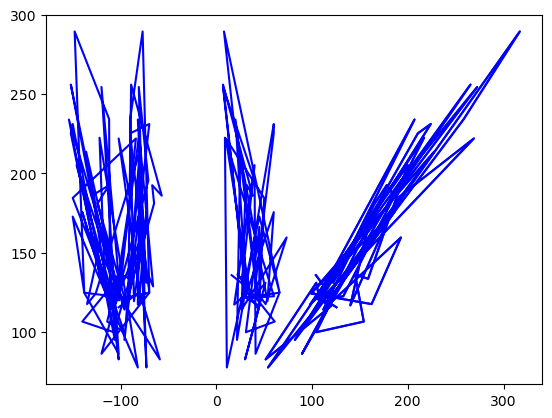

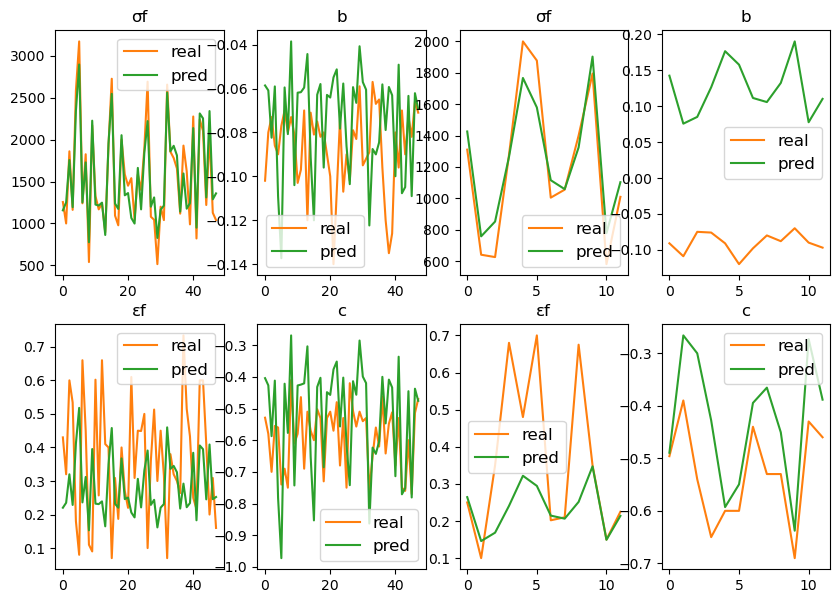

Epoch 81, loss: 615.4359130859375
Train set
[2.105      2.         0.515      1.044      1.928      2.585
 1.22       1.54       1.04       2.24       3.17       0.54
 1.855      1.622      2.07       1.3260001  1.2        1.
 0.895      1.255      1.162      1.24       1.825      1.168
 2.725      1.117      1.043      1.4        1.655      1.585
 1.24       1.78       2.17       1.127      1.04       0.989
 0.97800004 2.69       1.45       0.821      1.86       1.585
 2.655      1.08       1.93       1.895      2.275      1.094     ]
[2.2563376  2.0792518  0.8840072  1.403195   1.6872187  2.3473036
 1.3732231  1.1579841  1.4575725  2.3139343  2.9481382  0.83378303
 1.8894546  1.2587459  2.3453767  1.3137298  1.2308774  1.3181249
 0.94371355 1.2431997  1.2681496  1.281189   1.7502677  1.3062053
 2.585589   1.2309293  1.0831491  1.2383972  1.8295348  1.6893322
 1.2936172  1.9511861  2.2535074  1.3534005  1.2926095  1.3338608
 1.2436405  2.2228353  1.3849742  1.0386949  1.782193   1.358

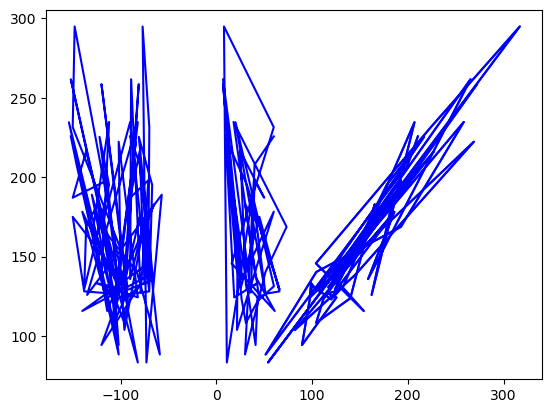

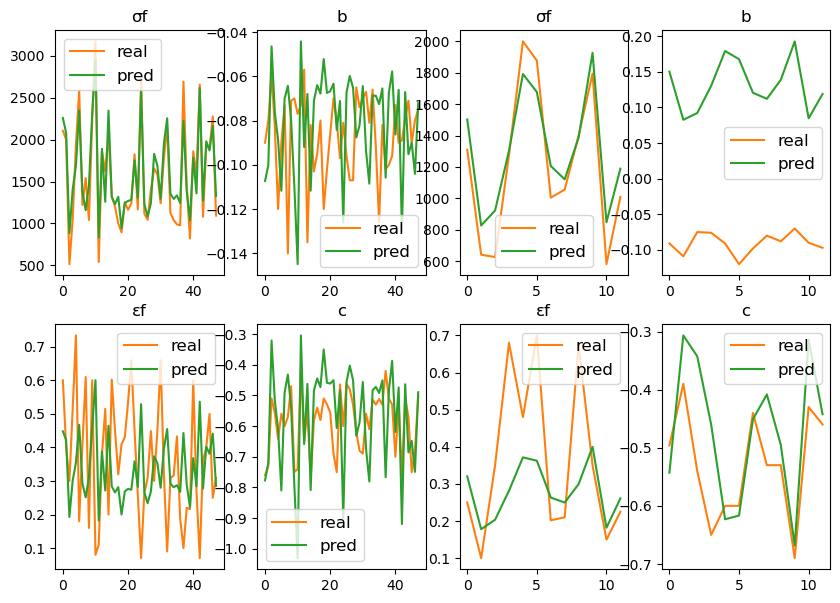

Epoch 91, loss: 562.5877685546875
Train set
[1.043      2.         1.585      2.17       1.08       1.825
 2.07       0.515      1.93       1.78       2.24       2.725
 1.54       2.105      1.3260001  1.2        0.895      1.04
 1.117      1.255      1.4        2.655      0.97800004 0.821
 1.928      2.585      1.094      1.24       2.275      1.655
 1.127      1.168      1.855      0.989      1.622      1.585
 1.22       1.         1.895      0.54       1.04       1.45
 1.24       3.17       1.162      1.044      1.86       2.69      ]
[1.0822415  1.9955666  1.3090466  2.1572006  1.261974   1.6840156
 2.2548704  0.8788157  1.9040954  1.8762947  2.225332   2.4781036
 1.1572362  2.1697757  1.3051361  1.215689   0.94622904 1.4467156
 1.2257591  1.2364534  1.2245673  2.5128934  1.229507   1.0403572
 1.6622512  2.256905   1.3172687  1.2764453  2.080311   1.7592548
 1.3344908  1.2994634  1.8118557  1.325213   1.2496982  1.6276336
 1.3517841  1.2992048  1.7993599  0.8307672  1.2820622  1.33

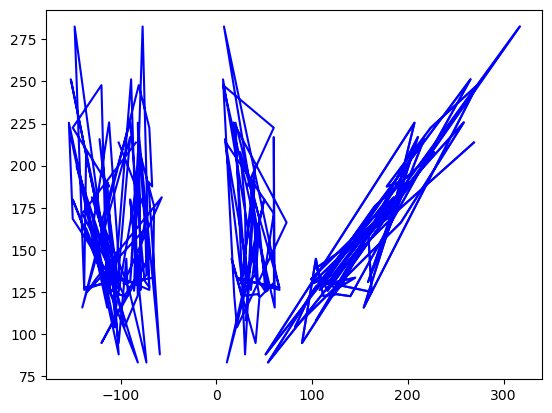

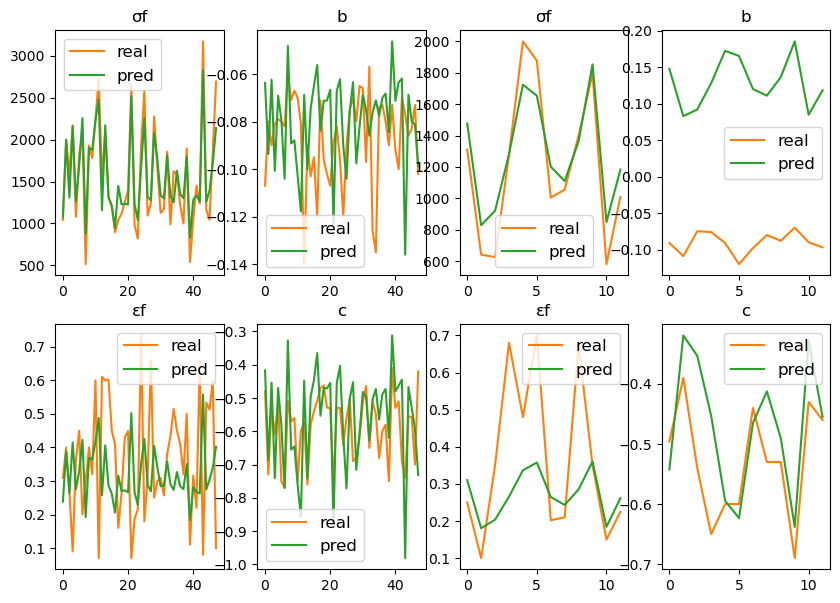

Epoch 101, loss: 505.1282653808594
Train set
[1.86       1.825      3.17       2.69       1.043      1.04
 1.3260001  1.855      2.105      1.094      1.895      0.515
 1.         1.08       1.127      0.54       2.24       1.162
 0.821      2.725      2.17       1.928      1.24       1.168
 2.655      1.04       2.07       0.97800004 1.117      1.2
 1.255      2.275      2.585      1.622      2.         1.78
 1.45       1.655      1.4        0.989      1.24       1.585
 1.93       1.044      1.22       0.895      1.54       1.585     ]
[1.7281747 1.6924776 2.8257494 2.141902  1.0973041 1.4616399 1.3231107
 1.81472   2.1745548 1.3330047 1.8080454 0.8957949 1.318053  1.2836025
 1.3573107 0.8476314 2.230142  1.278867  1.0541058 2.479238  2.1668422
 1.6797833 1.290591  1.316771  2.5258453 1.3027675 2.26016   1.2475759
 1.2430142 1.234981  1.2534118 2.0901003 2.2619743 1.2662485 2.0048144
 1.8851095 1.3577996 1.7678604 1.2448311 1.3415929 1.305262  1.6558872
 1.9129871 1.4076562 1.3724887 

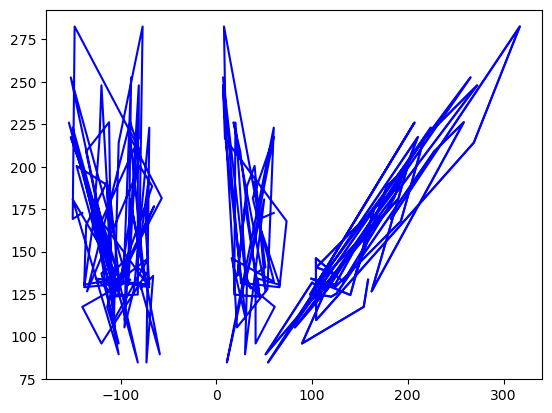

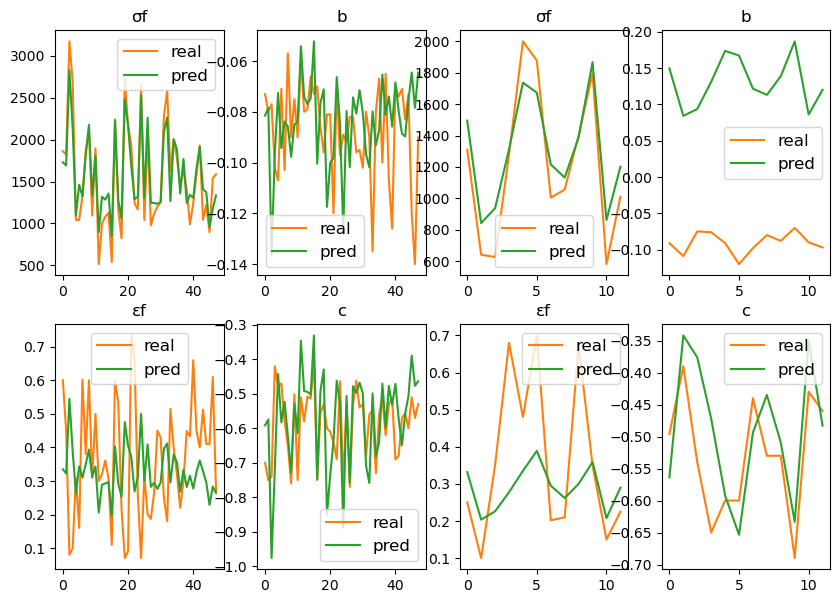

Epoch 111, loss: 449.3336486816406
Train set
[1.4        2.585      2.655      1.93       2.07       1.895
 2.275      2.17       2.725      0.989      1.043      1.24
 1.08       1.24       1.168      1.127      2.105      1.162
 2.69       0.895      1.585      1.3260001  1.04       3.17
 0.54       1.2        1.255      1.86       1.928      1.655
 2.         2.24       1.         1.78       1.855      1.117
 0.97800004 1.54       0.515      1.04       1.044      1.45
 1.22       0.821      1.585      1.622      1.825      1.094     ]
[1.2241449 2.2735915 2.5258737 1.9141495 2.271942  1.815016  2.096253
 2.1678863 2.490733  1.3059967 1.0655423 1.2937486 1.2613783 1.3065426
 1.2828282 1.3483875 2.1861017 1.2578887 2.152881  0.9282986 1.3462894
 1.2902669 1.4195304 2.823855  0.8319233 1.2187294 1.2216231 1.7489123
 1.6488501 1.7686322 2.0077653 2.2413552 1.3030748 1.8875291 1.83327
 1.2098894 1.2258853 1.1410123 0.8806011 1.2775111 1.3696425 1.3707362
 1.3586469 1.0200979 1.6728806 1.

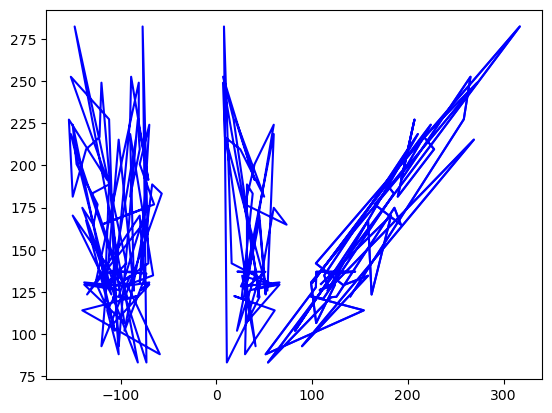

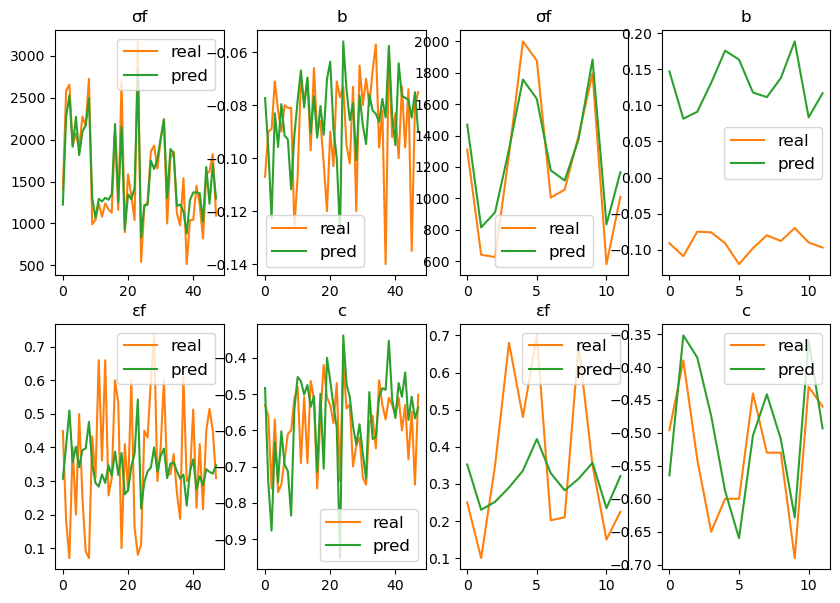

Epoch 121, loss: 400.9508972167969
Train set
[1.2        1.         1.78       1.044      2.725      1.4
 1.04       1.3260001  2.655      0.97800004 2.275      2.69
 1.855      1.825      2.24       1.655      1.93       1.043
 0.821      2.105      1.895      1.117      2.17       1.22
 2.585      1.585      0.989      3.17       1.24       1.08
 1.54       1.45       0.515      1.168      1.622      0.54
 1.162      2.         1.127      1.04       2.07       1.86
 0.895      1.094      1.585      1.24       1.255      1.928     ]
[1.2113101  1.3014833  1.927068   1.3370297  2.5370293  1.210854
 1.258207   1.2618357  2.5482533  1.2118572  2.1403131  2.192962
 1.8698479  1.7403405  2.283167   1.8089044  1.9542396  1.0327244
 0.9846441  2.2266333  1.8534471  1.1776634  2.2012703  1.3615744
 2.315045   1.3734219  1.2748287  2.8621168  1.3128546  1.246364
 1.1062376  1.3992512  0.86776704 1.2510107  1.2084186  0.81676763
 1.2437093  2.0488245  1.3522005  1.382481   2.311861   1.7847542


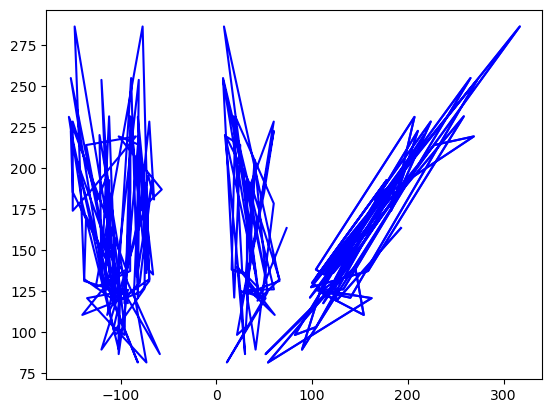

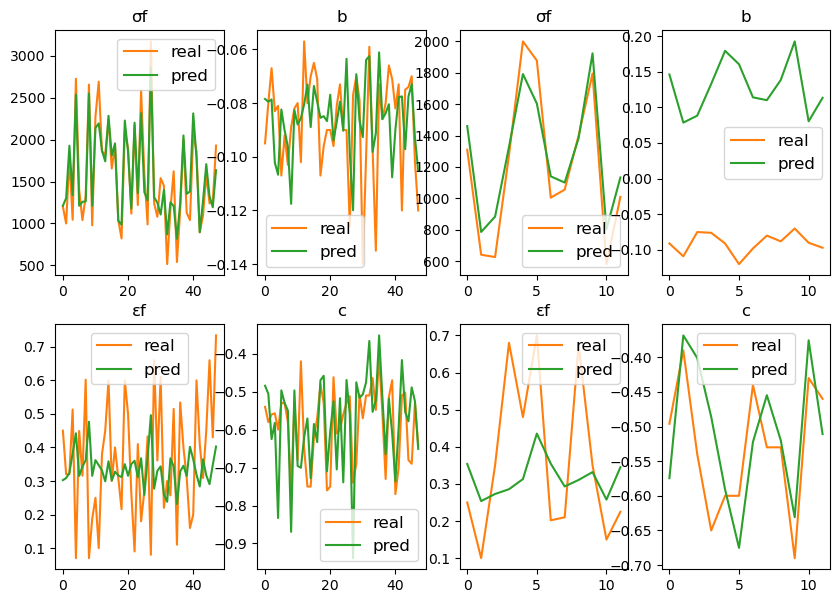

Epoch 131, loss: 374.6733093261719
Train set
[1.043      2.17       1.04       1.044      1.2        1.585
 0.97800004 1.22       1.93       1.162      0.821      1.86
 1.3260001  2.69       2.24       0.54       2.275      0.515
 1.117      1.24       1.127      1.928      1.08       1.
 1.54       2.725      0.989      1.825      0.895      2.07
 1.04       1.655      1.094      1.45       2.585      1.24
 1.255      1.4        3.17       1.895      2.         2.105
 2.655      1.168      1.622      1.855      1.78       1.585     ]
[0.9699987  2.2174866  1.3128372  1.2735279  1.1798291  1.3717121
 1.1751562  1.3370098  1.9664295  1.2047222  0.91586775 1.7906446
 1.2044522  2.2170587  2.3072643  0.7845421  2.1529465  0.836877
 1.1143907  1.3079381  1.3277223  1.5934098  1.2067997  1.2736031
 1.0365018  2.5480385  1.2126126  1.7492459  0.8316468  2.336079
 1.2150973  1.8217734  1.2068363  1.3985562  2.3401186  1.3005441
 1.133892   1.174346   2.8741517  1.863638   2.0610435  2.2499635

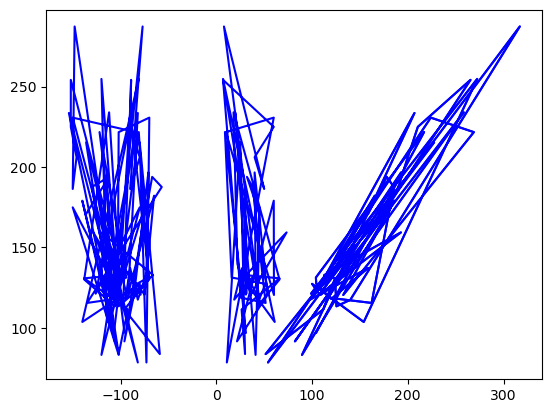

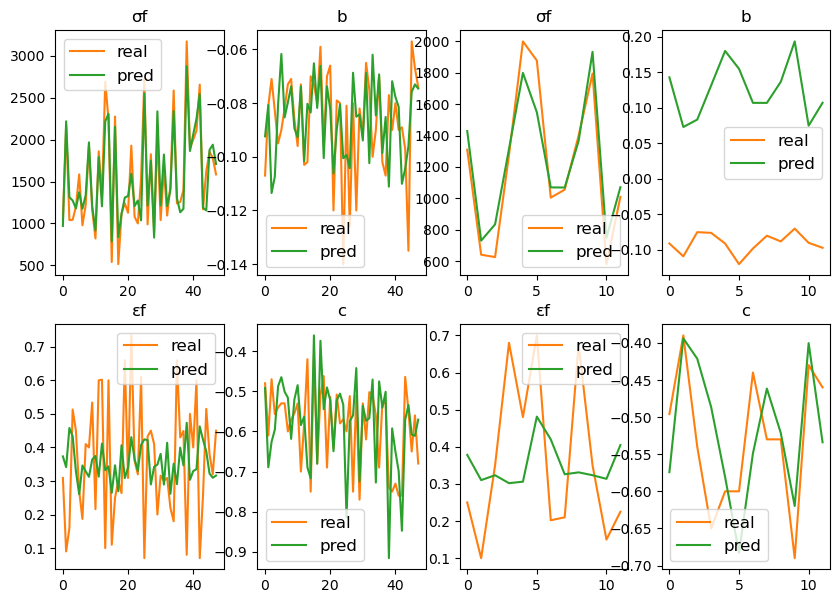

Epoch 141, loss: 363.41717529296875
Train set
[2.105      1.895      1.585      1.255      1.043      2.725
 1.04       1.855      1.168      1.585      0.989      2.17
 1.162      1.78       2.         0.895      1.54       1.655
 0.97800004 1.86       1.45       1.622      0.821      2.69
 1.127      0.515      3.17       1.928      1.3260001  1.094
 1.24       1.24       2.585      1.22       1.117      1.825
 0.54       2.275      1.2        1.04       1.4        2.655
 1.93       2.24       1.         1.08       2.07       1.044     ]
[2.2831275  1.886518   1.7233818  1.1335922  0.9713058  2.5773067
 1.2059488  1.8952146  1.1893388  1.3822436  1.2121826  2.246785
 1.1969703  1.9631417  2.0864818  0.8321914  1.0391221  1.8451362
 1.1684879  1.8112792  1.4097911  1.1504085  0.91702616 2.2495325
 1.3277385  0.8293884  2.9082649  1.5889037  1.2012293  1.2056364
 1.305713   1.3113626  2.374379   1.3371733  1.1152582  1.7707981
 0.77614677 2.1798067  1.1754111  1.3152965  1.1675667  2.5

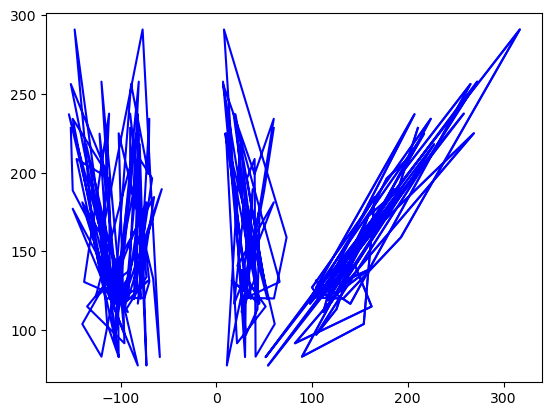

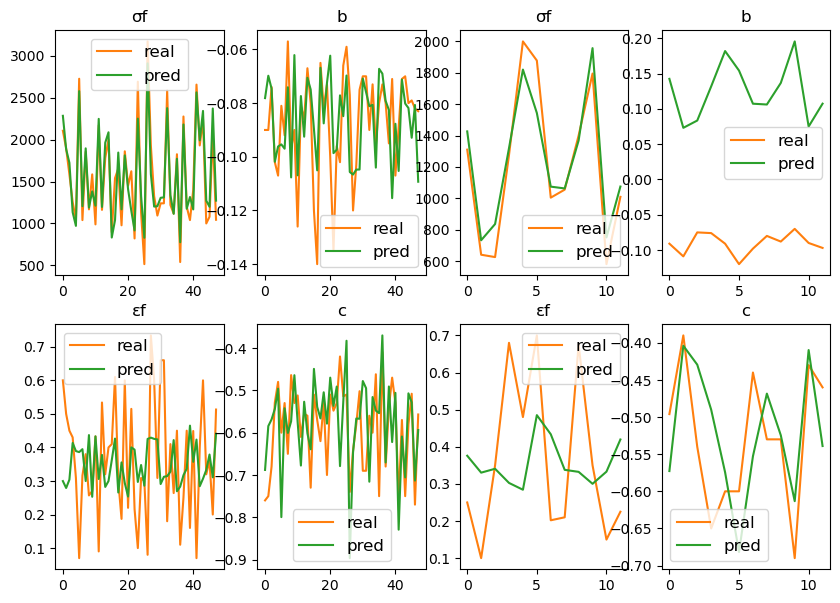

Epoch 151, loss: 354.6786193847656
Train set
[1.93       3.17       1.094      1.3260001  1.24       1.585
 0.895      1.043      2.         1.86       1.08       0.989
 1.855      1.         0.54       1.24       1.895      1.04
 1.127      1.04       1.044      1.54       1.585      1.22
 1.655      1.825      2.655      2.105      2.725      1.4
 1.622      0.821      1.928      2.24       2.585      1.168
 2.275      1.162      1.117      1.78       2.07       0.515
 2.69       1.2        1.45       0.97800004 2.17       1.255     ]
[1.9968424  2.915342   1.1900944  1.1860642  1.3006239  1.3799351
 0.8234877  0.9597316  2.0924335  1.8132682  1.1870233  1.1962583
 1.8967716  1.2629508  0.7656229  1.3049724  1.8916692  1.1938312
 1.3198642  1.2972091  1.2572939  1.0287074  1.7217789  1.3292978
 1.8507092  1.775662   2.5625858  2.2889059  2.583604   1.1564308
 1.1373372  0.90753967 1.5790024  2.3474226  2.3803637  1.1729004
 2.186276   1.1850051  1.0999417  1.9686768  2.3759909  0.819

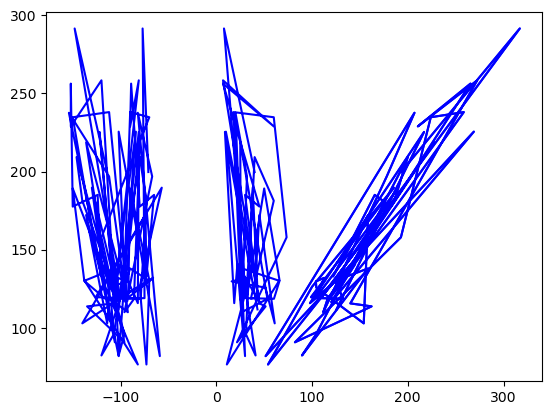

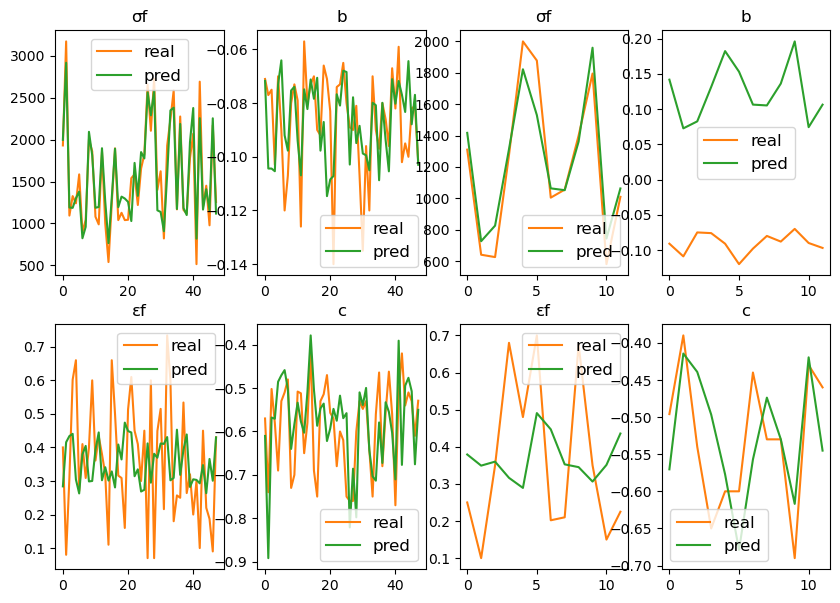

Epoch 161, loss: 345.6860046386719
Train set
[1.04       1.45       1.117      2.105      2.07       1.255
 1.622      1.04       1.24       1.4        1.168      2.725
 1.86       0.895      0.515      1.162      1.08       1.24
 2.275      0.97800004 1.         2.         1.3260001  3.17
 1.54       1.825      1.094      0.821      2.655      1.855
 1.655      2.585      2.24       0.54       0.989      1.928
 1.044      1.585      1.22       1.127      1.93       1.895
 1.043      1.78       2.69       1.2        1.585      2.17      ]
[1.2942538  1.4042182  1.1016989  2.2881303  2.3756957  1.1176394
 1.1349237  1.1898893  1.2967125  1.1523229  1.1735234  2.5863693
 1.8104734  0.8313544  0.814286   1.180028   1.1824306  1.3004842
 2.1891239  1.154392   1.2589356  2.0948198  1.1834527  2.9178019
 1.0368477  1.7753384  1.1873498  0.91566855 2.5645852  1.8956807
 1.8532106  2.3788521  2.3465073  0.76466185 1.1939236  1.5775287
 1.255762   1.7183229  1.3254181  1.3156582  1.9991432  1.8

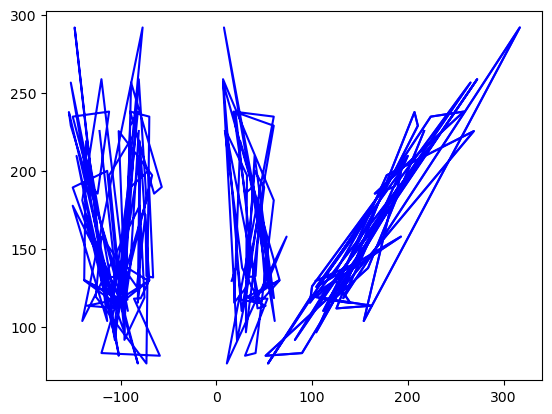

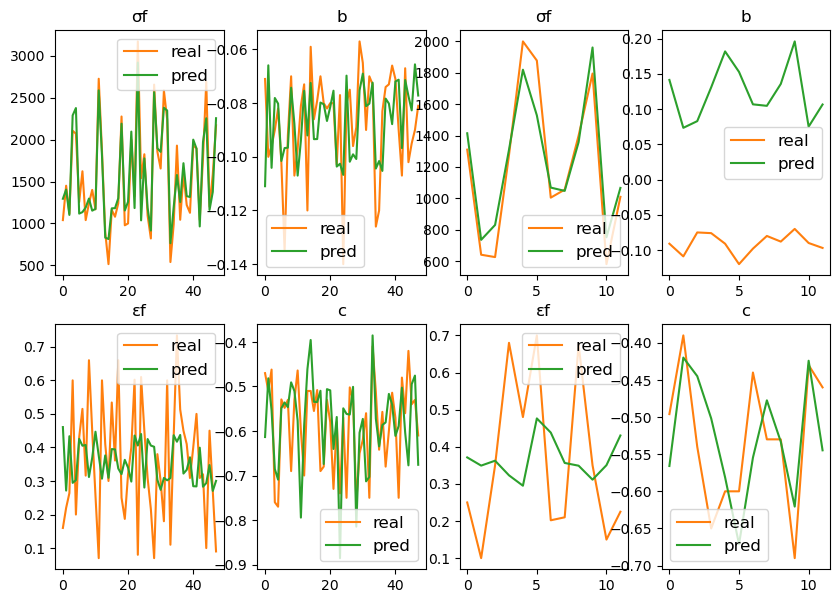

Epoch 171, loss: 337.2036437988281
Train set
[1.928      1.3260001  1.54       0.97800004 1.2        1.162
 1.255      1.168      1.78       1.04       1.117      0.515
 1.4        1.655      0.821      0.895      1.08       1.24
 2.725      1.45       2.585      1.93       0.989      1.895
 1.044      1.825      1.585      1.86       1.24       3.17
 1.         1.22       2.69       1.855      1.622      2.
 1.127      0.54       2.24       1.043      2.275      2.105
 1.04       2.655      2.07       2.17       1.094      1.585     ]
[1.5772308  1.1807915  1.0458462  1.1511973  1.1565515  1.1739637
 1.1170478  1.1738005  1.9710561  1.2928461  1.1033806  0.80877215
 1.147799   1.8532971  0.9246099  0.84004474 1.1769931  1.2936351
 2.5867517  1.3982468  2.3792949  1.9997742  1.1909428  1.8897072
 1.2549115  1.7697846  1.3707408  1.8046855  1.2905823  2.919936
 1.2543949  1.3209839  2.2551832  1.8924769  1.1325619  2.095246
 1.3093467  0.7637299  2.3477335  0.96961665 2.1904845  2.28821

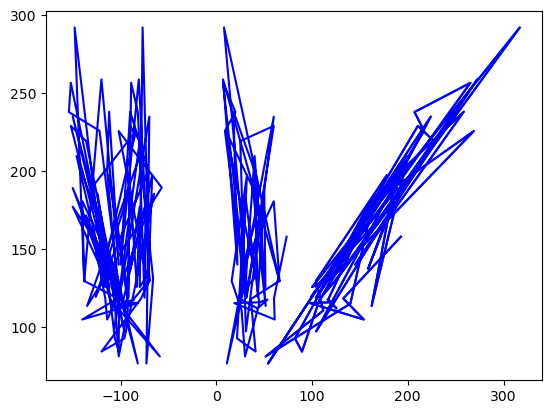

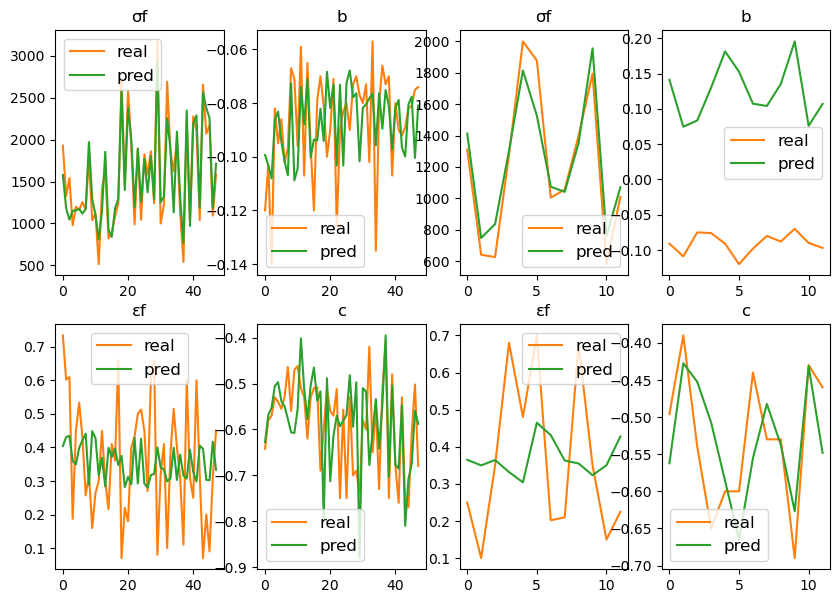

Epoch 181, loss: 329.0043029785156
Train set
[0.97800004 1.         2.         1.168      1.24       0.821
 1.08       1.044      2.655      1.04       1.4        1.86
 1.24       1.622      1.825      2.725      1.043      2.69
 1.04       0.515      1.585      3.17       1.928      1.895
 1.22       2.105      0.895      1.094      0.989      1.45
 2.585      1.54       1.162      1.255      2.275      2.07
 2.24       1.585      0.54       1.78       1.93       2.17
 1.127      1.2        1.117      1.855      1.655      1.3260001 ]
[1.1478727  1.2499552  2.0933344  1.1778315  1.2855994  0.9367469
 1.1707981  1.2537928  2.5691214  1.2913766  1.1430151  1.7992786
 1.2836866  1.1294458  1.7639456  2.5884087  0.97794694 2.2599409
 1.1806805  0.8063591  1.3646708  2.9251053  1.578369   1.8857617
 1.3169323  2.289957   0.8513838  1.1827753  1.1916566  1.3920065
 2.3853967  1.0586412  1.1670651  1.1199415  2.1865258  2.3810883
 2.351684   1.7053807  0.76478034 1.968139   1.9974313  2.2604

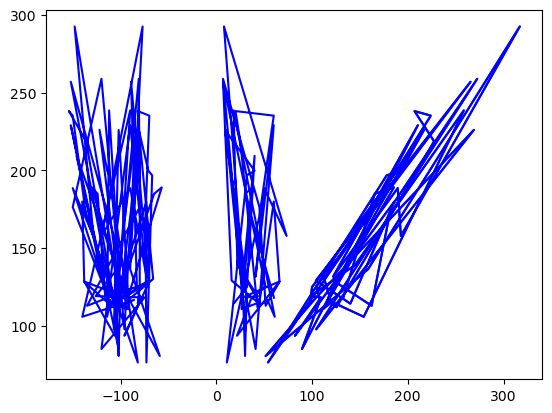

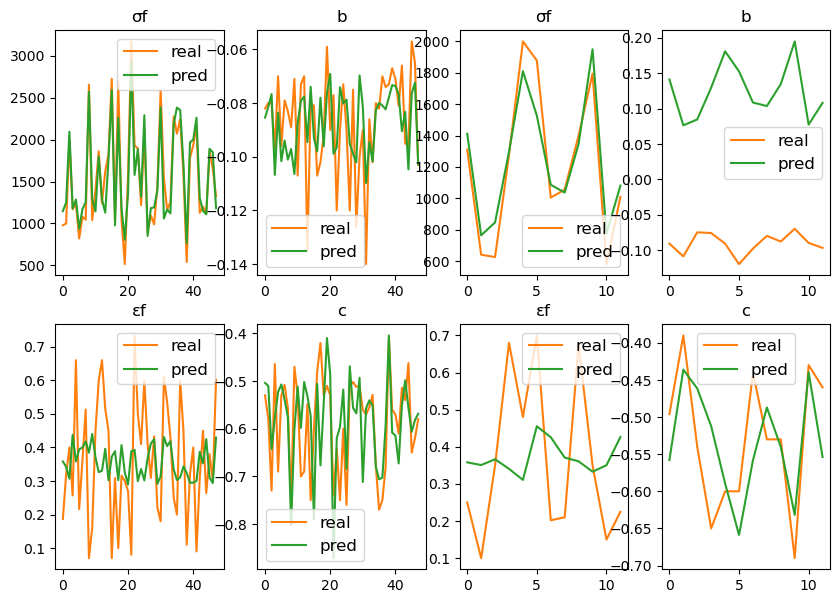

Epoch 191, loss: 322.29052734375
Train set
[1.117      1.22       0.895      2.07       1.78       0.97800004
 1.         0.515      1.928      1.094      0.989      0.821
 1.622      1.585      2.17       1.24       2.         1.895
 3.17       0.54       1.168      2.725      2.105      2.275
 1.162      2.585      1.655      1.2        1.04       1.04
 1.54       1.825      2.24       1.3260001  1.585      2.655
 1.044      1.855      1.45       1.86       1.127      1.93
 1.043      1.08       1.24       1.4        2.69       1.255     ]
[1.1131103  1.3142413  0.8613327  2.3917058  1.9694949  1.1450138
 1.2465599  0.80272746 1.5821326  1.1819282  1.1922901  0.9478452
 1.1261053  1.360162   2.2691946  1.2778387  2.0960584  1.8855177
 2.9369478  0.76483536 1.1814091  2.596863   2.2969892  2.1871564
 1.1596192  2.3954637  1.8462002  1.1462584  1.2919506  1.1762596
 1.070831   1.7610114  2.3575141  1.1810094  1.7011148  2.5807455
 1.2529736  1.8927976  1.3873726  1.7968271  1.2942843  

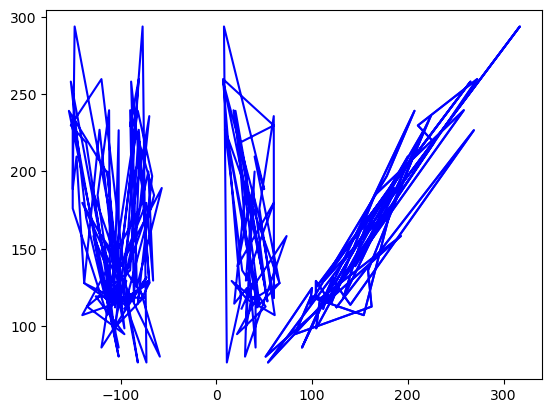

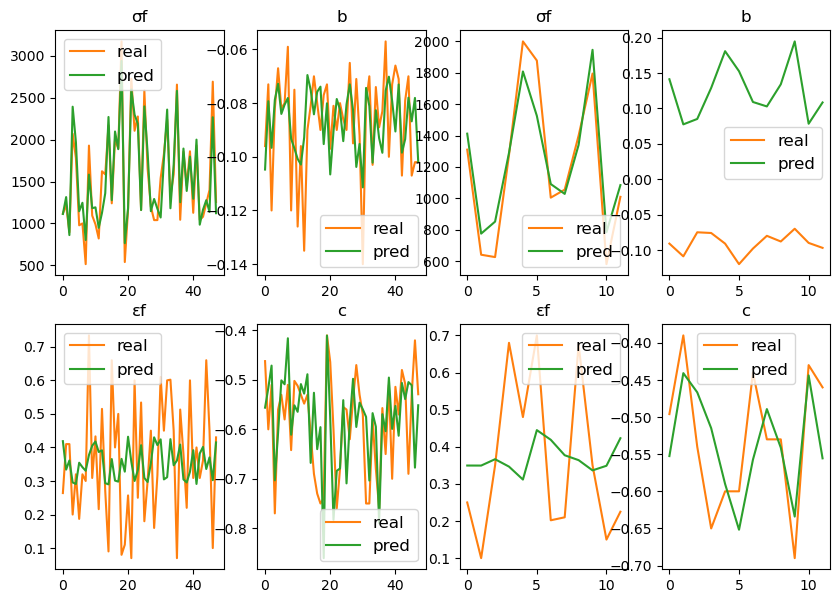

Epoch 201, loss: 316.6103515625
Train set
[1.04       1.117      1.4        1.655      1.45       1.585
 1.2        0.97800004 1.78       2.07       0.515      2.17
 0.821      2.585      1.855      1.3260001  2.655      1.24
 1.162      1.928      1.86       0.895      2.725      1.08
 1.094      2.         1.825      1.         2.69       1.168
 0.54       1.93       2.105      1.044      0.989      2.24
 3.17       1.22       1.04       1.24       1.127      1.895
 1.043      1.585      2.275      1.622      1.255      1.54      ]
[1.2906269  1.1141721  1.134059   1.845991   1.3845248  1.6991109
 1.1429638  1.1434819  1.973914   2.3975904  0.7959423  2.2769372
 0.95574677 2.3987222  1.8979073  1.1773636  2.5969164  1.2728409
 1.1535563  1.5883044  1.7969278  0.8681884  2.6097724  1.1587439
 1.1788751  2.1020935  1.7605329  1.2451364  2.2671738  1.1816196
 0.7618149  2.0038767  2.2985172  1.2536584  1.1895694  2.3585083
 2.955232   1.3134596  1.1706551  1.2713761  1.2881303  1.888065

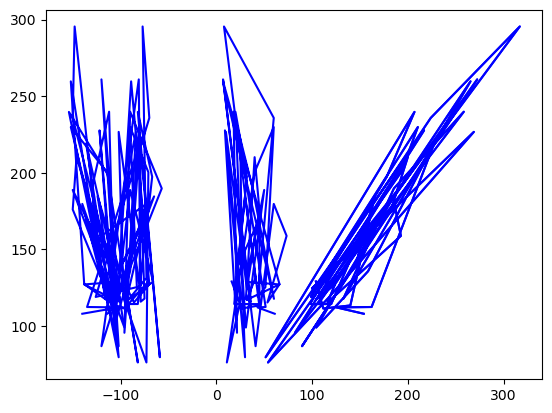

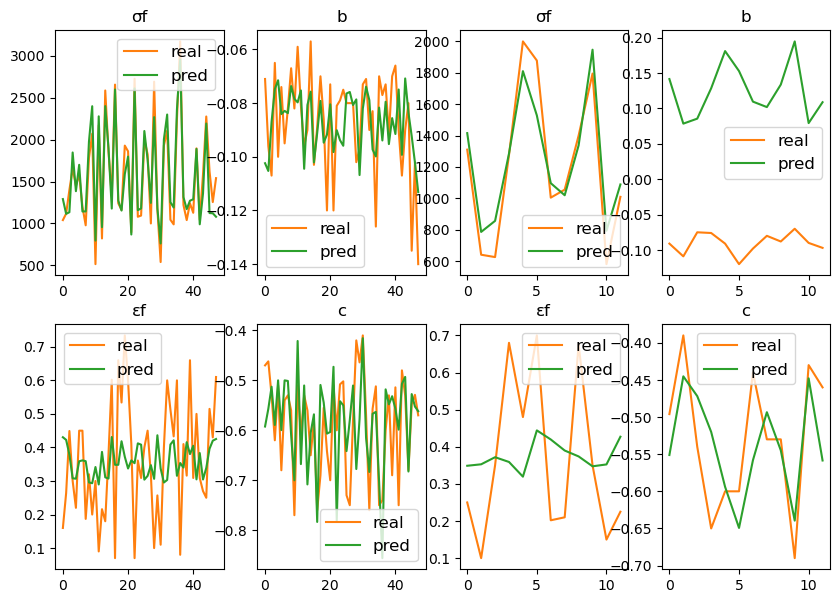

Epoch 211, loss: 311.5760803222656
Train set
[0.895      1.24       1.86       2.17       1.         1.3260001
 1.78       3.17       2.725      1.162      1.08       1.127
 1.255      2.585      1.928      2.655      2.105      1.168
 2.07       0.97800004 1.825      1.93       1.45       1.655
 1.24       1.855      1.04       2.24       1.044      1.2
 0.989      1.622      1.585      1.22       1.895      1.043
 0.515      2.         1.117      1.094      1.4        2.275
 1.54       1.585      2.69       1.04       0.821      0.54      ]
[0.8657979  1.2586746  1.790679   2.279679   1.2384195  1.1623577
 1.9723289  2.968096   2.6157818  1.1415712  1.1473888  1.2755936
 1.1092741  2.3956594  1.5883769  2.6061192  2.2946808  1.1705517
 2.3987803  1.1363473  1.7538565  2.0026138  1.376117   1.839503
 1.2623214  1.8971453  1.2853227  2.3537781  1.2480149  1.1343269
 1.1762794  1.1171253  1.6905904  1.3073459  1.8845154  0.98439354
 0.779176   2.1019385  1.1041819  1.1728519  1.1247392 

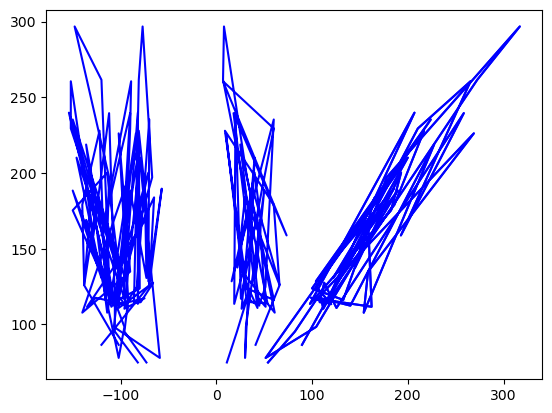

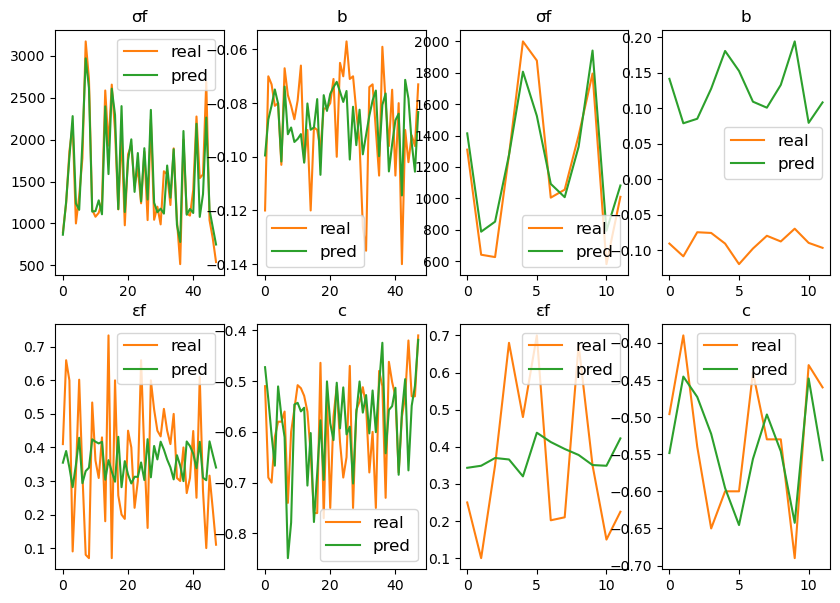

KeyboardInterrupt: 

In [6]:
model = NeuralNetwork()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
loss_func = torch.nn.MSELoss()  # this is for regression mean squared loss

# Train the model
num_epochs = 1000 #100000
losses = []

plt.ion()

for epoch in range(num_epochs):
    for x_batch, y_batch in train_loader:
        # Forward pass
        y_predict = model(x_batch)
        loss = loss_func(y_predict, y_batch)
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        losses.append(loss.item())
        y_test_predict = model(df_x_test)
        
        if epoch % 10 == 0:
            print(f"Epoch {epoch+1}, loss: {loss.item()}")
            print("Train set")
            print(y_batch.data.numpy().squeeze()[:,0]/100)
            print(y_predict.detach().numpy().squeeze()[:,0]/100)
            print("Test set")
            print(df_y_test.data.numpy().squeeze()[:,0]/100)
            print(y_test_predict.detach().numpy().squeeze()[:,0]/100)

            print("Train set")
            print(y_batch.data.numpy().squeeze()[:,2]/100)
            print(y_predict.detach().numpy().squeeze()[:,2]/100)
            print("Test set")
            print(df_y_test.data.numpy().squeeze()[:,2]/100)
            print(y_test_predict.detach().numpy().squeeze()[:,2]/100)
            
            plt.cla()
            plt.plot(y_batch,y_predict.detach().numpy()[:,0],'b-')
              
            fig, axs = plt.subplots(2, 4,figsize =(10,7))
            # Real Values
            axs[0, 0].plot(y_batch.data.numpy().squeeze()[:,0]*10,'tab:orange', label = 'real')
            axs[0, 0].set_title('σf')
            axs[0, 0].legend(fontsize ='large')
            
            axs[0, 1].plot(y_batch.data.numpy().squeeze()[:,1]/1000, 'tab:orange',label = 'real')
            axs[0, 1].set_title('b')
            axs[0, 1].legend(fontsize ='large')
            
            axs[0, 2].plot(df_y_test.data.numpy().squeeze()[:,0]*10, 'tab:orange',label = 'real')
            axs[0, 2].set_title('σf')
            axs[0, 2].legend(fontsize ='large')    
            
            axs[0, 3].plot(df_y_test.data.numpy().squeeze()[:,1]/1000, 'tab:orange',label = 'real')
            axs[0, 3].set_title('b')
            axs[0, 3].legend(fontsize ='large')        

            
            axs[1, 0].plot(y_batch.data.numpy().squeeze()[:,2]/100, 'tab:orange',label = 'real')
            axs[1, 0].set_title('εf')
            axs[1, 0].legend(fontsize ='large')
                        
            axs[1, 1].plot(y_batch.data.numpy().squeeze()[:,3]/200, 'tab:orange',label = 'real')
            axs[1, 1].set_title('c')
            axs[1, 1].legend(fontsize ='large')
            
            axs[1, 2].plot(df_y_test.data.numpy().squeeze()[:,2]/100, 'tab:orange',label = 'real')
            axs[1, 2].set_title('εf')
            axs[1, 2].legend(fontsize ='large')                      
            
            axs[1, 3].plot(df_y_test.detach().numpy().squeeze()[:,3]/200, 'tab:orange',label = 'real')
            axs[1, 3].set_title('c')
            axs[1, 3].legend(fontsize ='large')         
            

            # Predicted Values

            axs[0, 0].plot(y_predict.detach().numpy().squeeze()[:,0]*10,'tab:green',label = 'pred')
            axs[0, 0].set_title('σf')
            axs[0, 0].legend(fontsize ='large')

            axs[0, 1].plot(y_predict.detach().numpy().squeeze()[:,1]/1000,'tab:green',label = 'pred')
            axs[0, 1].set_title('b')
            axs[0, 1].legend(fontsize ='large')

            axs[0, 2].plot(y_test_predict.detach().numpy().squeeze()[:,0]*10,'tab:green',label = 'pred')
            axs[0, 2].set_title('σf')
            axs[0, 2].legend(fontsize ='large')

            axs[0, 3].plot(y_test_predict.detach().numpy().squeeze()[:,0]/1000,'tab:green',label = 'pred')
            axs[0, 3].set_title('b')
            axs[0, 3].legend(fontsize ='large')

            
            axs[1, 0].plot(y_predict.detach().numpy().squeeze()[:,2]/100, 'tab:green',label = 'pred')
            axs[1, 0].set_title('εf')
            axs[1, 0].legend(fontsize ='large')
            
            axs[1, 1].plot(y_predict.detach().numpy().squeeze()[:,3]/200, 'tab:green',label = 'pred')
            axs[1, 1].set_title('c')
            axs[1, 1].legend(fontsize ='large')
                  
            axs[1, 2].plot(y_test_predict.detach().numpy().squeeze()[:,2]/100, 'tab:green',label = 'pred')
            axs[1, 2].set_title('εf')
            axs[1, 2].legend(fontsize ='large')  

            axs[1, 3].plot(y_test_predict.detach().numpy().squeeze()[:,3]/200, 'tab:green',label = 'pred')
            axs[1, 3].set_title('c')
            axs[1, 3].legend(fontsize ='large')
        
            plt.draw();plt.pause(0.05)
                 
plt.ioff()
plt.show()

In [7]:
df_x = pd.read_excel(root2,usecols=[1,2,3,4,5,6,7])
df_y = pd.read_excel(root2,usecols=[0])

df_x_train, df_x_test, df_y_train, df_y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 100)

# Training Set
df_x_train = np.array(df_x_train,dtype = np.float32)
df_y_train = np.array(df_y_train,dtype = np.float32)

df_x_train = torch.from_numpy(df_x_train)   #Create Tensor from numpy array
df_y_train = torch.from_numpy(df_y_train)

# Test Set
df_x_test = np.array(df_x_test,dtype = np.float32)
df_y_test = np.array(df_y_test,dtype = np.float32)

df_x_test = torch.from_numpy(df_x_test)
df_y_test = torch.from_numpy(df_y_test)


# Create PyTorch datasets and dataloaders
train_dataset = TensorDataset(df_x_train, df_y_train)
train_loader = DataLoader(train_dataset, batch_size=Batch_size, shuffle=True)

Epoch 1, loss: 207979.40625
Train set
[3.        7.1111107 6.8444448 5.501     2.69      2.        4.09
 0.9       1.45      1.7       1.3       1.125     3.66      7.577778
 4.06      8.3       5.        2.1       5.111111  5.1      ]
[-0.01559434 -0.03387299 -0.03352831 -0.03789832 -0.02217288 -0.01627863
 -0.031091   -0.01645598 -0.01583    -0.02241517 -0.01574074 -0.01670362
 -0.0271704  -0.03851688 -0.03226072 -0.04299227 -0.02751674 -0.0310379
 -0.0208282  -0.03072843]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[0.00503133 0.00610881 0.00515014 0.00602656 0.00451778]


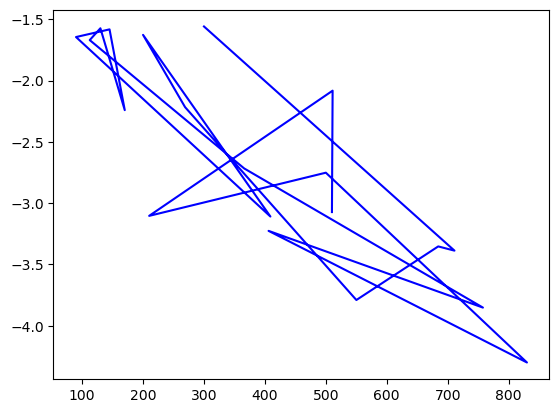

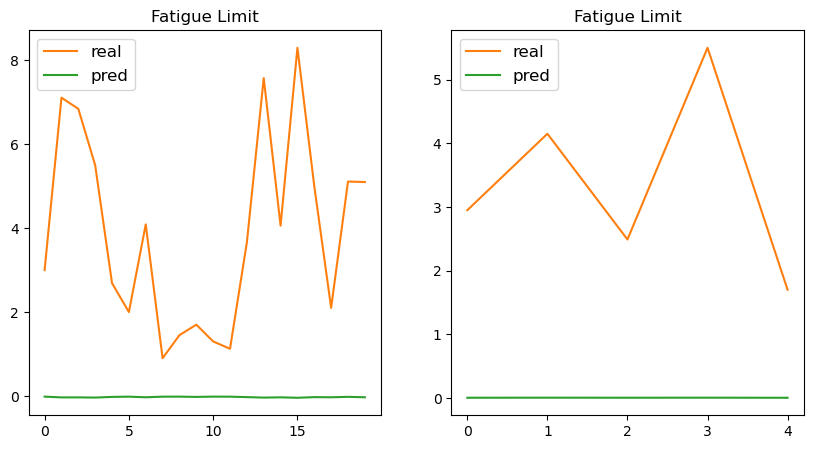

Epoch 11, loss: 179523.53125
Train set
[3.        8.3       4.06      4.09      3.66      5.1       6.8444448
 5.111111  0.9       2.69      2.1       5.501     7.577778  1.7
 1.45      7.1111107 2.        1.125     1.3       5.       ]
[0.17969124 0.46504852 0.35432556 0.3409083  0.3009228  0.34958622
 0.39156586 0.23525883 0.18067919 0.25415635 0.34894165 0.436427
 0.42368248 0.2536372  0.17944732 0.38644508 0.18409015 0.18377447
 0.17818953 0.3161882 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[0.20292802 0.45336542 0.2885955  0.28347266 0.20577118]


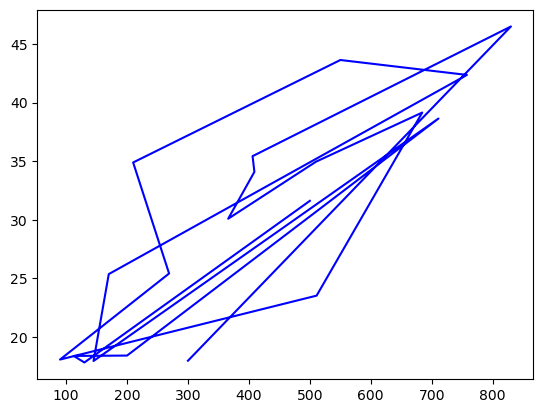

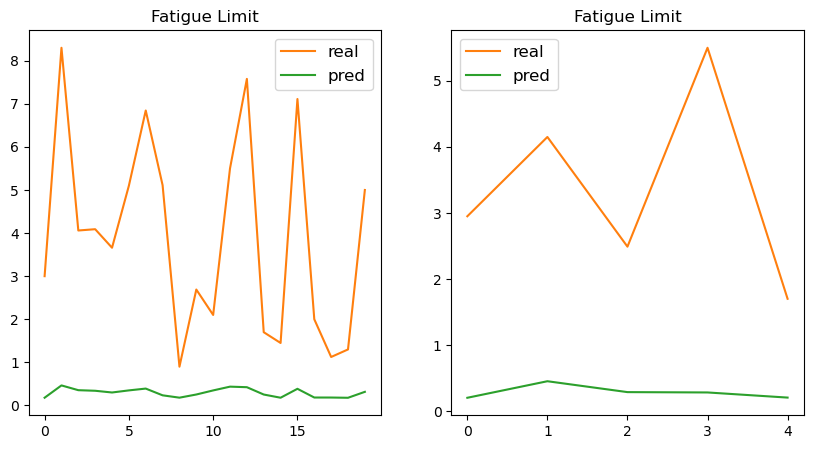

Epoch 21, loss: 132253.09375
Train set
[1.3       4.09      5.501     7.1111107 2.1       5.        5.1
 0.9       8.3       5.111111  4.06      1.125     3.        6.8444448
 1.7       3.66      7.577778  1.45      2.69      2.       ]
[0.55290866 1.033117   1.323951   1.1793802  1.0656666  0.9642641
 1.0663027  0.55917555 1.4181627  0.7213343  1.0784506  0.56474525
 0.5572127  1.1914595  0.7756273  0.91102326 1.2897305  0.5569128
 0.7761213  0.56532687]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[0.6132348  1.3483624  0.85942817 0.8456797  0.62045556]


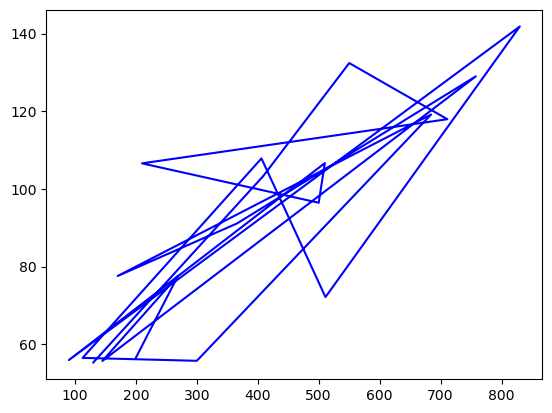

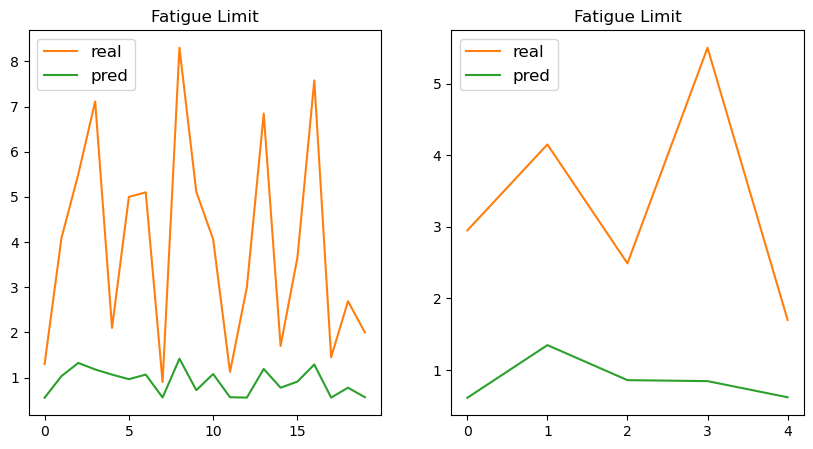

Epoch 31, loss: 48874.8125
Train set
[1.45      1.7       0.9       5.501     8.3       2.1       7.1111107
 2.69      4.09      6.8444448 3.66      1.3       5.        7.577778
 4.06      1.125     5.1       5.111111  3.        2.       ]
[1.5231752 2.1011355 1.5250425 3.5699012 3.848454  2.882669  3.1977177
 2.1026816 2.8070283 3.2280731 2.4759772 1.5124153 2.6186469 3.4692883
 2.923463  1.5339043 2.8843539 1.9661638 1.5241965 1.534488 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[1.6625786 3.6221685 2.3087058 2.2822912 1.6775113]


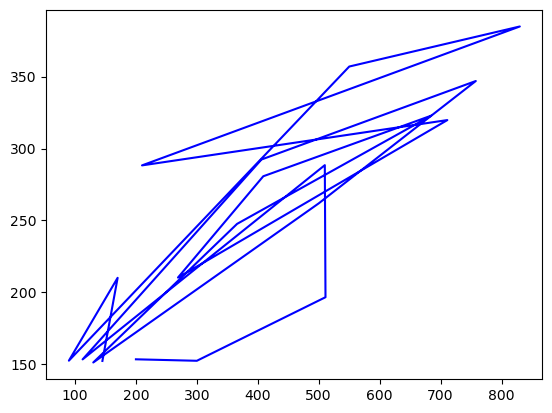

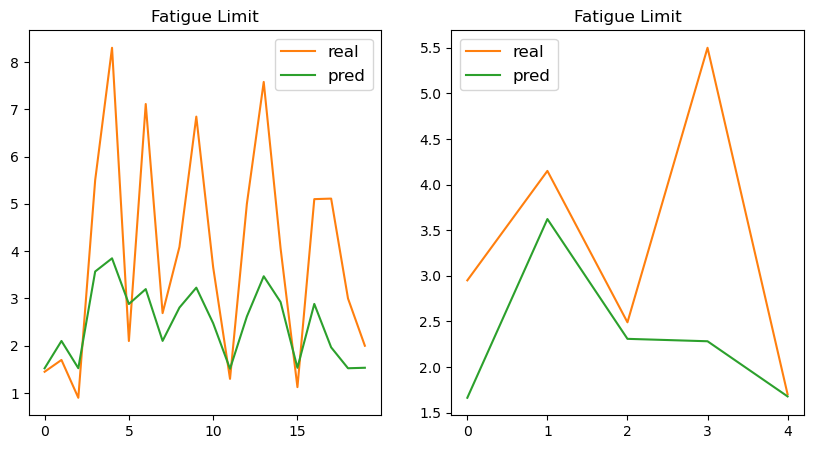

Epoch 41, loss: 27186.26171875
Train set
[0.9       1.125     5.1       5.111111  1.3       7.577778  2.69
 3.        5.        6.8444448 3.66      4.09      1.45      2.
 2.1       8.3       5.501     7.1111107 4.06      1.7      ]
[3.1290936 3.137571  5.8982897 4.022941  3.106445  7.1004457 4.3027635
 3.1303315 5.364327  6.610045  5.0475993 5.7223125 3.128385  3.1411848
 5.894706  7.845597  7.303684  6.5459094 5.9549737 4.299924 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.160173  6.83436   4.374135  4.3174767 3.1854463]


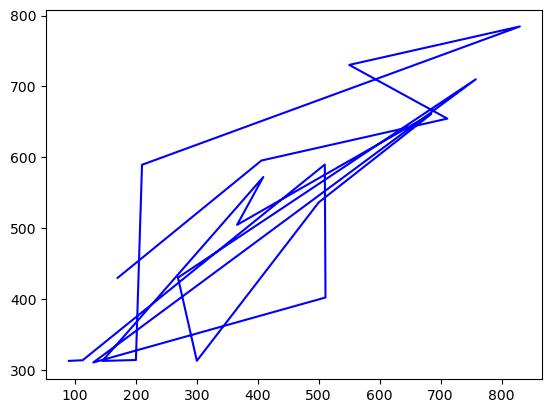

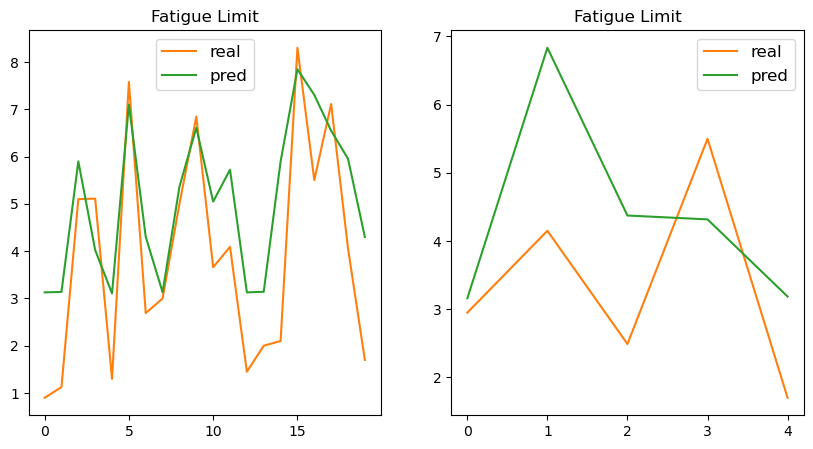

Epoch 51, loss: 18220.61328125
Train set
[2.69      6.8444448 3.66      1.7       1.3       7.1111107 2.
 7.577778  0.9       5.1       8.3       4.06      4.09      5.
 5.111111  5.501     1.45      1.125     2.1       3.       ]
[3.5382094 5.4380293 4.1491    3.533461  2.5478408 5.382861  2.5809076
 5.847372  2.5657861 4.8504033 6.455192  4.9018664 4.703106  4.4112825
 3.3030367 6.012244  2.5660512 2.5748644 4.844408  2.5691693]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4727905 5.3665924 3.4306324 3.3842726 2.4940739]


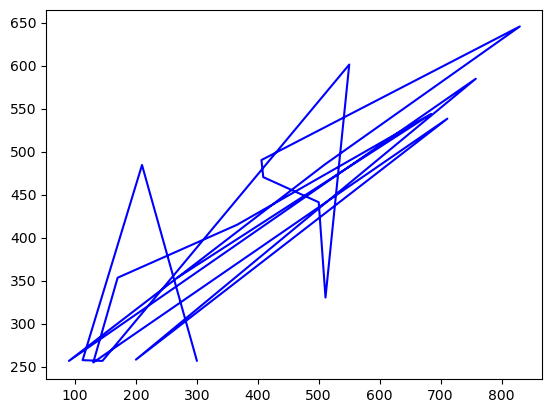

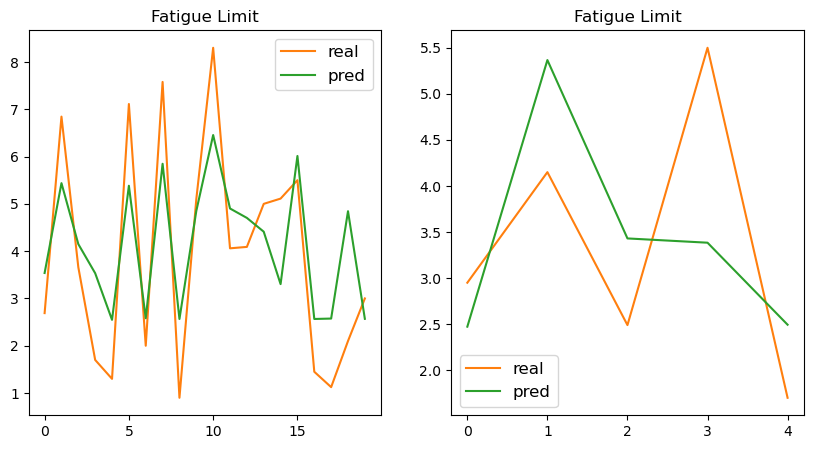

Epoch 61, loss: 19664.22265625
Train set
[1.45      5.1       4.09      3.        7.577778  3.66      2.69
 1.3       6.8444448 2.        8.3       0.9       5.501     1.7
 4.06      2.1       5.111111  1.125     5.        7.1111107]
[2.3278272 4.4088745 4.2677283 2.33202   5.325418  3.7656577 3.2163599
 2.3111868 4.9465194 2.344134  5.8691173 2.326516  5.4717927 3.2099733
 4.4576273 4.4011564 3.0013206 2.3386016 4.0109215 4.8936186]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3463132 5.097359  3.259099  3.2103403 2.3670542]


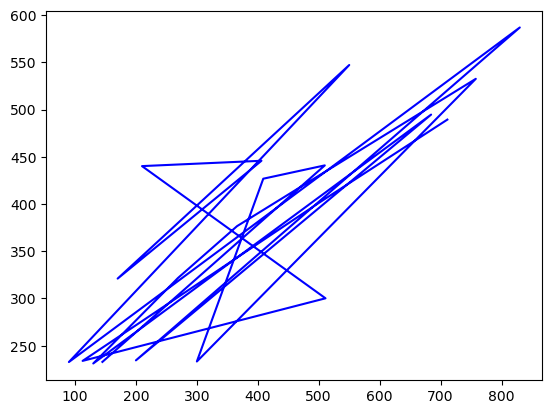

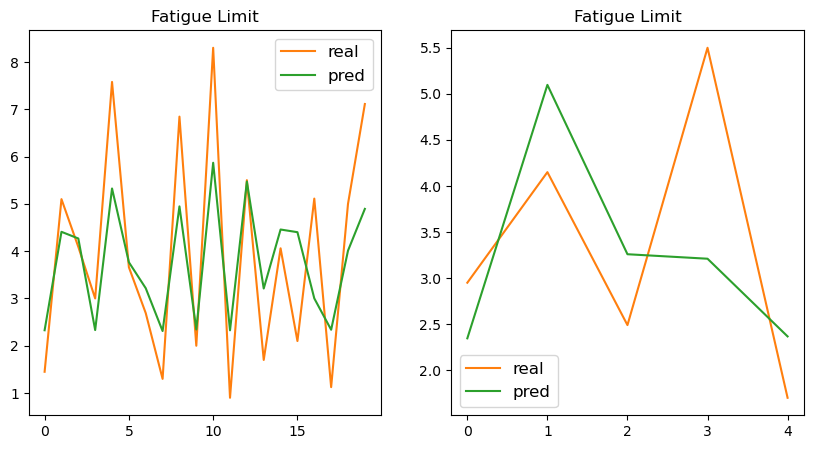

Epoch 71, loss: 18446.892578125
Train set
[2.1       5.1       4.06      2.69      8.3       5.111111  0.9
 5.501     1.3       4.09      1.125     2.        6.8444448 5.
 3.66      1.45      3.        7.577778  1.7       7.1111107]
[5.038004  5.049983  5.1014576 3.684891  6.7169228 3.4353929 2.662352
 6.2721486 2.6468651 4.8783393 2.6747916 2.6846414 5.670024  4.5970173
 4.304949  2.6659853 2.672214  6.1091847 3.675404  5.6072936]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.664876  5.7814264 3.7010827 3.6400702 2.6880958]


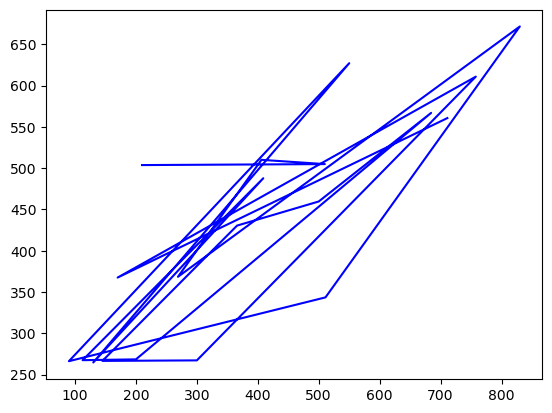

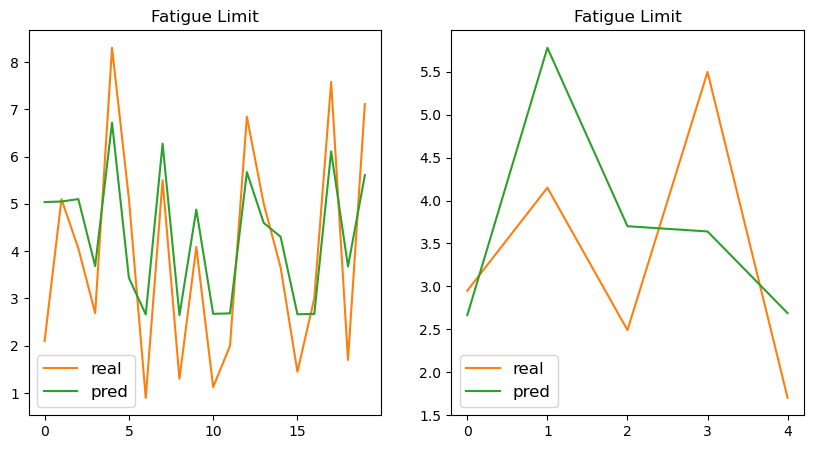

Epoch 81, loss: 18049.33984375
Train set
[5.1       1.125     0.9       3.66      5.111111  6.8444448 1.3
 7.1111107 1.7       8.3       2.69      2.        4.09      5.
 3.        1.45      4.06      2.1       5.501     7.577778 ]
[4.8565373 2.5700104 2.554873  4.131936  3.3015618 5.4584    2.5415773
 5.394348  3.5329    6.4583507 3.5444129 2.5807233 4.6814733 4.423677
 2.5676317 2.5600467 4.90574   4.844132  6.040963  5.8898926]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5308053 5.4937224 3.5190225 3.4541504 2.5532868]


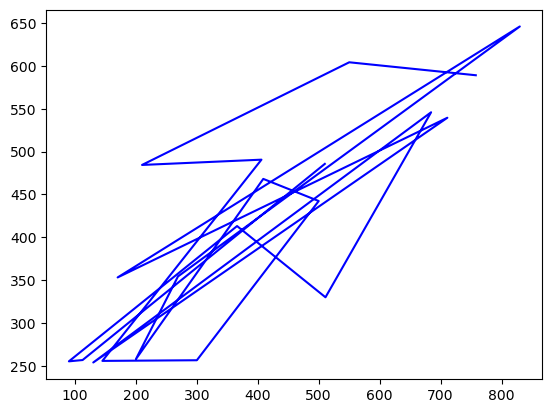

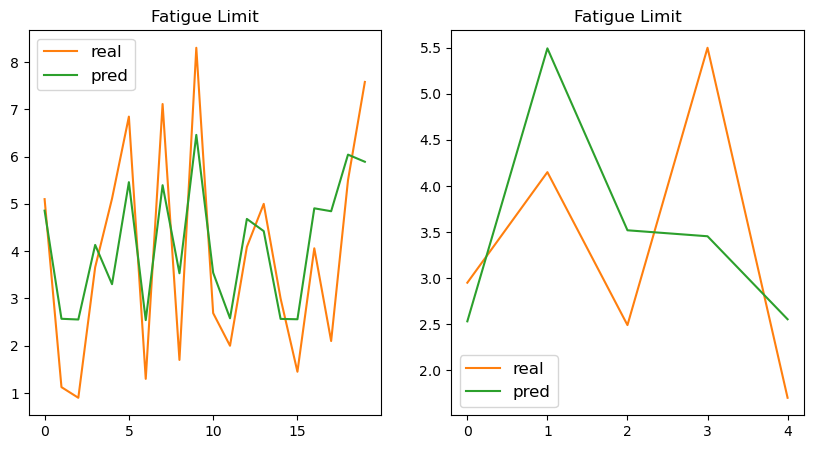

Epoch 91, loss: 18039.4921875
Train set
[2.        0.9       5.        1.45      1.7       5.111111  7.577778
 1.125     3.        4.06      1.3       5.501     5.1       6.8444448
 8.3       2.69      7.1111107 2.1       4.09      3.66     ]
[2.5288863 2.500989  4.3420525 2.5077744 3.4637575 3.2315705 5.7921453
 2.5150437 2.5166993 4.8043237 2.4895267 5.934415  4.763575  5.3597283
 6.324103  3.477336  5.2931576 4.746431  4.5755525 4.0391273]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.507313  5.4354997 3.4894528 3.413669  2.5298471]


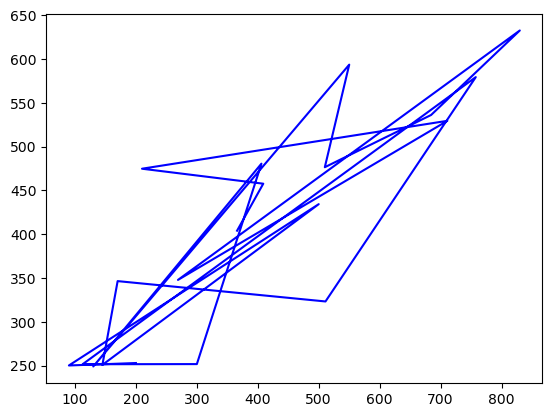

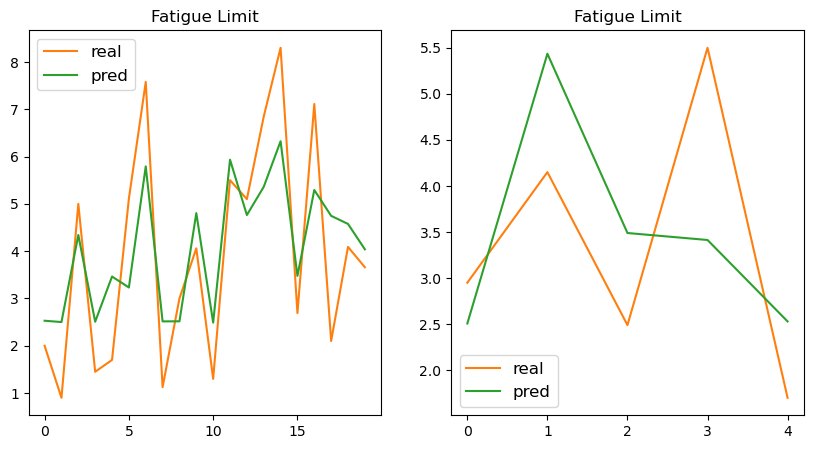

Epoch 101, loss: 17948.400390625
Train set
[5.501     1.125     5.111111  2.69      6.8444448 1.3       5.
 2.1       1.45      2.        5.1       3.        3.66      4.06
 7.1111107 1.7       7.577778  8.3       4.09      0.9      ]
[6.115073  2.583582  3.3206222 3.5790823 5.521018  2.5590932 4.4712825
 4.881261  2.5779905 2.6008594 4.9018044 2.5886707 4.1453567 4.938234
 5.4489813 3.562811  5.9746284 6.4999256 4.695202  2.5691648]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5692313 5.5658193 3.5781868 3.4923513 2.592473 ]


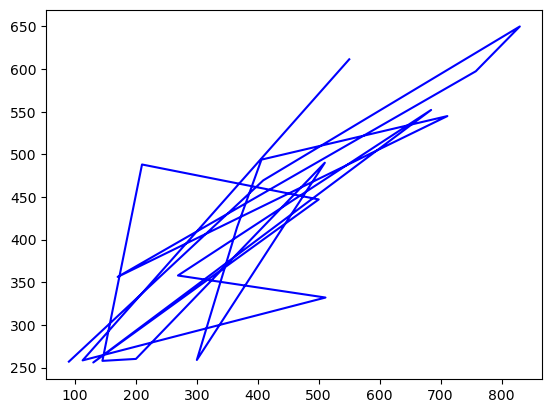

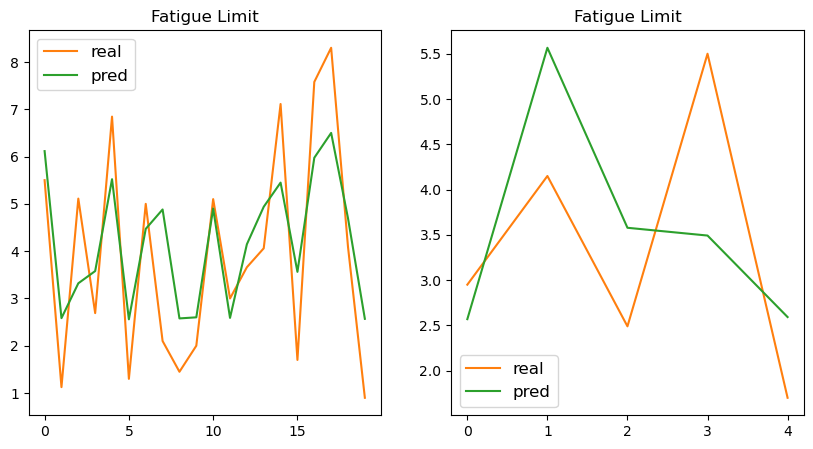

Epoch 111, loss: 17863.724609375
Train set
[1.3       4.09      5.        1.7       2.        2.1       7.1111107
 8.3       1.45      5.111111  7.577778  4.06      6.8444448 0.9
 1.125     5.1       5.501     3.        3.66      2.69     ]
[2.5183892 4.6179433 4.4102435 3.5099368 2.561942  4.809808  5.3728056
 6.405271  2.5371559 3.2708712 5.9051585 4.866864  5.447937  2.5270536
 2.544528  4.831281  6.0371647 2.5492616 4.077846  3.5284007]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.527906  5.4781036 3.5245984 3.4330893 2.5511339]


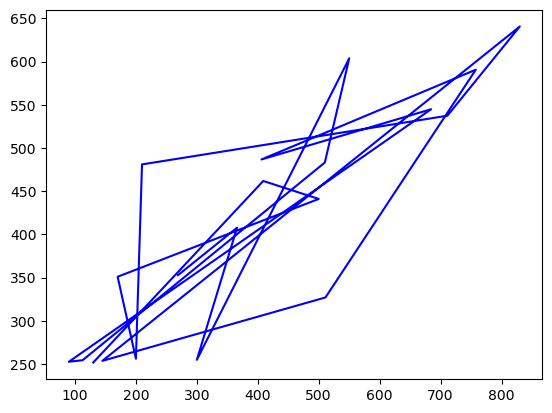

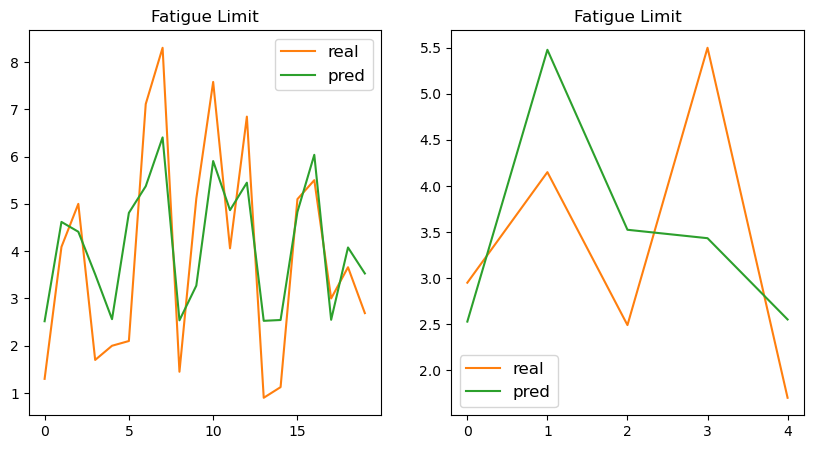

Epoch 121, loss: 17797.84375
Train set
[5.1       0.9       4.09      1.45      5.        3.        8.3
 6.8444448 2.69      7.577778  2.1       5.501     4.06      5.111111
 2.        3.66      1.125     1.7       1.3       7.1111107]
[4.845873  2.5292385 4.614558  2.5415123 4.42698   2.5552046 6.4124584
 5.470757  3.5399148 5.9392743 4.8194838 6.0652103 4.8728    3.2733114
 2.5674806 4.0755363 2.5460083 3.5190148 2.522552  5.391355 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5381842 5.493658  3.5423462 3.4389973 2.5617707]


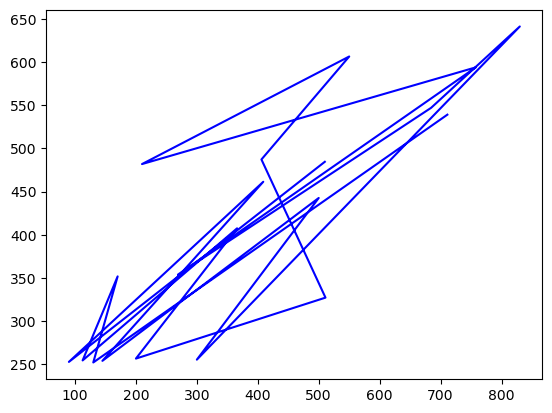

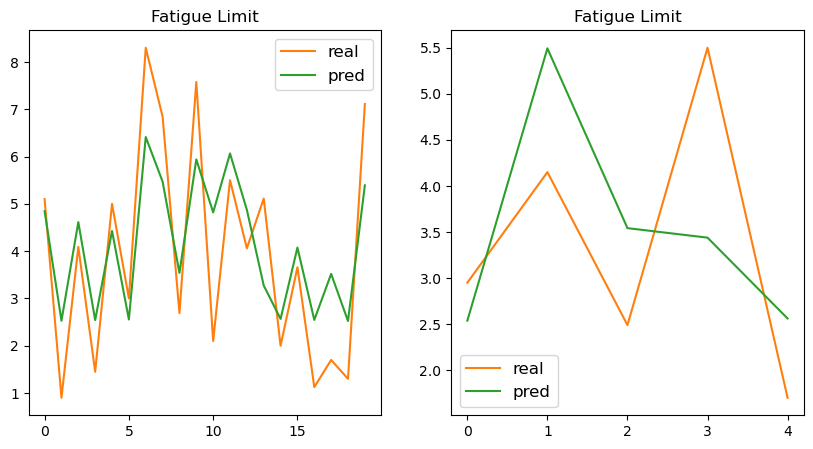

Epoch 131, loss: 17730.74609375
Train set
[5.        4.06      2.69      7.1111107 3.66      2.        0.9
 2.1       1.7       7.577778  5.1       5.501     4.09      8.3
 3.        6.8444448 1.125     5.111111  1.45      1.3      ]
[4.442418  4.88361   3.5503504 5.408292  4.077209  2.5725    2.530796
 4.8295817 3.526913  5.9723024 4.8589907 6.0919256 4.6156745 6.4260535
 2.5600708 5.4921393 2.5500295 3.278987  2.5447204 2.5255673]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5402381 5.497108  3.5490656 3.4371662 2.5641716]


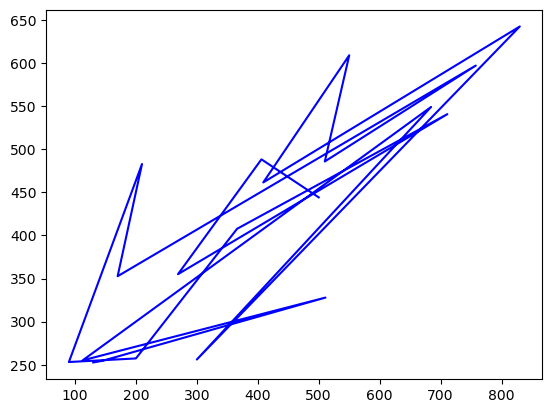

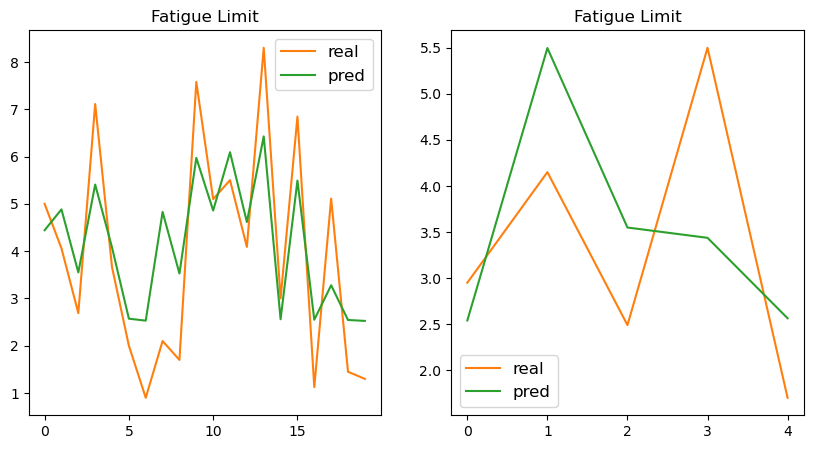

Epoch 141, loss: 17666.263671875
Train set
[2.        6.8444448 4.09      7.577778  4.06      5.        5.501
 5.1       3.66      2.1       0.9       5.111111  8.3       3.
 1.3       2.69      7.1111107 1.45      1.125     1.7      ]
[2.562757  5.482552  4.5879555 5.972142  4.8642597 4.432697  6.084519
 4.8444633 4.053377  4.812197  2.5181715 3.2642462 6.3999066 2.5501778
 2.513973  3.5406067 5.3945284 2.533218  2.5382578 3.5147114]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5312498 5.4760838 3.5406535 3.419822  2.5554667]


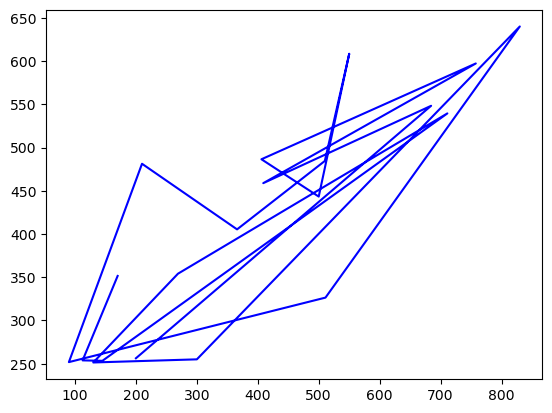

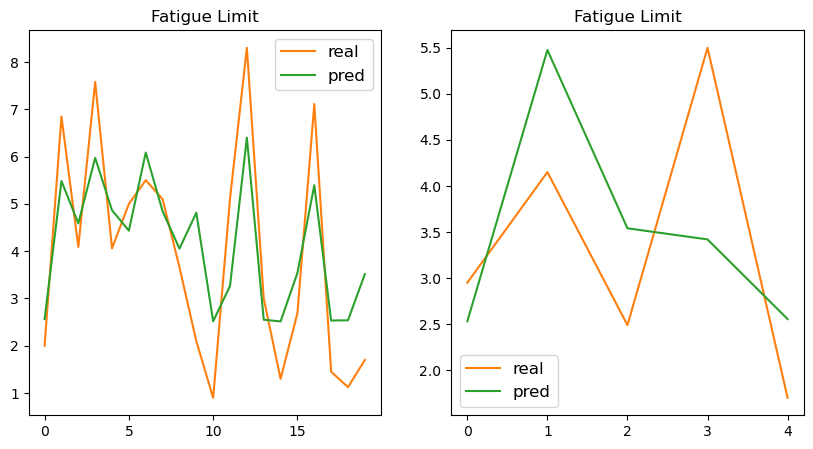

Epoch 151, loss: 17599.90234375
Train set
[3.        5.111111  7.1111107 2.1       4.09      2.        7.577778
 0.9       5.1       2.69      6.8444448 5.501     1.45      1.7
 3.66      1.125     4.06      1.3       5.        8.3      ]
[2.5540593 3.266452  5.409701  4.81986   4.5840297 2.5667493 6.0040984
 2.5186045 4.855867  3.5498376 5.5023975 6.109728  2.5353756 3.5213199
 4.0506673 2.539607  4.8700924 2.515937  4.446783  6.406913 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.534744  5.480672  3.5495472 3.4185452 2.5593398]


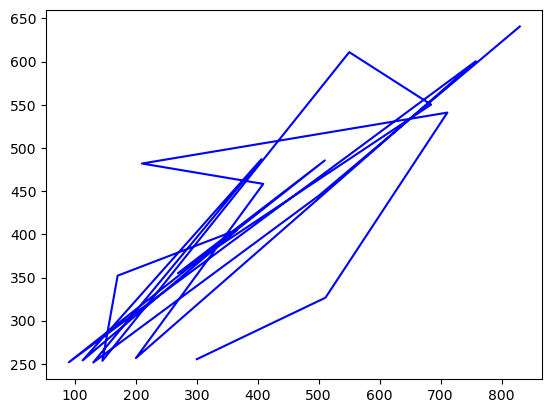

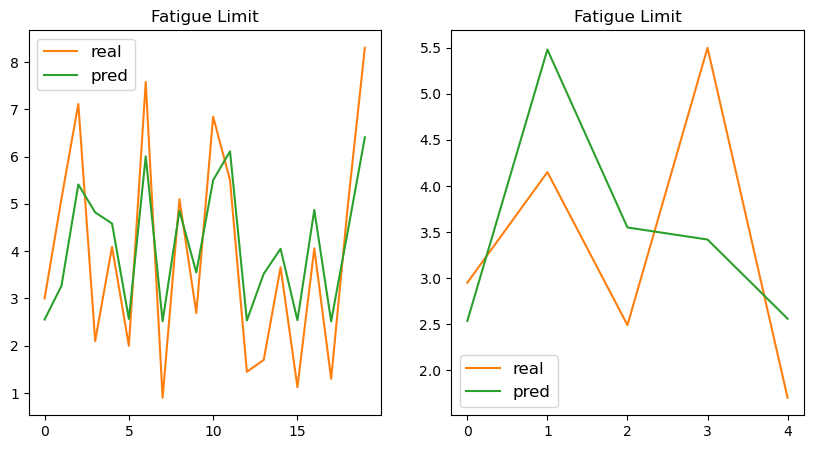

Epoch 161, loss: 17534.40234375
Train set
[8.3       1.45      6.8444448 3.66      2.1       3.        5.111111
 5.501     1.125     2.69      1.7       1.3       5.        5.1
 4.06      2.        0.9       4.09      7.577778  7.1111107]
[6.395575  2.5301378 5.5068035 4.036152  4.8140926 2.5505471 3.259209
 6.1179576 2.5336323 3.548961  3.5178258 2.5105543 4.4483013 4.8534045
 4.8620086 2.5633144 2.5117414 4.566812  6.0196385 5.4095116]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5303957 5.4688134 3.5476534 3.4068182 2.5553226]


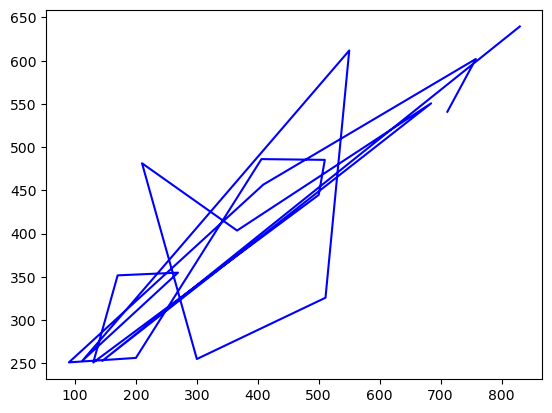

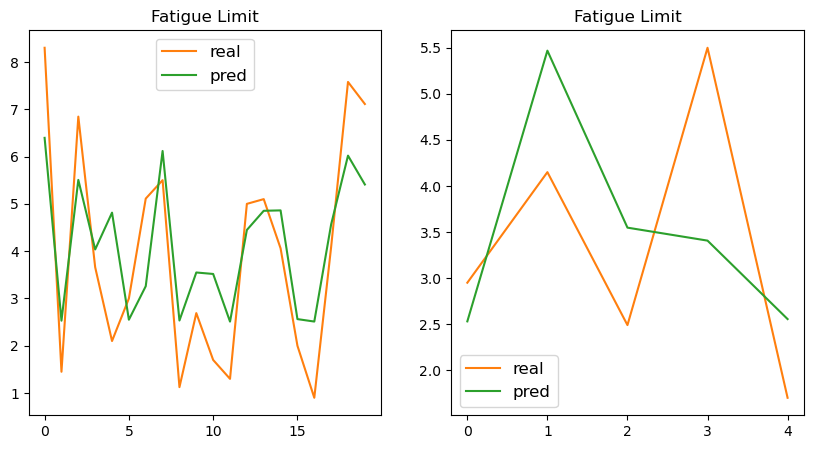

Epoch 171, loss: 17467.50390625
Train set
[6.8444448 1.7       2.1       1.3       3.66      2.        0.9
 7.1111107 5.1       4.06      8.3       7.577778  3.        1.45
 5.        5.111111  4.09      1.125     5.501     2.69     ]
[5.5155354 3.5169234 4.8119183 2.5069451 4.025803  2.5617435 2.5074358
 5.4134583 4.854615  4.8589826 6.390876  6.04018   2.5489013 2.5266917
 4.453248  3.2553198 4.554274  2.5302088 6.1311064 3.55078  ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.529549  5.4645104 3.5507123 3.399761  2.5548594]


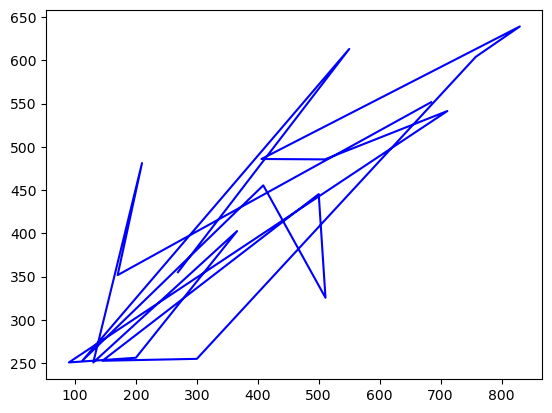

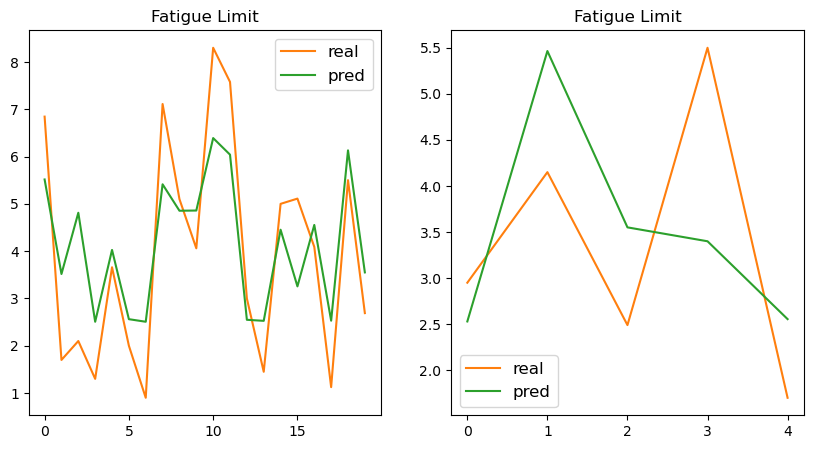

Epoch 181, loss: 17400.474609375
Train set
[4.09      1.45      1.7       2.        5.        4.06      7.1111107
 8.3       7.577778  5.1       3.        0.9       3.66      5.111111
 1.3       6.8444448 2.1       2.69      5.501     1.125    ]
[4.540897  2.5235305 3.5164044 2.5604258 4.4588146 4.855206  5.4181285
 6.3851733 6.0618954 4.8564363 2.5475953 2.5024483 4.014719  3.2508695
 2.503696  5.52511   4.810159  3.5530562 6.145296  2.5261621]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5278633 5.4578395 3.5524743 3.3911278 2.553302 ]


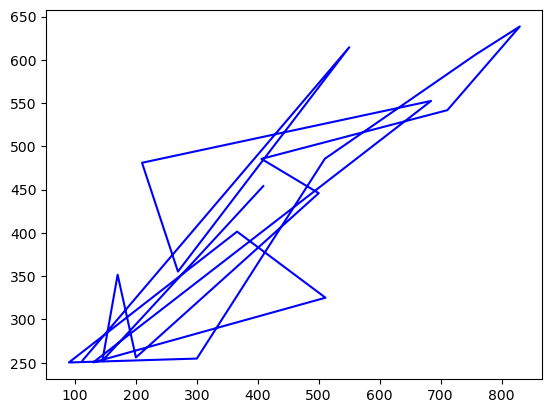

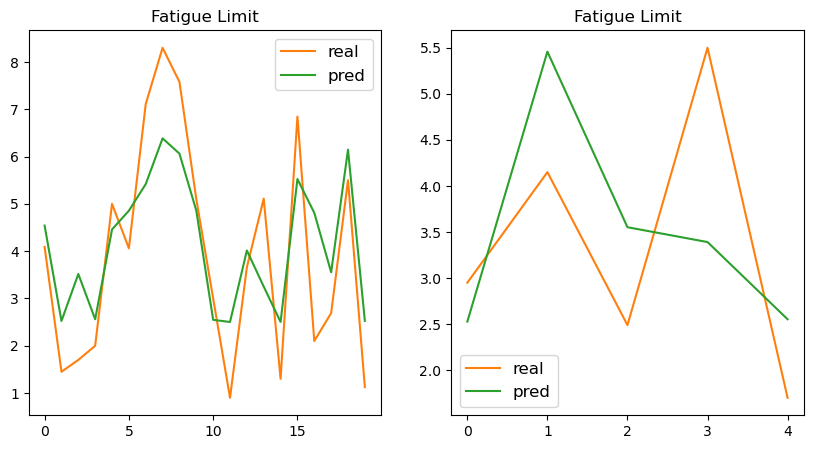

Epoch 191, loss: 17328.2890625
Train set
[0.9       4.06      1.7       5.1       5.501     4.09      5.
 2.69      1.125     7.1111107 5.111111  7.577778  1.3       6.8444448
 2.        3.        1.45      3.66      2.1       8.3      ]
[2.4967532 4.8507214 3.5139663 4.8557487 6.156694  4.527317  4.4621353
 3.5535014 2.5214603 5.4200354 3.2465272 6.0810485 2.498681  5.5320196
 2.5576715 2.5445793 2.5186224 4.0034847 4.8058305 6.379166 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5248847 5.452523  3.553117  3.3831546 2.5507185]


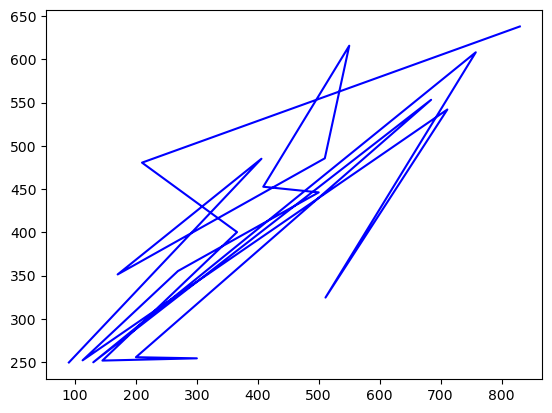

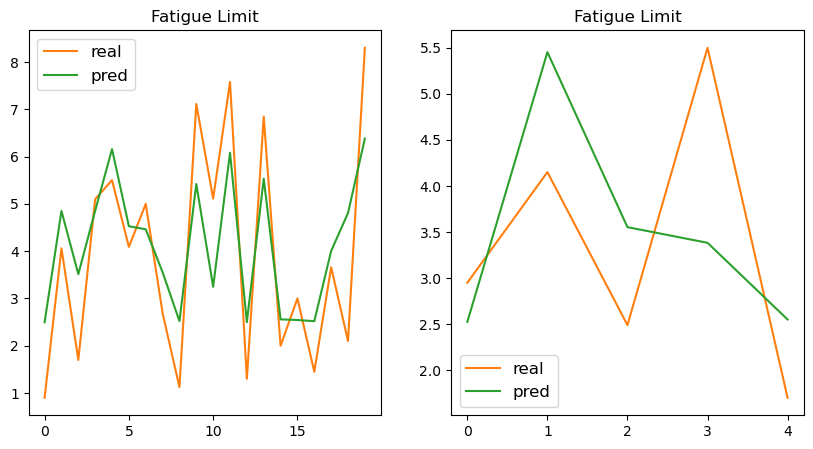

Epoch 201, loss: 17258.60546875
Train set
[5.111111  4.09      7.577778  3.66      1.3       2.        1.125
 8.3       7.1111107 0.9       2.69      1.7       3.        2.1
 5.1       5.        6.8444448 1.45      5.501     4.06     ]
[3.2435389 4.514867  6.103363  3.9933472 2.4944968 2.5559516 2.517667
 6.373799  5.424368  2.4919288 3.5555193 3.5129852 2.542527  4.8039436
 4.8571997 4.4674754 5.5415325 2.5146    6.171126  4.847177 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5222414 5.4479756 3.5544844 3.3755677 2.5485103]


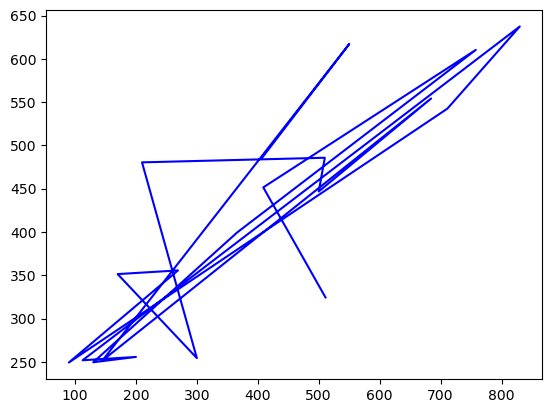

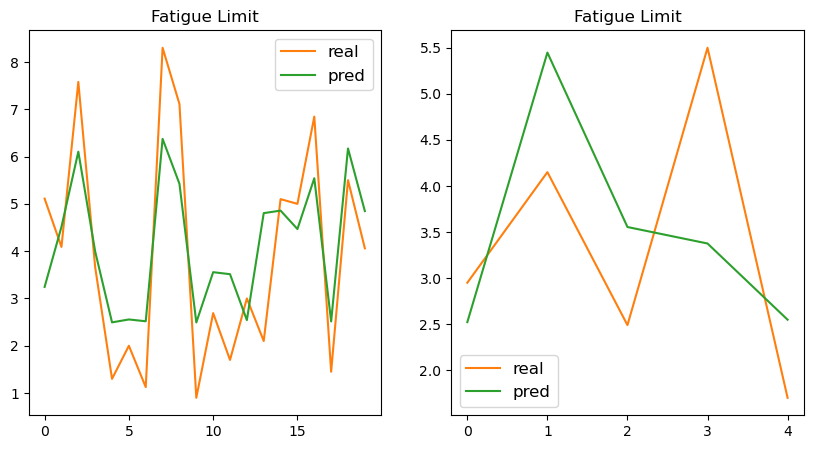

Epoch 211, loss: 17188.466796875
Train set
[2.        4.06      5.111111  3.66      7.577778  5.        1.7
 0.9       6.8444448 1.45      7.1111107 5.501     2.69      5.1
 4.09      2.1       8.3       1.125     3.        1.3      ]
[2.553948  4.841363  3.2377372 3.9796002 6.1256576 4.4725204 3.5116432
 2.4858325 5.5507708 2.5101714 5.4283147 6.185379  3.557269  4.858277
 4.498255  4.8006682 6.3654203 2.5126302 2.540128  2.4899037]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5192082 5.4398828 3.5555398 3.365267  2.5459433]


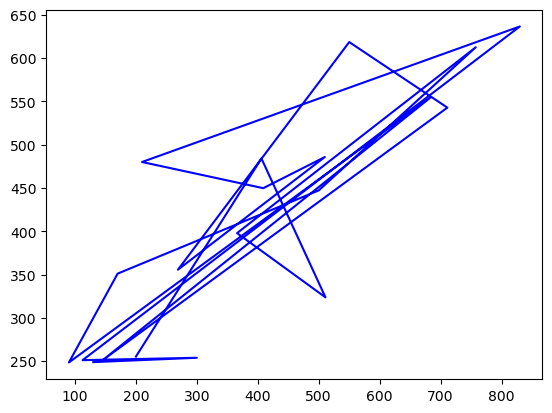

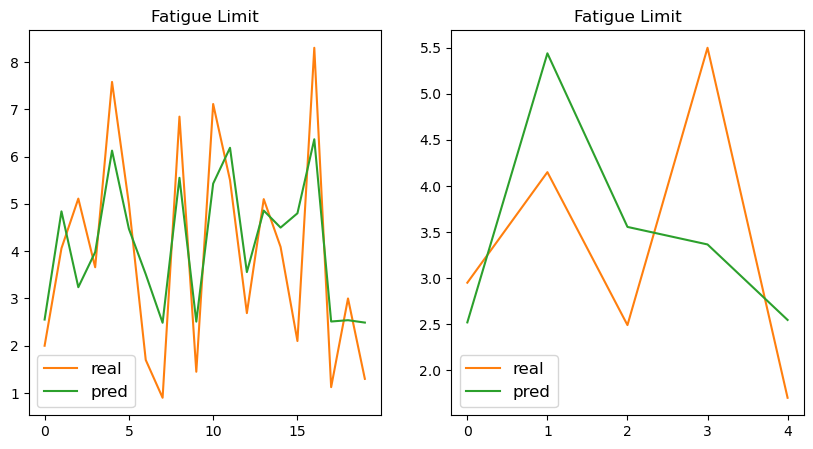

Epoch 221, loss: 17117.296875
Train set
[0.9       7.577778  5.1       3.66      2.        2.69      8.3
 7.1111107 1.7       1.45      5.501     3.        4.09      1.125
 5.111111  4.06      6.8444448 2.1       5.        1.3      ]
[2.4807236 6.147954  4.858861  3.9659476 2.5515485 3.5586588 6.3598175
 5.431743  3.509798  2.5051339 6.1994324 2.5372143 4.4817185 2.5086255
 3.2330968 4.8376765 5.5596466 4.797885  4.477158  2.4846983]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5162537 5.433796  3.5570276 3.3551486 2.543504 ]


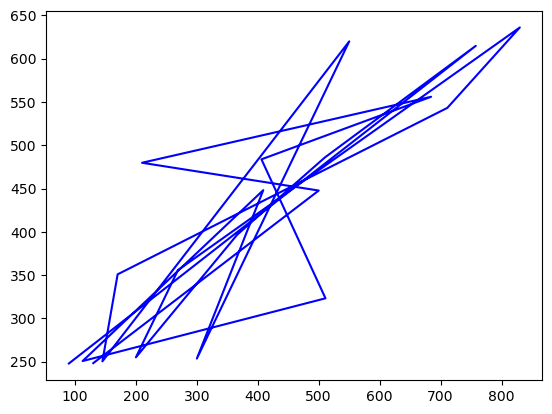

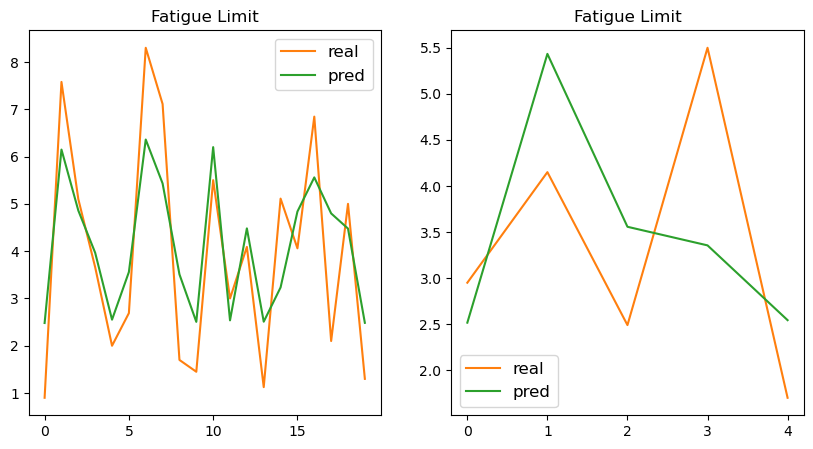

Epoch 231, loss: 17044.41796875
Train set
[1.7       0.9       4.06      1.45      2.        6.8444448 4.09
 7.1111107 7.577778  5.1       5.        8.3       3.        5.111111
 2.1       5.501     3.66      1.3       2.69      1.125    ]
[3.508796  2.4747725 4.8326106 2.500561  2.5497591 5.5701294 4.4649444
 5.436651  6.17224   4.8607535 4.483023  6.3523707 2.5348403 3.2278817
 4.794832  6.2153773 3.9521036 2.4799485 3.5610065 2.5038145]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5136154 5.4266777 3.5591896 3.3449297 2.5414212]


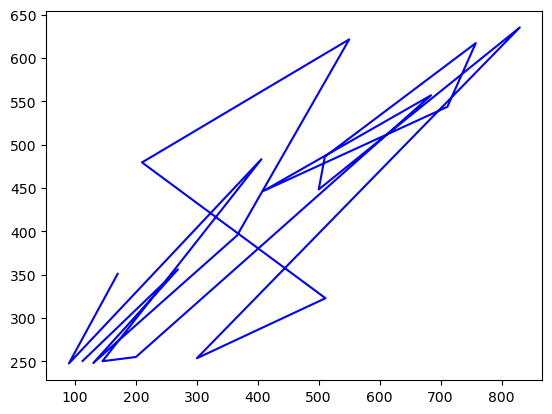

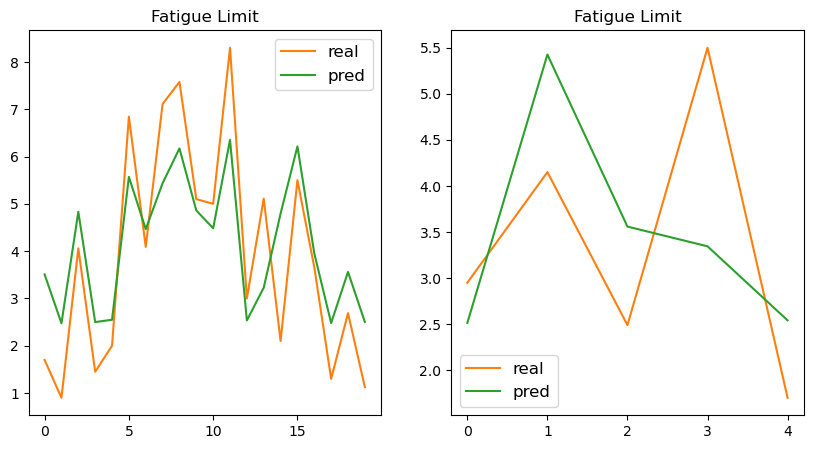

Epoch 241, loss: 16972.46484375
Train set
[1.3       3.        5.111111  4.06      4.09      6.8444448 0.9
 8.3       1.7       5.1       3.66      1.125     2.69      7.577778
 1.45      2.1       2.        5.        5.501     7.1111107]
[2.4750972 2.532471  3.2229736 4.8284817 4.4484735 5.581292  2.4691582
 6.3461256 3.5079699 4.8630967 3.9385254 2.499388  3.5636823 6.197618
 2.495893  4.7927537 2.5480845 4.4893355 6.232252  5.4420857]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5106053 5.420037  3.5611696 3.3349118 2.539016 ]


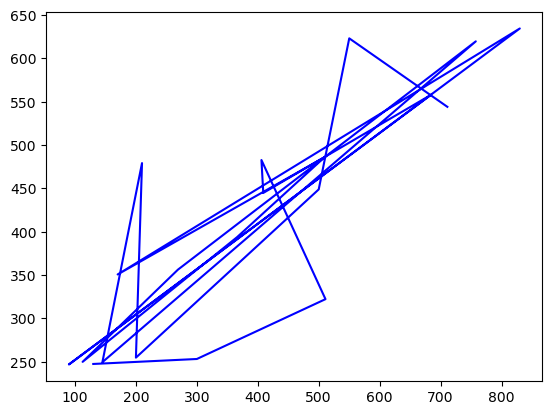

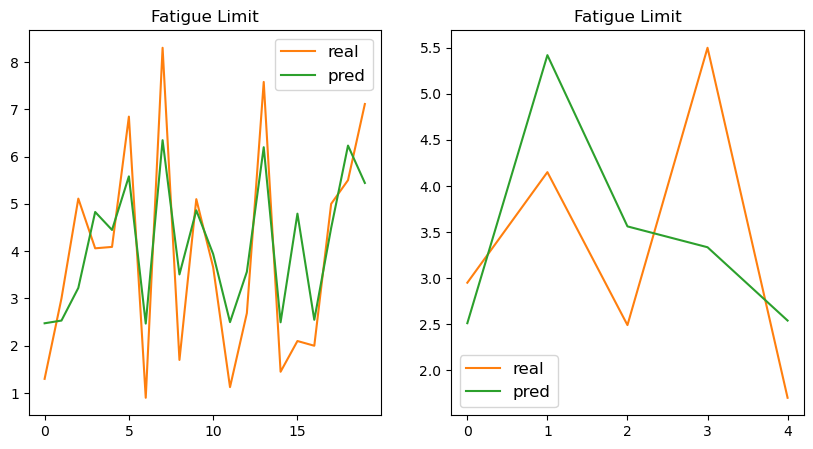

Epoch 251, loss: 16898.98046875
Train set
[1.3       1.7       2.        6.8444448 5.501     3.        7.1111107
 1.125     7.577778  0.9       2.1       5.        3.66      8.3
 2.69      4.06      1.45      4.09      5.111111  5.1      ]
[2.4683611 3.5048723 2.5447407 5.589325  6.245847  2.5283043 5.444297
 2.494141  6.2199388 2.4626827 4.788014  4.4930043 3.9237823 6.3380613
 3.5642278 4.8229923 2.4893336 4.4306536 3.2171426 4.8625364]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5068548 5.412068  3.5624344 3.32399   2.5359156]


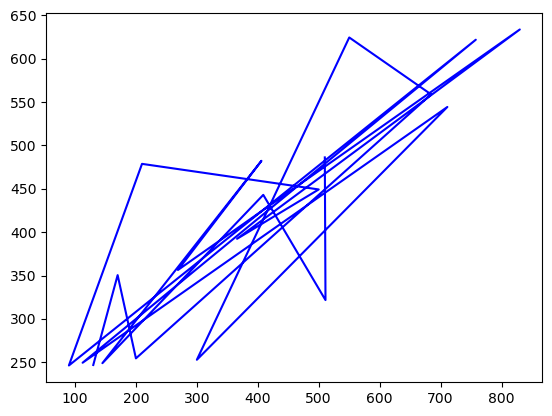

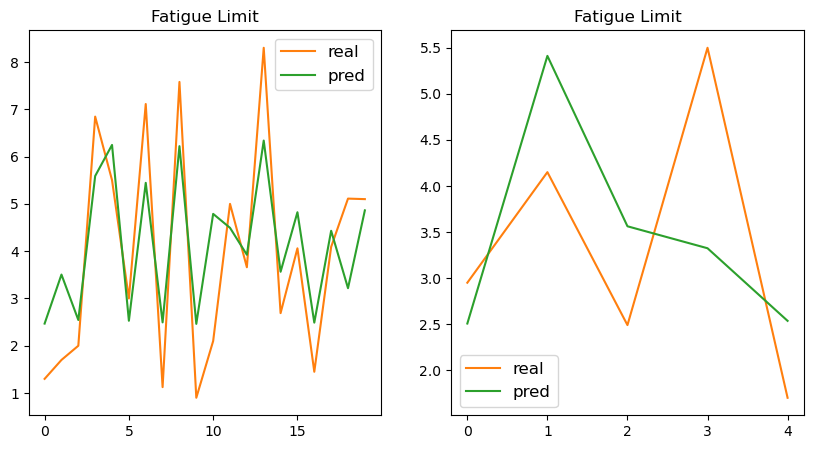

Epoch 261, loss: 16826.34765625
Train set
[1.125     5.1       5.        2.69      5.111111  5.501     3.
 1.45      0.9       1.3       2.        4.09      1.7       6.8444448
 8.3       7.577778  7.1111107 4.06      3.66      2.1      ]
[2.4895535 4.866522  4.5008645 3.568097  3.2122886 6.26542   2.526361
 2.4848847 2.4568114 2.4637136 2.5437083 4.414392  3.5049253 5.6026416
 6.331958  6.24828   5.4515953 4.8190193 3.9103951 4.7867594]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5048866 5.405823  3.566451  3.3140855 2.5346565]


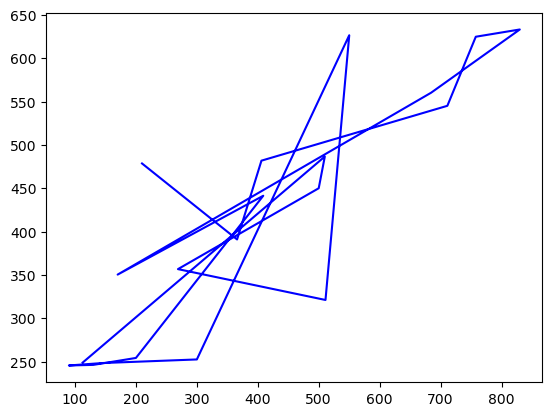

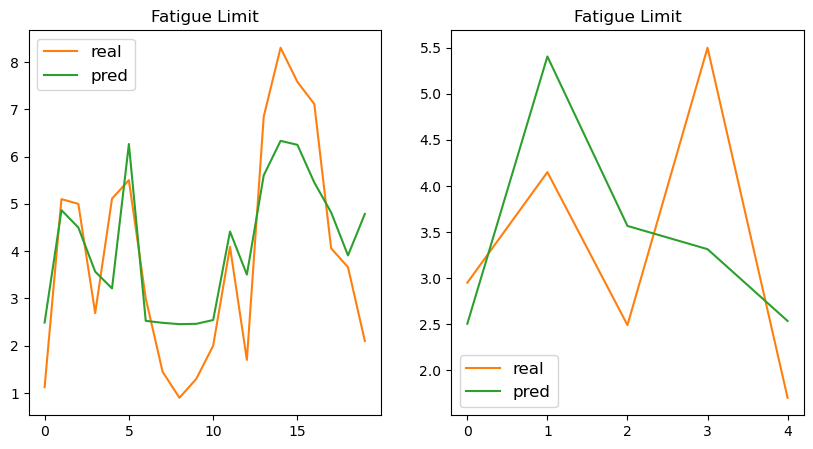

Epoch 271, loss: 16753.134765625
Train set
[1.125     3.        5.111111  0.9       2.69      1.45      2.
 3.66      6.8444448 7.577778  4.06      4.09      5.1       1.3
 5.501     8.3       1.7       5.        2.1       7.1111107]
[2.4840517 2.5206404 3.2063231 2.4499803 3.5672245 2.4765496 2.539077
 3.8953857 5.608815  6.269278  4.813555  4.396281  4.864042  2.4551992
 6.2773266 6.3238544 3.5000708 4.502803  4.7813673 5.451689 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4994059 5.397676  3.5660615 3.3029168 2.5299358]


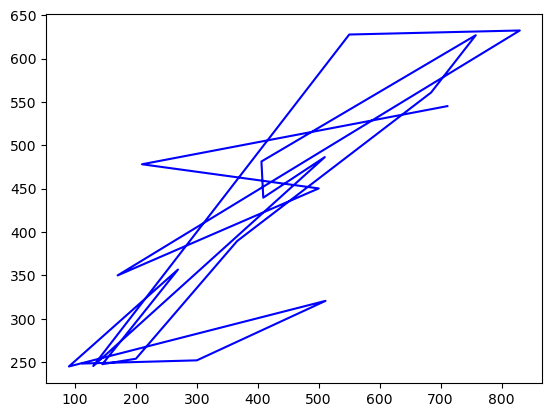

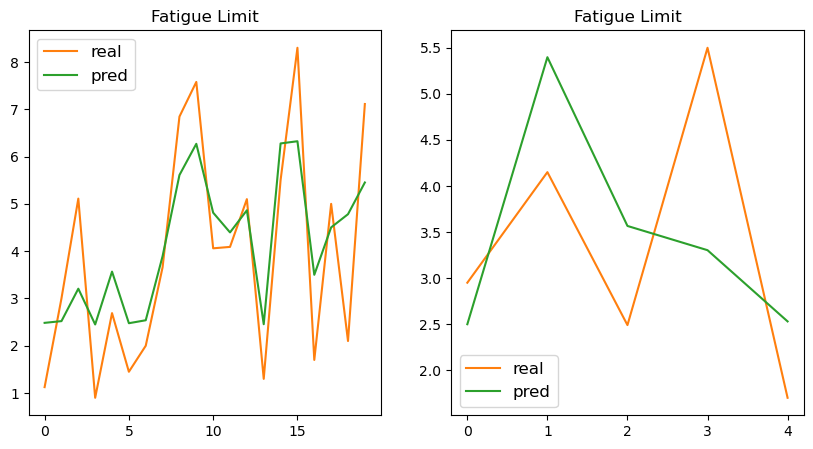

Epoch 281, loss: 16675.544921875
Train set
[0.9       7.1111107 1.7       1.125     5.501     5.        5.111111
 4.09      4.06      2.1       8.3       1.3       2.69      6.8444448
 2.        7.577778  5.1       1.45      3.        3.66     ]
[2.443519  5.4592414 3.4999092 2.47898   6.2977977 4.5108767 3.20104
 4.379307  4.8092146 4.7782493 6.3171916 2.4499347 3.5712314 5.6226516
 2.5379102 6.2988153 4.8682327 2.4714935 2.5183215 3.8813522]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.496467  5.3904514 3.56941   3.2922788 2.527812 ]


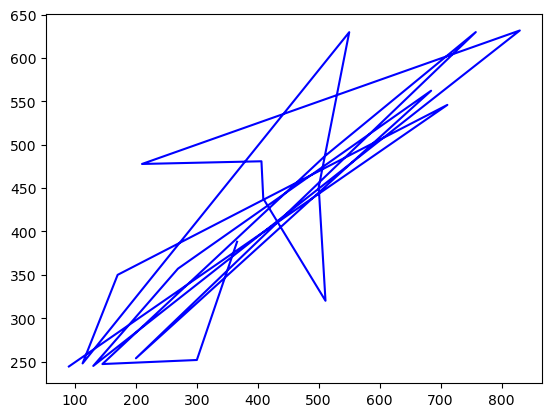

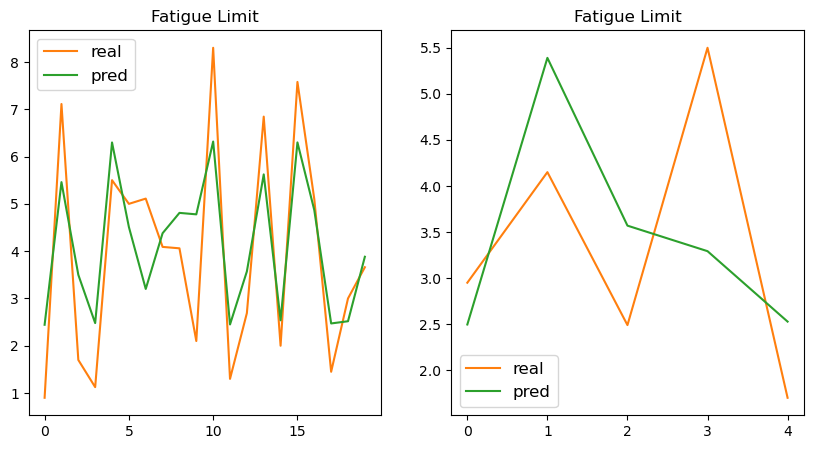

Epoch 291, loss: 16601.4765625
Train set
[1.125     8.3       0.9       7.577778  1.45      6.8444448 5.
 5.501     5.1       7.1111107 1.3       4.09      3.        3.66
 2.1       1.7       2.        2.69      5.111111  4.06     ]
[2.4726956 6.307835  2.435799  6.3248663 2.4643815 5.63302   4.5160384
 6.314596  4.869266  5.4632654 2.4426217 4.3611126 2.514057  3.8658912
 4.7737355 3.4972527 2.5349398 3.572913  3.1943302 4.8028536]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4914517 5.3816614 3.5702658 3.2806368 2.5236635]


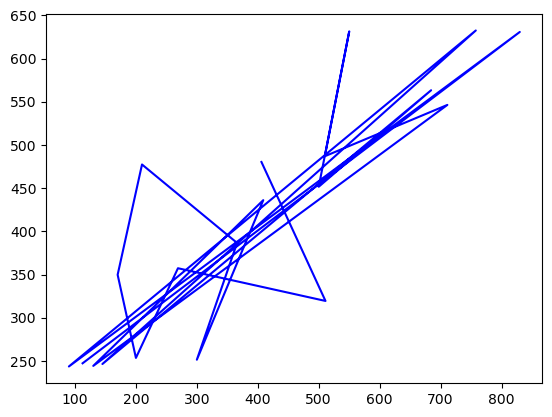

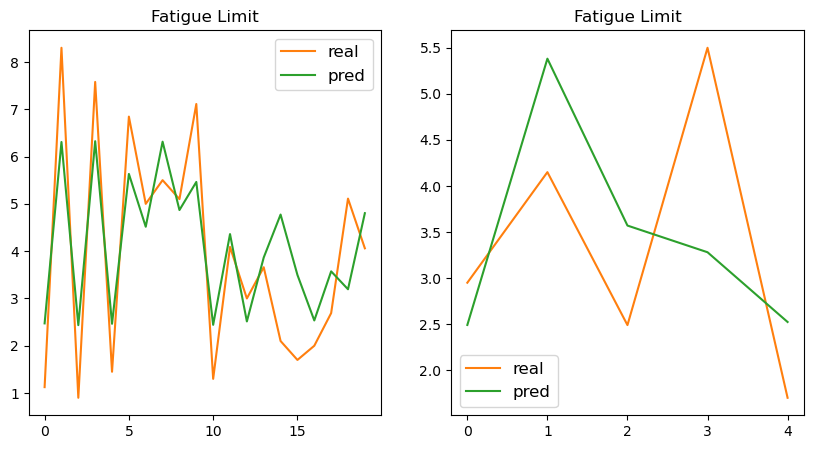

Epoch 301, loss: 16526.740234375
Train set
[3.66      7.1111107 1.45      8.3       5.501     7.577778  4.09
 1.3       6.8444448 2.        3.        4.06      2.1       5.111111
 0.9       5.        2.69      5.1       1.125     1.7      ]
[3.8514423 5.4693756 2.4578295 6.3009367 6.334061  6.353682  4.3437552
 2.4358578 5.645641  2.5328274 2.5104988 4.7983937 4.770889  3.1888266
 2.4288146 4.5229063 3.575952  4.8721757 2.4672143 3.4957328]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4881077 5.3740187 3.5737705 3.2696545 2.521258 ]


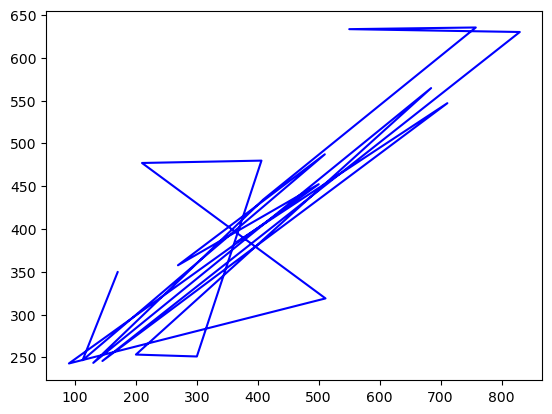

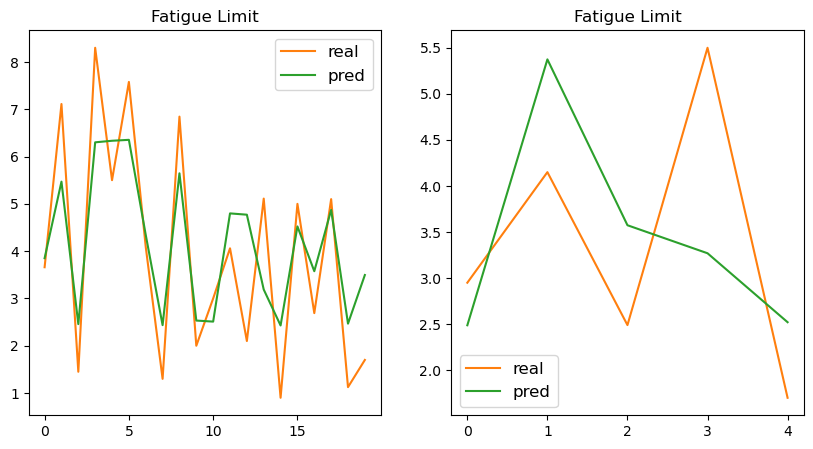

Epoch 311, loss: 16449.79296875
Train set
[1.7       4.06      2.1       1.125     5.111111  3.66      7.577778
 5.1       5.501     1.45      4.09      1.3       0.9       6.8444448
 3.        5.        2.69      8.3       2.        7.1111107]
[3.4927735 4.7935643 4.7661114 2.461349  3.1830018 3.837519  6.380873
 4.873421  6.3517265 2.449996  4.3267574 2.4278142 2.4213874 5.656499
 2.5057974 4.528241  3.5777621 6.29351   2.5297058 5.4736323]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4823334 5.3671837 3.5743089 3.2591803 2.5164738]


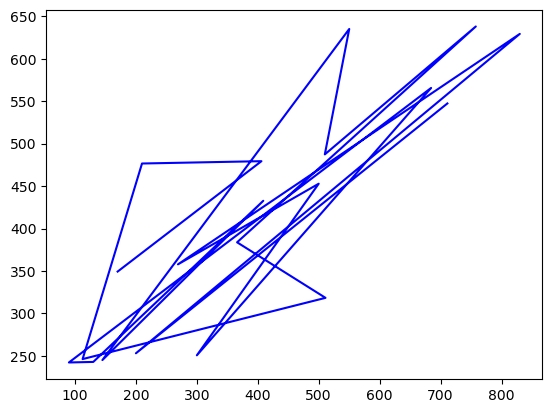

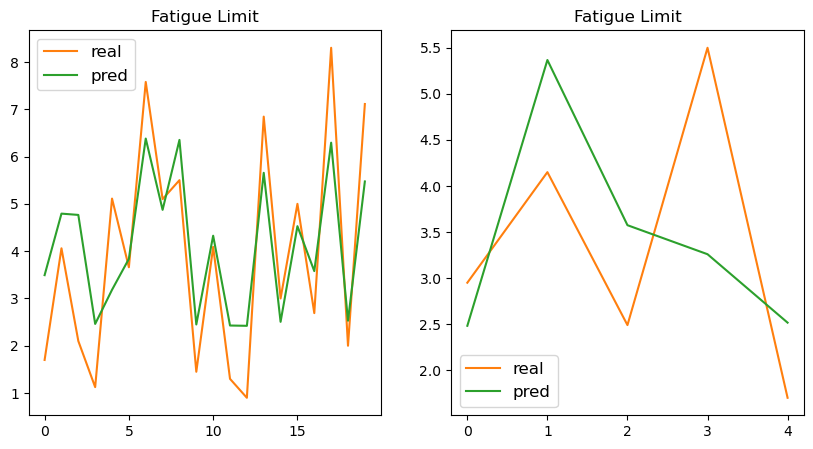

Epoch 321, loss: 16372.8486328125
Train set
[5.        1.125     6.8444448 8.3       5.111111  1.45      2.1
 3.66      7.577778  7.1111107 5.1       4.06      1.3       5.501
 4.09      1.7       3.        2.69      0.9       2.       ]
[4.5312    2.4545465 5.6645446 6.28417   3.1761487 2.4404168 4.759627
 3.8213043 6.4052763 5.47501   4.8720827 4.787312  2.4180305 6.3664107
 4.307305  3.487707  2.4994848 3.5776727 2.4129665 2.5251145]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4780662 5.3575172 3.5770986 3.2468734 2.5132394]


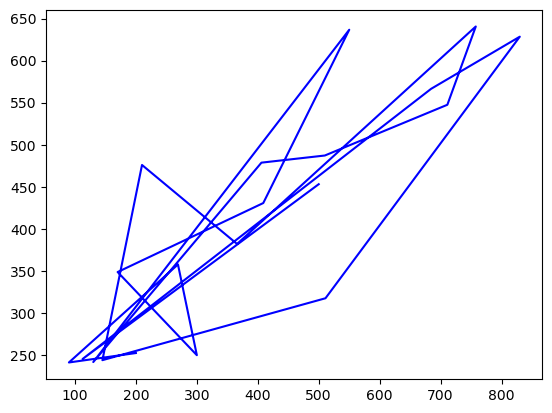

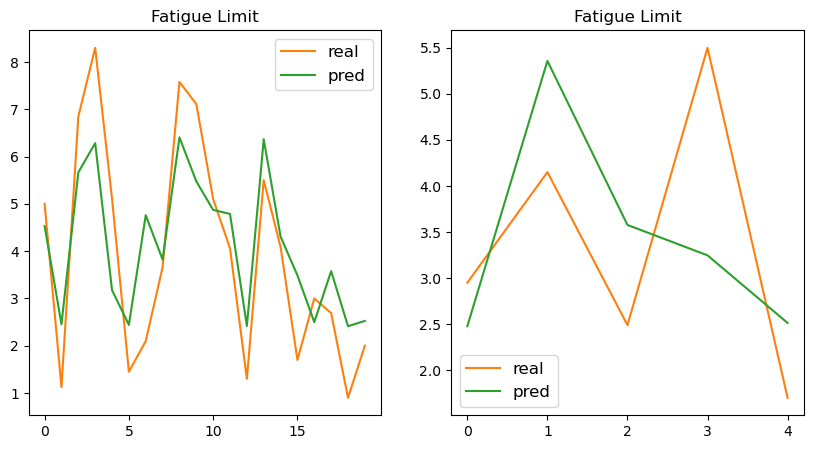

Epoch 331, loss: 16296.693359375
Train set
[2.1       2.69      6.8444448 5.111111  5.        8.3       0.9
 3.66      3.        7.1111107 5.1       4.09      1.3       1.7
 5.501     1.125     1.45      4.06      2.        7.577778 ]
[4.7550864 3.5803757 5.6770034 3.1701815 4.537697  6.2766304 2.405014
 3.807269  2.495183  5.4806733 4.874537  4.2928247 2.410315  3.4852042
 6.38595   2.4482703 2.4326966 4.782456  2.5224738 6.434616 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.471925  5.34967   3.577432  3.2357287 2.508135 ]


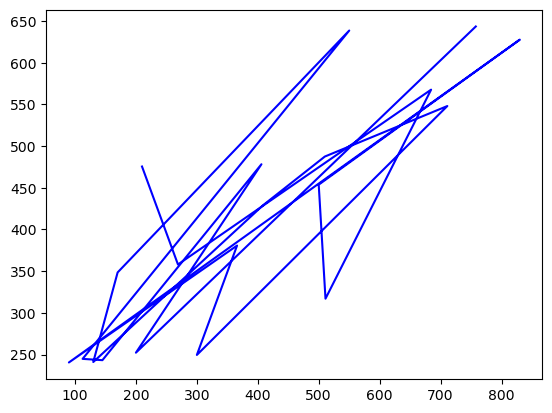

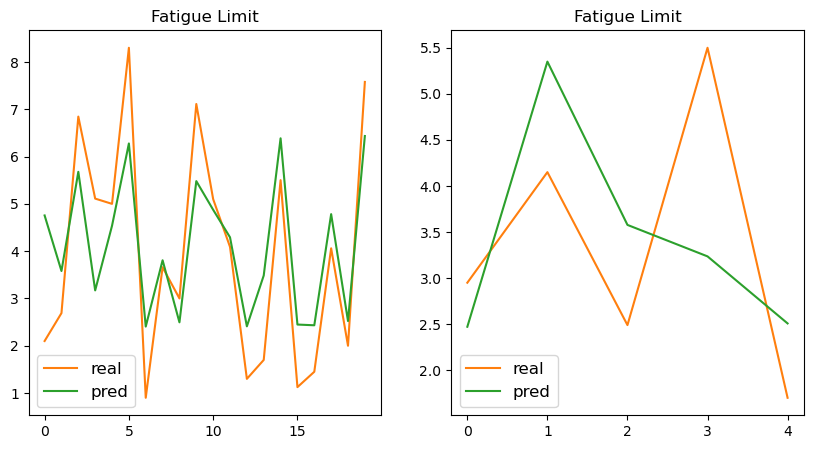

Epoch 341, loss: 16221.9248046875
Train set
[3.        7.577778  5.        1.125     6.8444448 0.9       1.7
 3.66      2.        4.09      4.06      1.45      8.3       1.3
 7.1111107 5.111111  5.1       2.1       5.501     2.69     ]
[2.491998  6.4648504 4.5450683 2.4413128 5.6903353 2.3963332 3.4830072
 3.7919507 2.5203588 4.2760487 4.776678  2.4259634 6.2678432 2.403135
 5.487198  3.163551  4.877456  4.7504663 6.4059124 3.5835834]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4687297 5.34059   3.5806708 3.223819  2.505761 ]


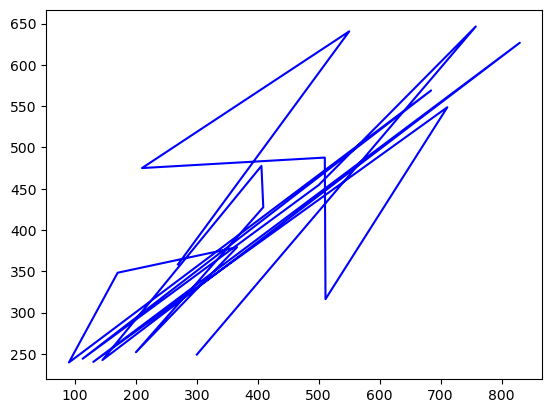

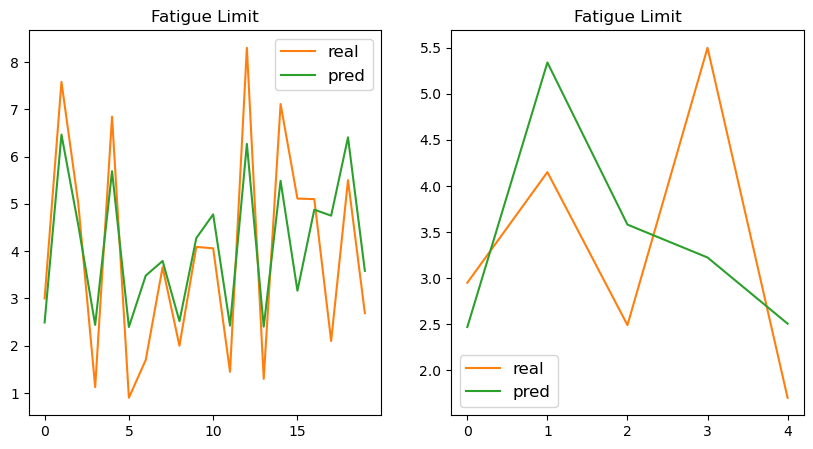

Epoch 351, loss: 16150.998046875
Train set
[5.501     2.69      1.3       0.9       2.        7.1111107 1.125
 4.09      2.1       1.45      5.111111  8.3       1.7       3.66
 5.        3.        6.8444448 4.06      7.577778  5.1      ]
[6.425601  3.5868104 2.3966415 2.3869863 2.5183532 5.4938374 2.433749
 4.259328  4.746126  2.4196897 3.1563668 6.2580547 3.4806125 3.7765894
 4.5526752 2.4894154 5.703813  4.7701716 6.4952683 4.8802133]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4645448 5.33066   3.581847  3.2114062 2.5022428]


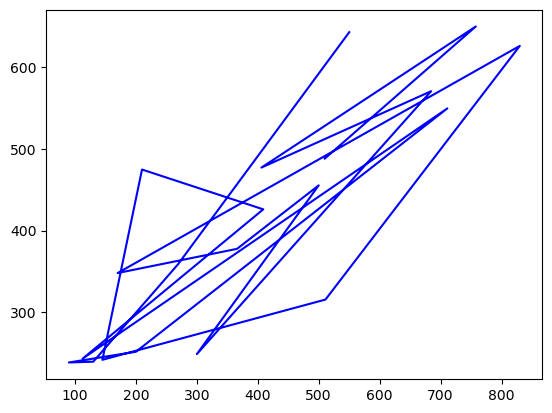

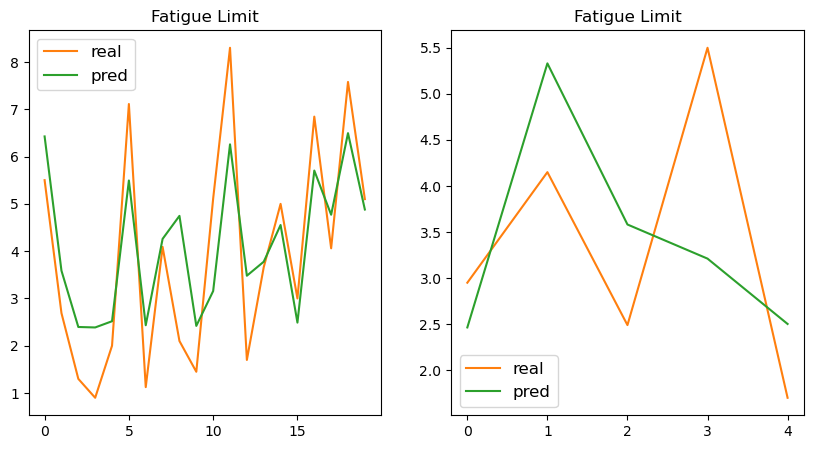

Epoch 361, loss: 16074.0185546875
Train set
[5.111111  5.501     1.125     1.45      2.69      2.1       5.1
 6.8444448 1.7       0.9       2.        1.3       5.        7.1111107
 3.        4.09      3.66      4.06      7.577778  8.3      ]
[3.1510632 6.437966  2.4274306 2.4100199 3.5856354 4.7386255 4.8768716
 5.7106977 3.4735088 2.3787997 2.5130649 2.3885555 4.554881  5.4938264
 2.4836378 4.2459917 3.7648664 4.766576  6.518882  6.252044 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.461947  5.325923  3.5849392 3.2022345 2.500258 ]


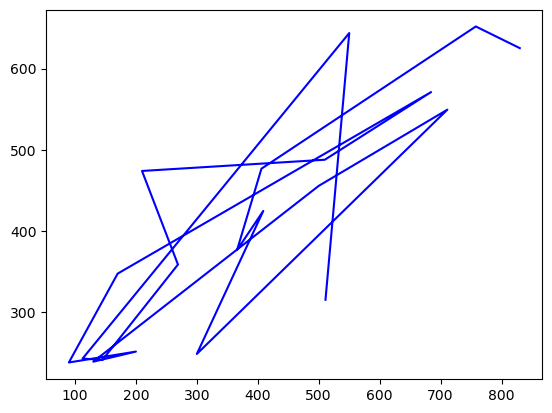

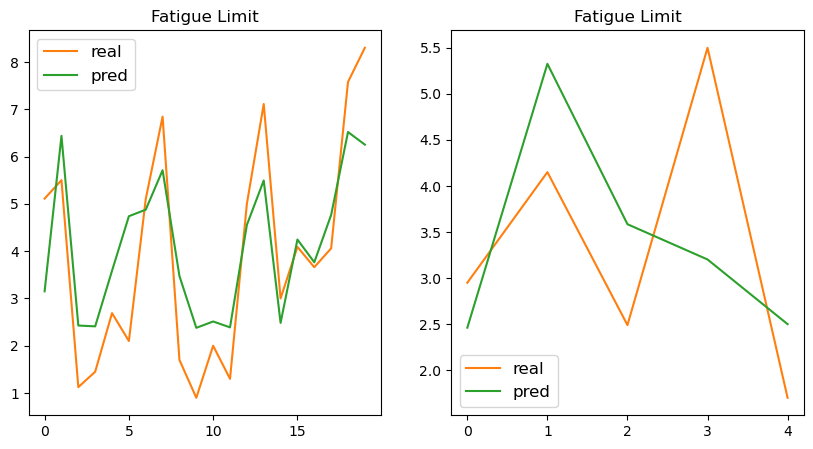

Epoch 371, loss: 15998.458984375
Train set
[6.8444448 1.125     5.501     1.7       3.        1.45      1.3
 2.1       7.577778  8.3       5.1       0.9       2.69      7.1111107
 4.09      5.        3.66      4.06      5.111111  2.       ]
[5.726572  2.4187548 6.460052  3.4721534 2.4823234 2.4047136 2.381236
 4.7323537 6.551945  6.2406    4.881602  2.3682153 3.5903585 5.502802
 4.2283716 4.5644345 3.749442  4.758879  3.1429548 2.5121474]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4573843 5.3155    3.5855308 3.189556  2.4963503]


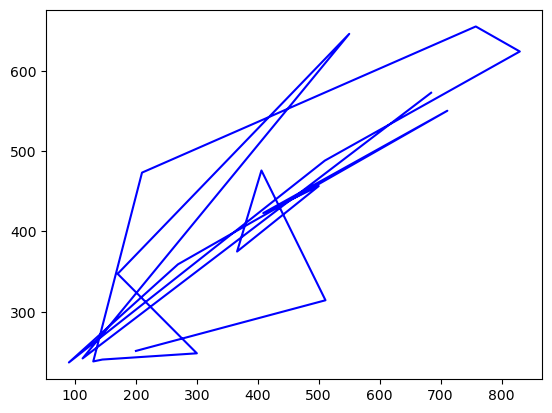

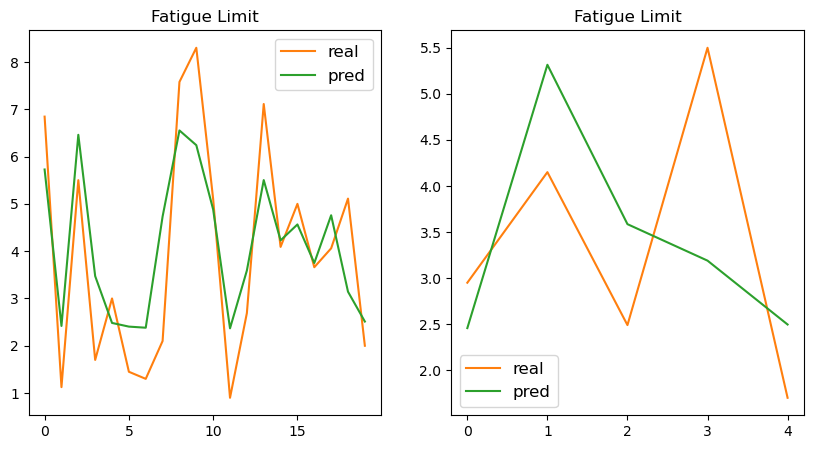

Epoch 381, loss: 15922.357421875
Train set
[5.1       7.1111107 4.06      2.1       7.577778  2.        1.3
 2.69      3.        8.3       4.09      5.        1.7       6.8444448
 5.111111  3.66      5.501     1.125     1.45      0.9      ]
[4.8840923 5.5091853 4.7546315 4.7267494 6.582699  2.509797  2.3737054
 3.5933807 2.4792275 6.233639  4.2136483 4.5717897 3.4687653 5.7399693
 3.13698   3.73655   6.4797072 2.4115646 2.397409  2.3590205]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4556434 5.308249  3.59047   3.1788282 2.4953775]


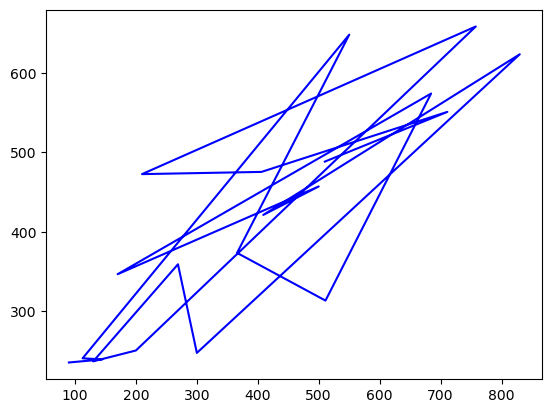

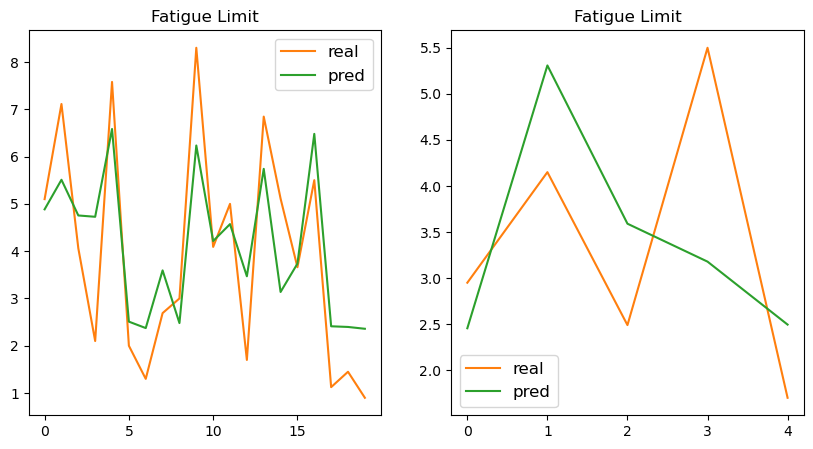

Epoch 391, loss: 15843.2373046875
Train set
[2.        1.125     4.06      5.        1.3       5.501     1.45
 0.9       5.1       3.66      3.        7.1111107 6.8444448 8.3
 7.577778  4.09      5.111111  1.7       2.69      2.1      ]
[2.50472   2.4031248 4.748538  4.5745006 2.3635674 6.4926915 2.387477
 2.3485076 4.8812766 3.7241538 2.4736736 5.5098333 5.7475786 6.2241955
 6.607223  4.1995916 3.1299026 3.4613192 3.5926034 4.717264 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.448896  5.2990003 3.5881617 3.1680062 2.489291 ]


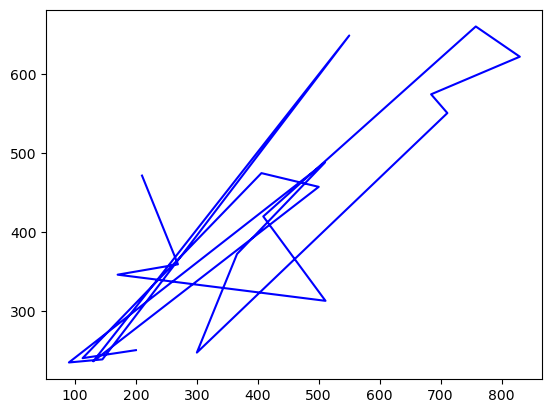

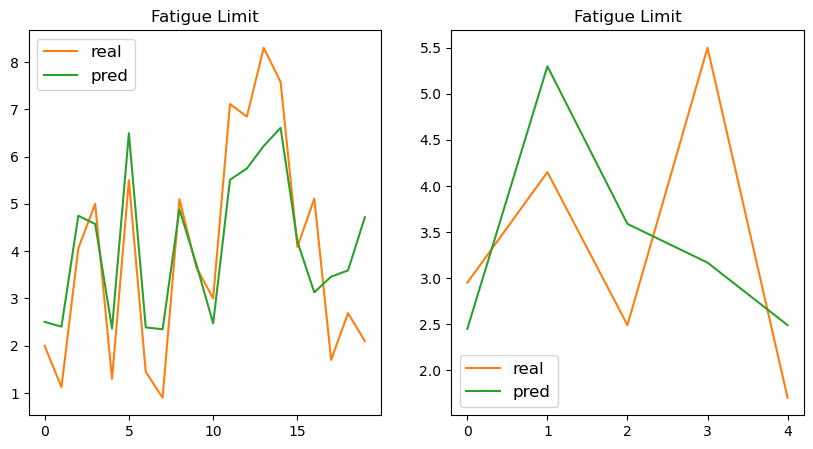

Epoch 401, loss: 15770.1484375
Train set
[1.45      1.7       3.        4.09      5.111111  5.1       6.8444448
 5.501     2.69      7.1111107 2.        2.1       4.06      0.9
 1.125     5.        7.577778  1.3       3.66      8.3      ]
[2.3813407 3.4594877 2.472108  4.1873674 3.123105  4.8866215 5.764323
 6.515889  3.5977333 5.519474  2.5038521 4.7120686 4.743137  2.3379316
 2.3947117 4.5845156 6.641699  2.3571923 3.7130892 6.2156067]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4476423 5.292747  3.5938902 3.1595788 2.4888358]


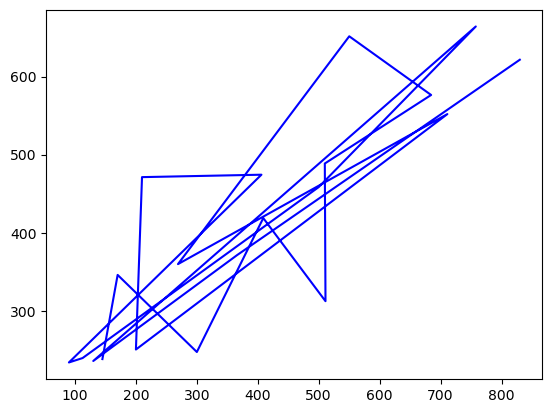

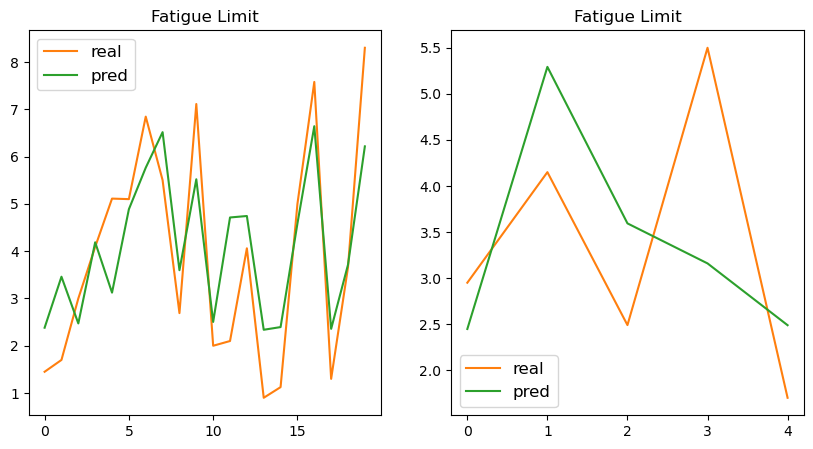

Epoch 411, loss: 15688.2138671875
Train set
[6.8444448 4.09      8.3       2.        7.1111107 3.66      4.06
 2.69      7.577778  5.111111  5.1       3.        0.9       1.125
 1.3       5.501     1.45      1.7       2.1       5.       ]
[5.769064  4.1722827 6.2015285 2.4972208 5.5172343 3.6997788 4.733605
 3.5950708 6.6632795 3.1134624 4.8813796 2.464554  2.3248324 2.3838384
 2.3447065 6.5259414 2.369056  3.4496198 4.698273  4.5846953]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.440489  5.279342  3.5918953 3.1474395 2.482537 ]


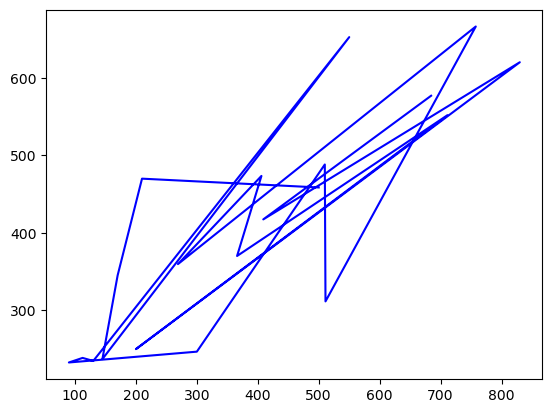

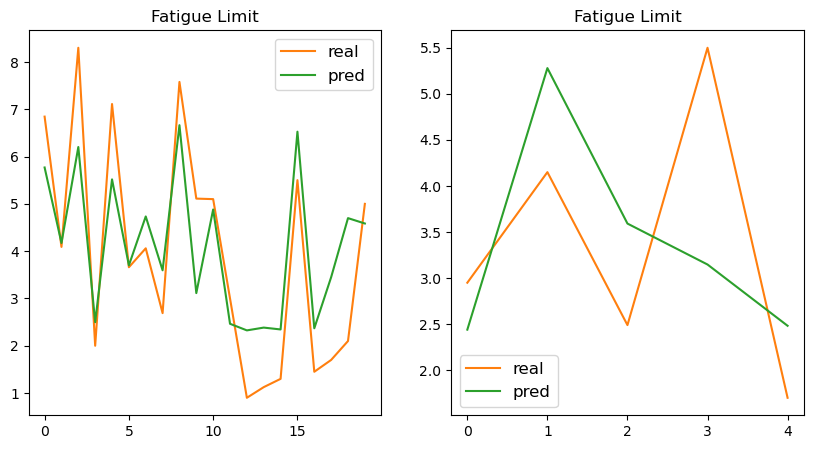

Epoch 421, loss: 15617.6845703125
Train set
[1.125     3.        1.45      8.3       5.501     1.7       7.1111107
 6.8444448 1.3       0.9       2.1       5.        4.09      5.1
 2.        3.66      7.577778  2.69      5.111111  4.06     ]
[2.3754997 2.456004  2.3560278 6.194873  6.536218  3.4390376 5.5145984
 5.7735925 2.3353493 2.314141  4.6916785 4.5844297 4.1638417 4.875933
 2.4901314 3.6926813 6.6851177 3.5921555 3.1075573 4.7297664]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4330704 5.274192  3.590426  3.1408093 2.476142 ]


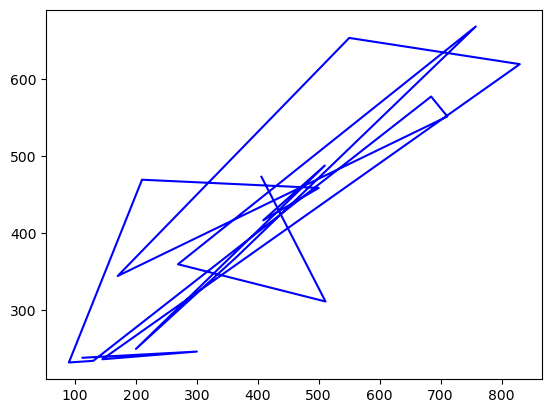

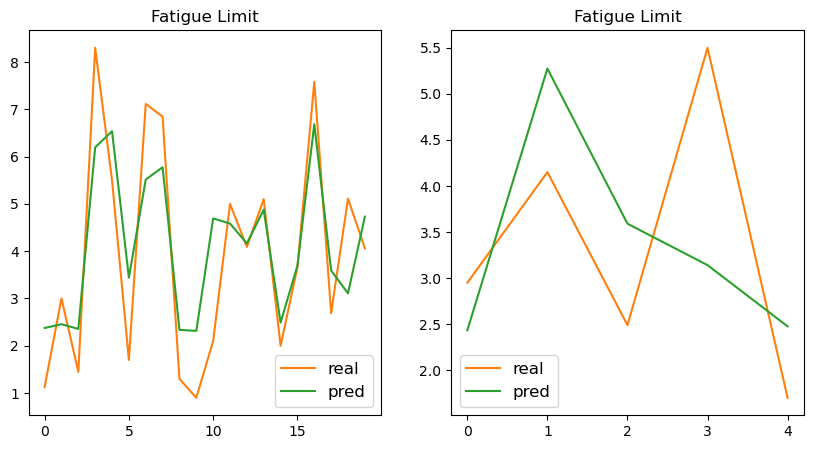

Epoch 431, loss: 15532.453125
Train set
[7.577778  1.125     6.8444448 2.69      8.3       5.1       5.111111
 5.        2.        4.09      1.45      5.501     3.        7.1111107
 1.3       4.06      2.1       3.66      1.7       0.9      ]
[6.7226872 2.3639803 5.793204  3.5990708 6.1809664 4.8836026 3.0979185
 4.5967803 2.4905763 4.15362   2.3503714 6.562066  2.4560757 5.5270553
 2.3255653 4.7204576 4.6803255 3.6839633 3.4380753 2.3002126]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4296393 5.2631655 3.5927625 3.1314404 2.4734337]


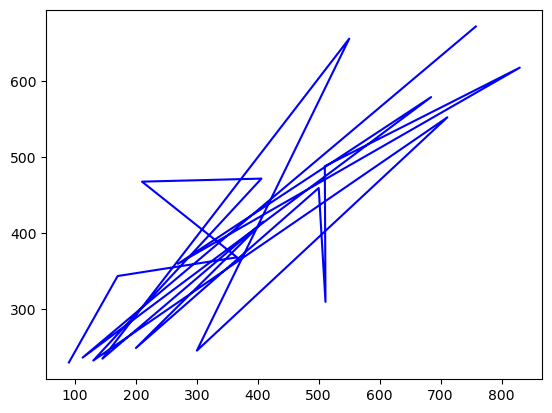

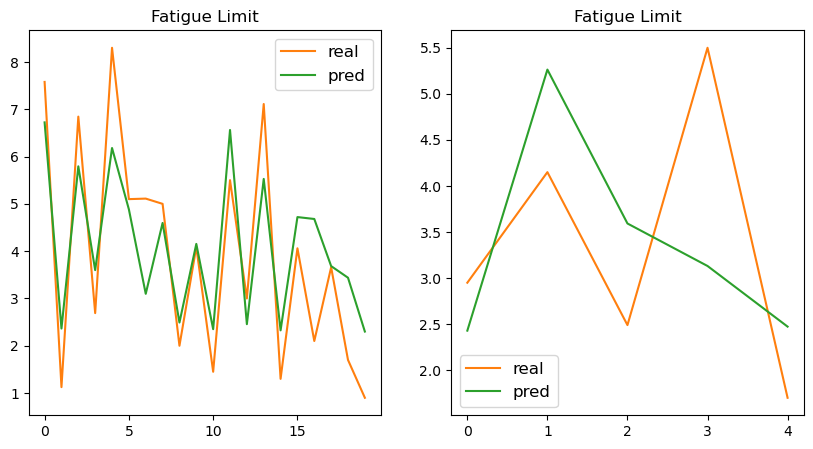

Epoch 441, loss: 15452.6044921875
Train set
[0.9       5.1       2.        1.3       7.1111107 4.06      8.3
 1.7       4.09      2.1       6.8444448 5.501     3.        5.
 2.69      1.45      3.66      7.577778  5.111111  1.125    ]
[2.2890286 4.8881783 2.4889703 2.3172164 5.535911  4.7176466 6.175531
 3.4341962 4.148403  4.674257  5.8094287 6.5847    2.4535093 4.6060624
 3.6036222 2.3422701 3.679623  6.75725   3.09255   2.3553476]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4261637 5.2584753 3.5962079 3.1262755 2.4709117]


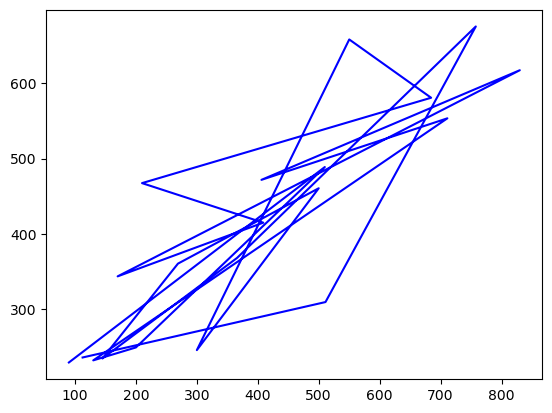

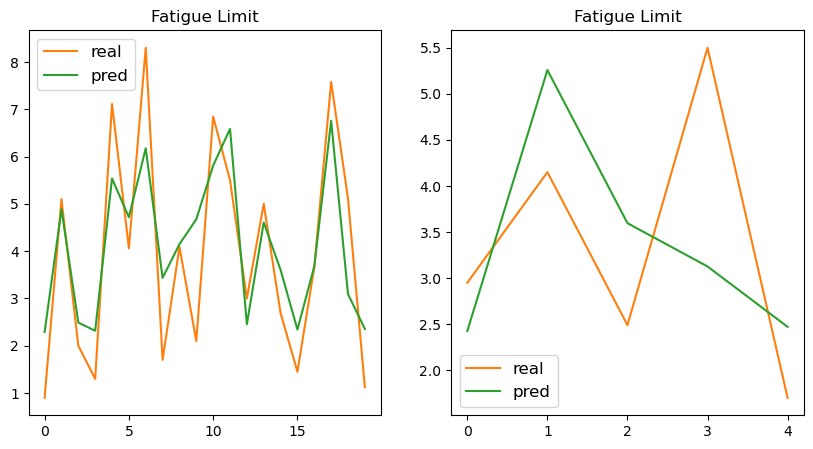

Epoch 451, loss: 15367.2685546875
Train set
[5.1       3.        1.125     6.8444448 7.1111107 5.        0.9
 2.1       2.69      4.09      4.06      1.45      3.66      5.501
 8.3       5.111111  7.577778  1.7       2.        1.3      ]
[4.8805757 2.4441748 2.3427901 5.811809  5.531117  4.6040435 2.2738676
 4.6588845 3.5992215 4.1414127 4.708006  2.3272166 3.6736648 6.5920715
 6.161056  3.0825434 6.7768154 3.421085  2.4807882 2.3025782]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.420406  5.248987  3.5966194 3.1188514 2.4661324]


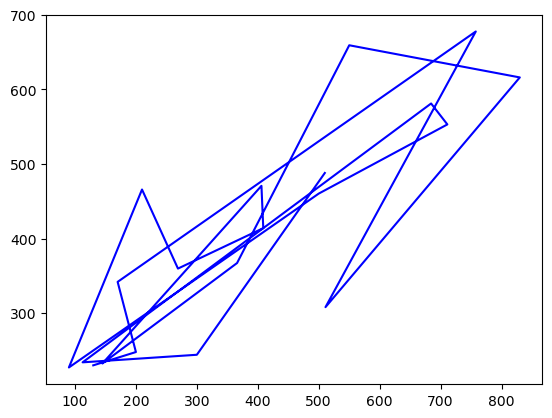

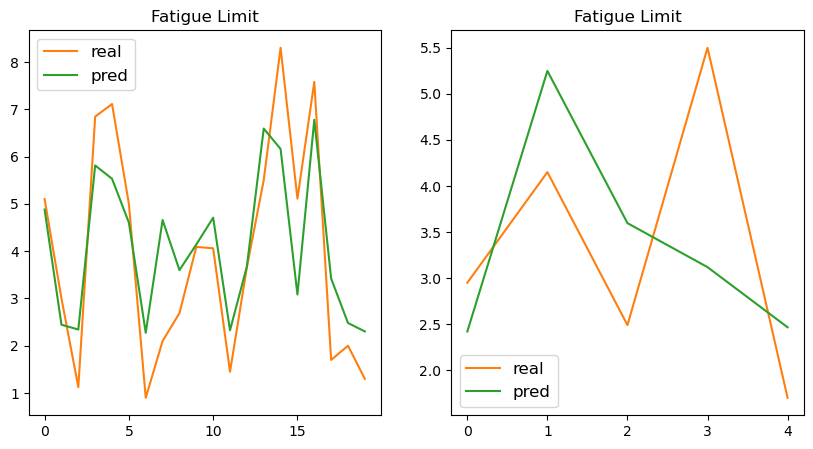

Epoch 461, loss: 15283.6904296875
Train set
[5.111111  2.        1.3       4.09      1.125     3.66      1.45
 3.        0.9       4.06      5.1       2.69      6.8444448 2.1
 5.501     8.3       5.        1.7       7.577778  7.1111107]
[3.0750551 2.4759812 2.2916348 4.134395  2.3317137 3.6676397 2.3152332
 2.438264  2.2600574 4.7022285 4.879432  3.599577  5.8217096 4.6483
 6.6076655 6.151589  4.6080446 3.4121919 6.8047833 5.5336285]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4121714 5.2366962 3.5938916 3.1109877 2.4589126]


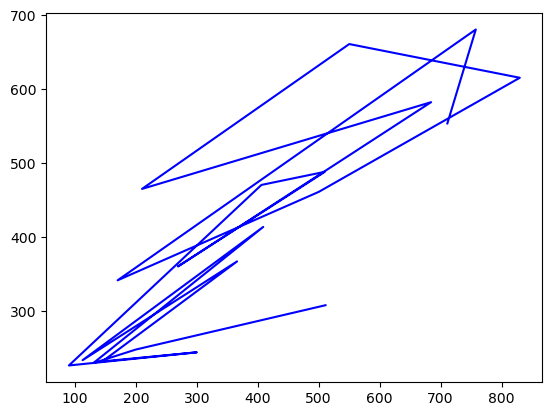

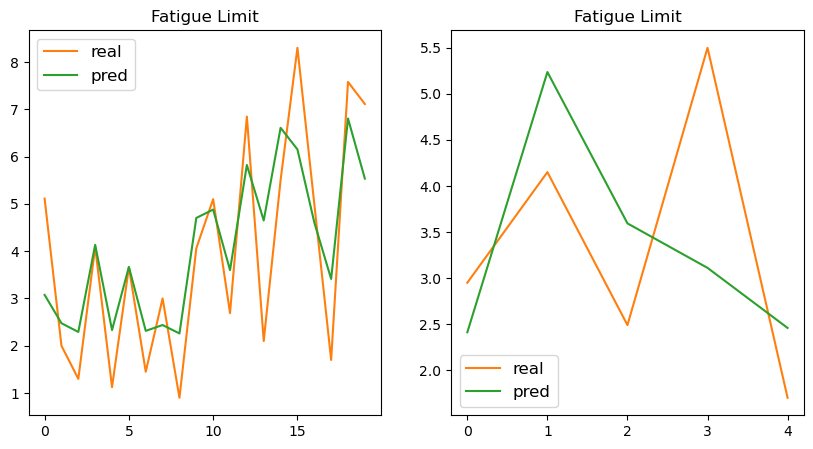

Epoch 471, loss: 15196.177734375
Train set
[2.69      3.66      1.3       5.1       2.1       4.09      5.
 4.06      5.111111  3.        6.8444448 2.        1.45      1.7
 8.3       7.1111107 1.125     0.9       7.577778  5.501    ]
[3.6076486 3.6669369 2.283855  4.8886027 4.640812  4.133459  4.62193
 4.7001023 3.070375  2.43896   5.843504  2.4770226 2.3096046 3.4106307
 6.1470137 5.5479937 2.3223116 2.2480419 6.845278  6.6355896]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4141319 5.238415  3.6035316 3.108588  2.4616363]


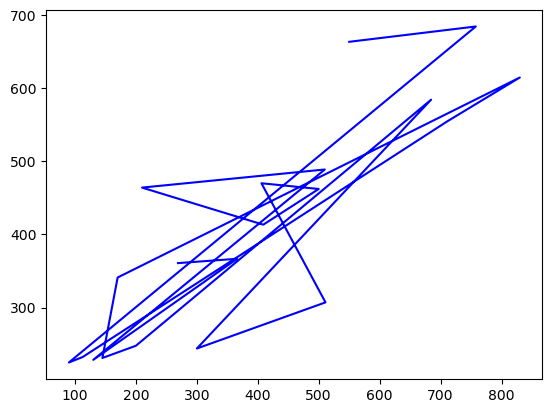

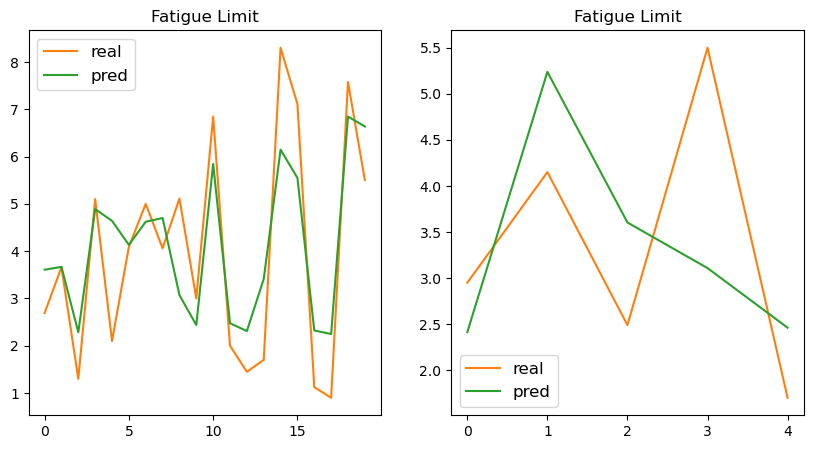

Epoch 481, loss: 15108.962890625
Train set
[1.7       1.45      4.09      6.8444448 2.69      7.1111107 2.
 1.3       5.        0.9       8.3       3.66      5.501     3.
 4.06      5.1       1.125     7.577778  5.111111  2.1      ]
[3.396552  2.2949224 4.1230755 5.8465247 3.6035633 5.5438557 2.4692168
 2.2697315 4.6205835 2.2314825 6.132245  3.6578295 6.6425853 2.4308386
 4.6902766 4.8811316 2.3084288 6.865389  3.0604773 4.625072 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4039273 5.227182  3.5967264 3.1006255 2.4521823]


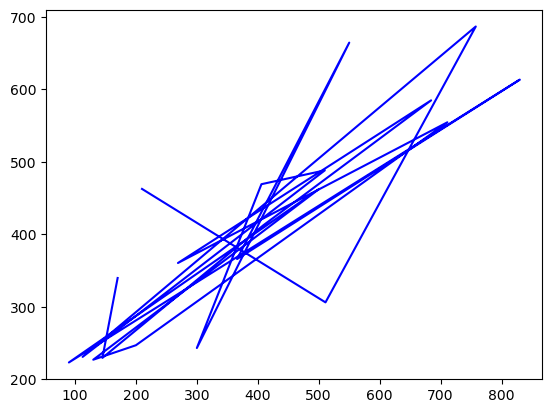

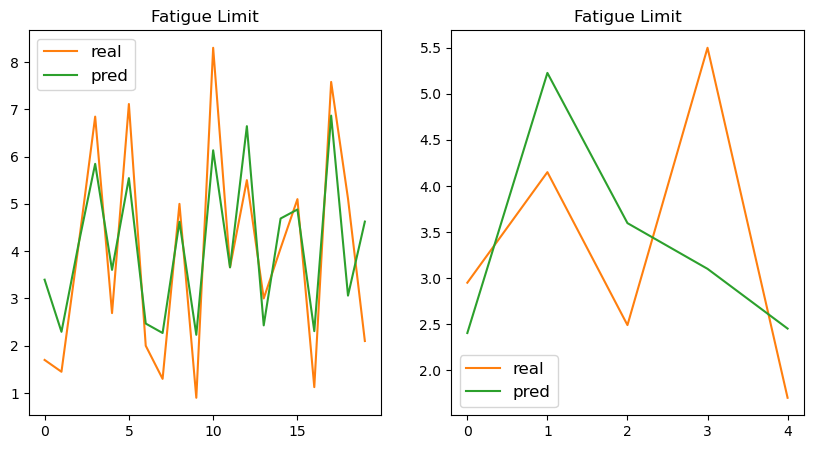

Epoch 491, loss: 15022.142578125
Train set
[7.1111107 0.9       3.66      8.3       1.7       4.09      6.8444448
 3.        1.45      4.06      5.501     2.69      5.        5.1
 5.111111  7.577778  1.125     2.        1.3       2.1      ]
[5.5393376 2.2164624 3.6507778 6.123027  3.3815484 4.115095  5.84925
 2.4225285 2.2796345 4.684705  6.6490726 3.599187  4.618937  4.8732014
 3.0534813 6.885383  2.2961617 2.461131  2.2581441 4.612744 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.397294  5.218595  3.5945082 3.0936935 2.446268 ]


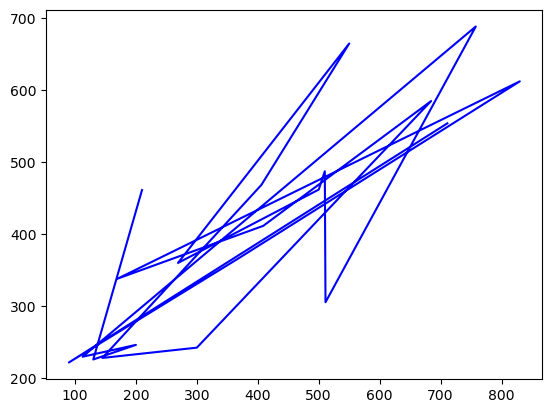

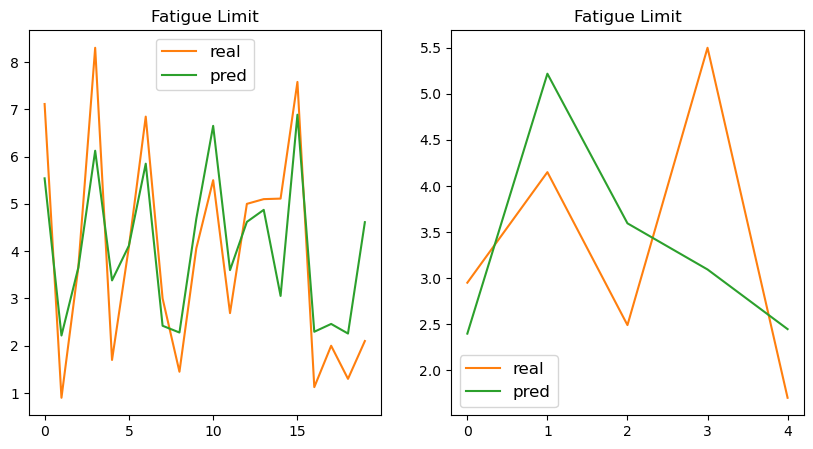

Epoch 501, loss: 14927.3486328125
Train set
[7.1111107 2.1       6.8444448 4.06      3.66      4.09      1.7
 5.1       7.577778  3.        5.501     1.3       2.69      0.9
 5.111111  2.        1.45      5.        8.3       1.125    ]
[5.541144  4.597086  5.8583302 4.6766057 3.6479135 4.1119337 3.3700914
 4.8707705 6.912086  2.4176683 6.6620727 2.2451496 3.598917  2.1993527
 3.0447521 2.456124  2.2674294 4.6225286 6.110409  2.2819276]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3917458 5.2131166 3.593213  3.090402  2.4413495]


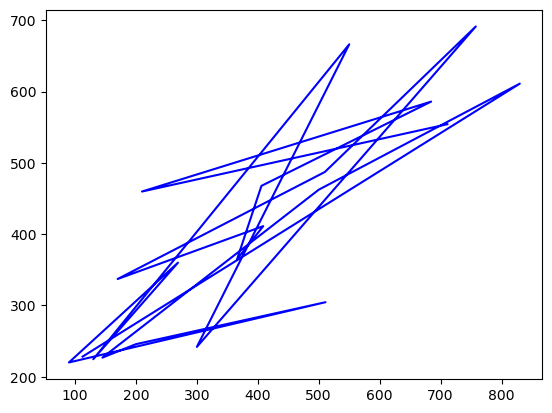

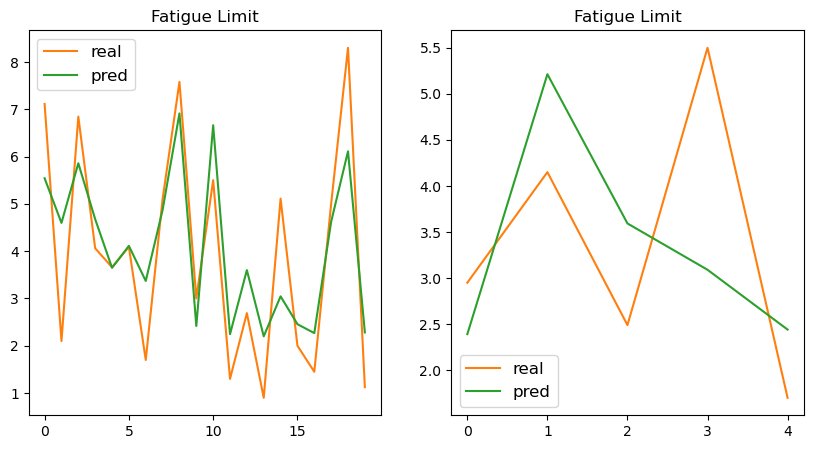

Epoch 511, loss: 14827.513671875
Train set
[6.8444448 5.        4.06      7.1111107 7.577778  4.09      5.111111
 1.45      1.7       3.66      2.        1.125     2.1       1.3
 5.501     3.        2.69      0.9       8.3       5.1      ]
[5.8849    4.6404715 4.6716304 5.560521  6.956947  4.109443  3.0383286
 2.2637892 3.369638  3.6455765 2.4597323 2.2687192 4.5835032 2.237144
 6.693737  2.4217215 3.6101813 2.183267  6.1019087 4.884098 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3920634 5.2094197 3.5994897 3.0828385 2.4423046]


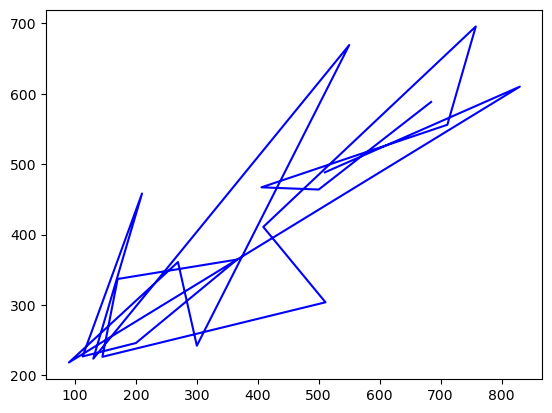

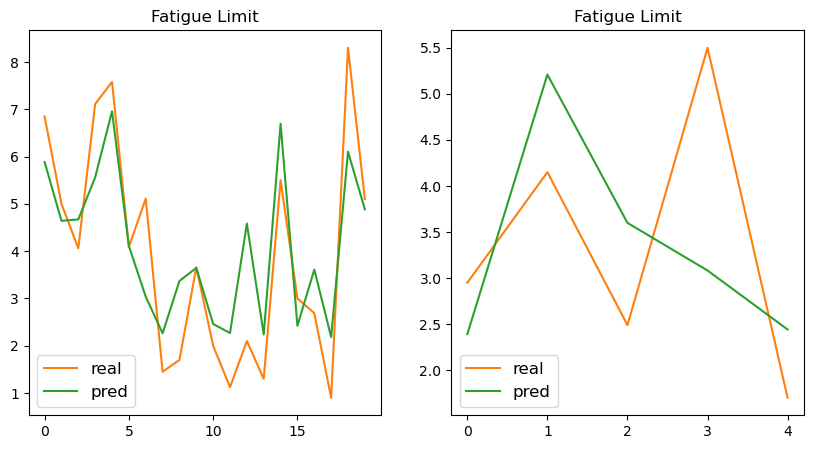

Epoch 521, loss: 14725.736328125
Train set
[1.45      2.69      4.09      1.7       6.8444448 5.1       7.1111107
 0.9       8.3       5.501     5.111111  1.125     1.3       7.577778
 4.06      3.        5.        2.        2.1       3.66     ]
[2.2542052 3.6162848 4.109785  3.363046  5.903627  4.890707  5.571972
 2.1724703 6.1094317 6.7174654 3.0402055 2.260948  2.2273035 6.9938397
 4.6788754 2.4204736 4.6515727 2.4591405 4.580722  3.6456559]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3907888 5.2202396 3.6055965 3.081765  2.4420784]


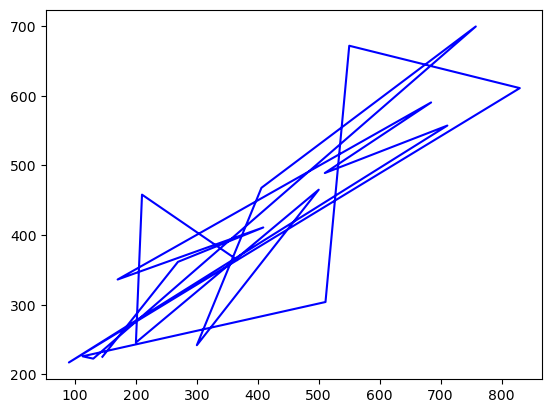

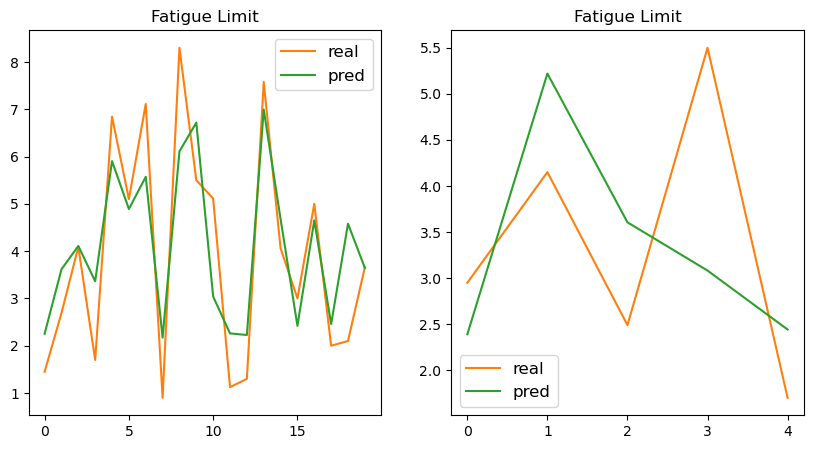

Epoch 531, loss: 14618.3359375
Train set
[1.45      5.501     5.111111  1.7       2.1       1.3       4.09
 2.69      5.        3.        0.9       7.577778  8.3       5.1
 2.        1.125     6.8444448 4.06      7.1111107 3.66     ]
[2.2384002 6.7246776 3.0308828 3.3468406 4.5604725 2.2116823 4.100471
 3.613244  4.6513104 2.413312  2.1522465 7.01479   6.094953  4.8846674
 2.4521096 2.2437944 5.908096  4.66946   5.5695477 3.6371076]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.385561  5.2140903 3.604997  3.0736628 2.437655 ]


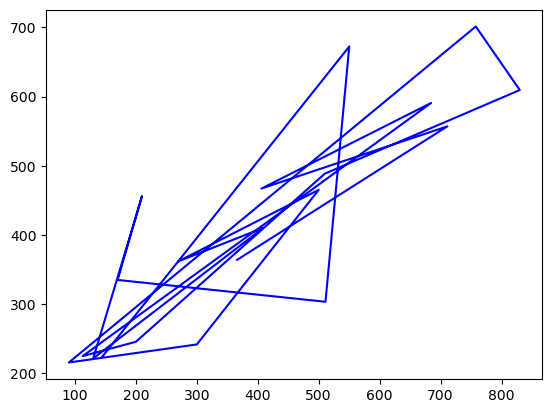

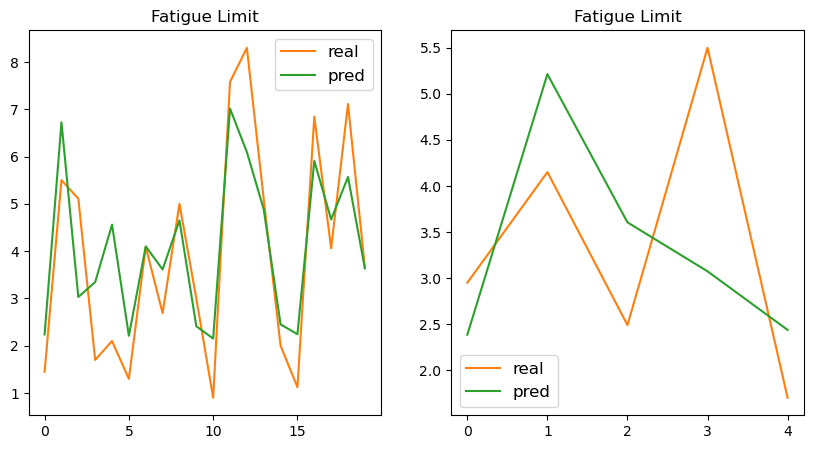

Epoch 541, loss: 14505.9873046875
Train set
[5.501     5.        6.8444448 4.06      5.111111  5.1       2.
 1.125     1.45      3.        3.66      7.577778  4.09      7.1111107
 1.7       8.3       0.9       2.1       2.69      1.3      ]
[6.742819  4.6599636 5.9233427 4.667708  3.026837  4.8878717 2.45031
 2.2295415 2.2279017 2.412143  3.6343114 7.0471387 4.0978003 5.577841
 3.3365366 6.0904956 2.1350608 4.5462675 3.6171503 2.2006779]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3841956 5.213368  3.6083198 3.0688095 2.4368699]


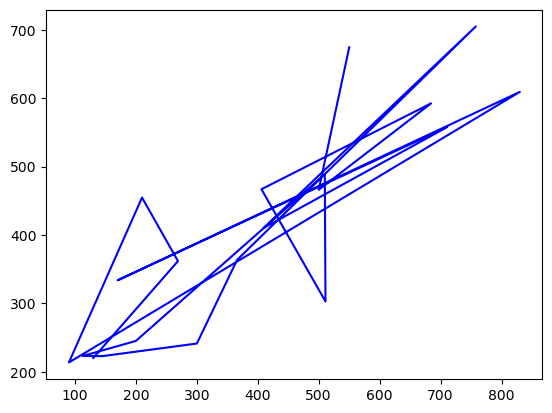

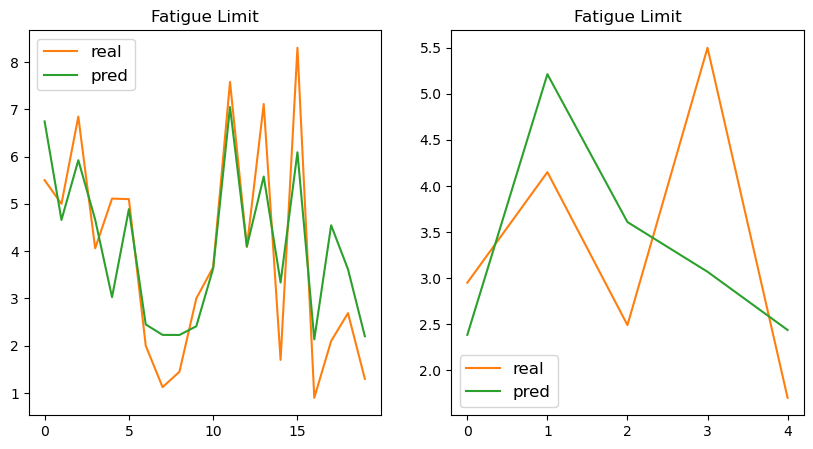

Epoch 551, loss: 14386.140625
Train set
[4.06      1.125     4.09      5.111111  2.        3.        2.1
 1.3       7.1111107 2.69      0.9       5.501     6.8444448 7.577778
 3.66      8.3       1.7       5.1       1.45      5.       ]
[4.6664357 2.2145913 4.096383  3.0234396 2.4476366 2.4110234 4.5309854
 2.1893287 5.5836964 3.619386  2.116633  6.75666   5.935839  7.0757647
 3.6324942 6.0866814 3.3236892 4.8885264 2.2168794 4.6667013]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3815343 5.2104793 3.608105  3.0629253 2.4344718]


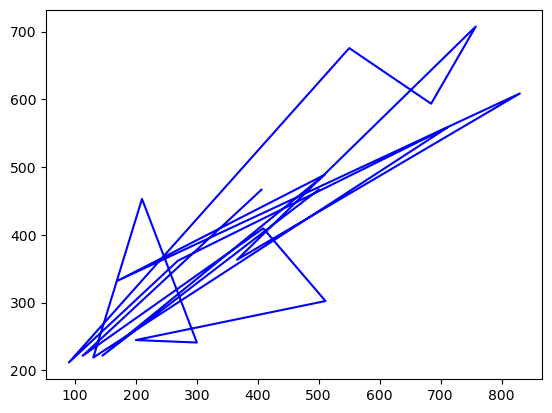

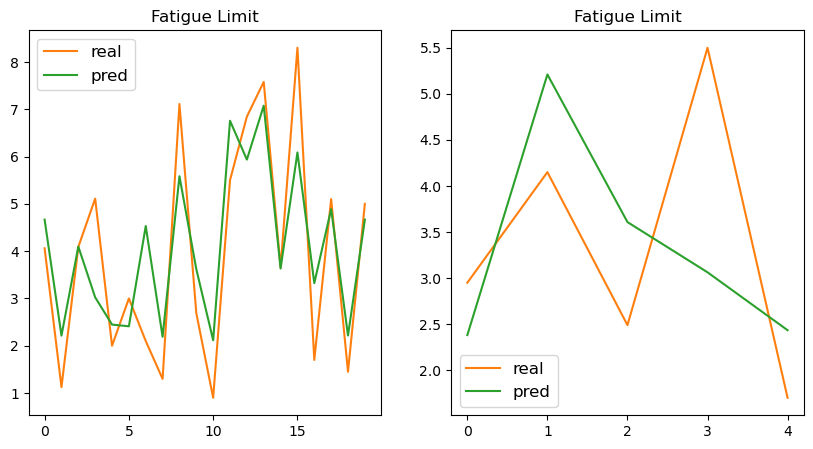

Epoch 561, loss: 14255.357421875
Train set
[7.1111107 2.        7.577778  3.66      2.69      8.3       2.1
 4.09      1.3       0.9       1.7       1.45      3.        4.06
 6.8444448 5.111111  5.501     1.125     5.        5.1      ]
[5.586469  2.4433439 7.101739  3.6345797 3.619458  6.0855894 4.5160255
 4.099511  2.176522  2.0979707 3.3072195 2.2039728 2.4089777 4.6673517
 5.9454436 3.0214758 6.766514  2.1992598 4.671094  4.885893 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3784075 5.213021  3.6064112 3.0615652 2.431437 ]


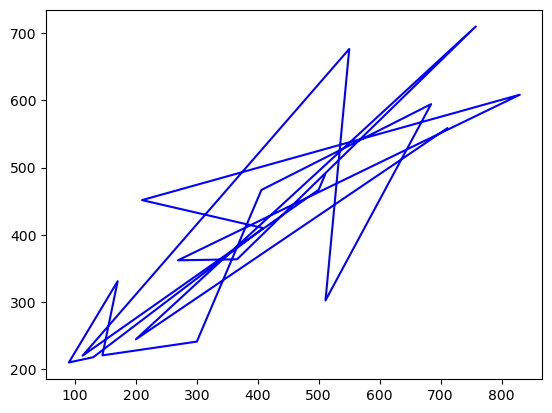

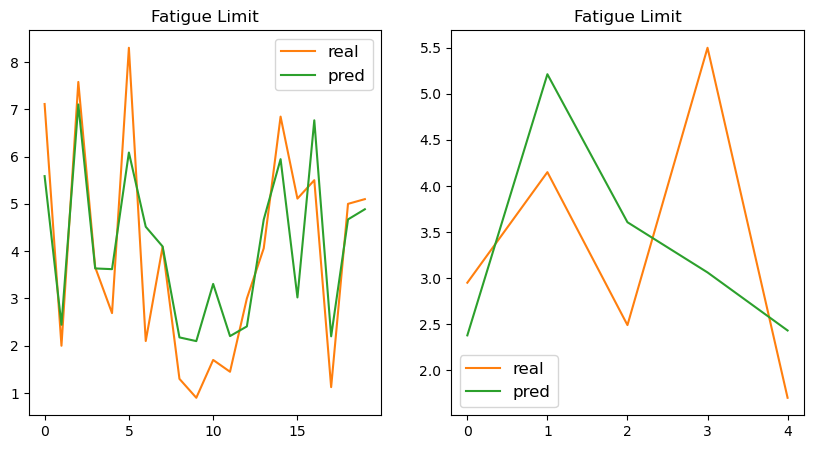

Epoch 571, loss: 14113.025390625
Train set
[1.7       1.45      6.8444448 5.1       2.1       5.501     5.111111
 3.        1.3       1.125     2.69      2.        4.06      7.1111107
 3.66      0.9       5.        7.577778  4.09      8.3      ]
[3.2882428 2.1907625 5.953623  4.8813305 4.497533  6.7733936 3.0186822
 2.4075646 2.1628056 2.1816328 3.6184487 2.438481  4.666701  5.5878315
 3.6336548 2.0767481 4.6745734 7.1260595 4.099358  6.082363 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3779328 5.2149396 3.6061945 3.0578725 2.4306593]


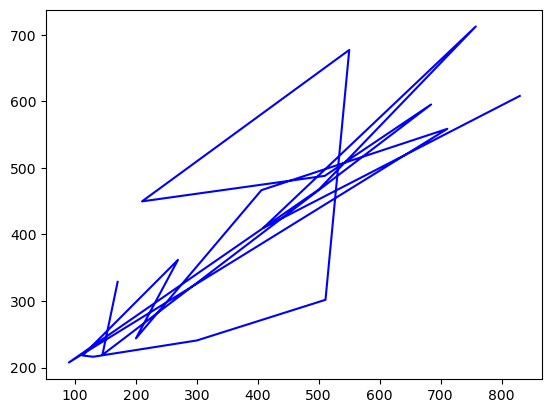

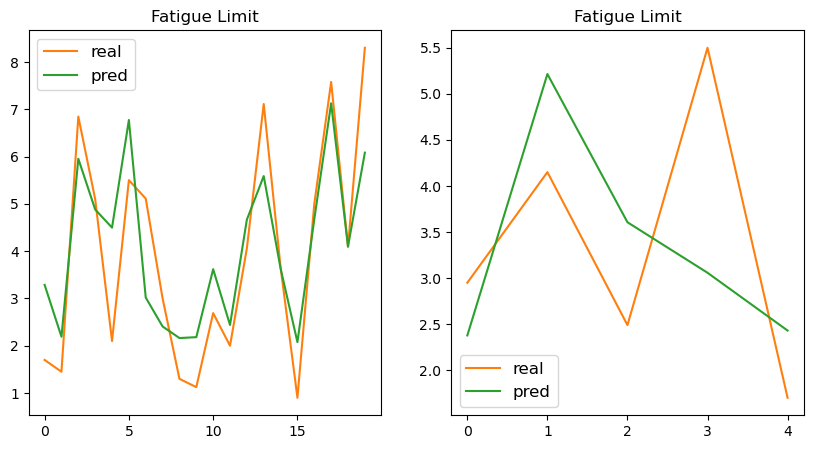

Epoch 581, loss: 13956.203125
Train set
[7.1111107 4.09      8.3       1.3       2.1       2.69      4.06
 5.501     5.1       6.8444448 5.111111  1.7       0.9       1.125
 5.        3.        3.66      2.        1.45      7.577778 ]
[5.589591  4.108799  6.092218  2.1519501 4.4863815 3.6174753 4.676158
 6.780661  4.876367  5.9628234 3.0226455 3.2669318 2.0588684 2.1669695
 4.678659  2.4065719 3.6410842 2.4333303 2.1764174 7.1528554]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3778405 5.2286816 3.6058347 3.0628898 2.4301183]


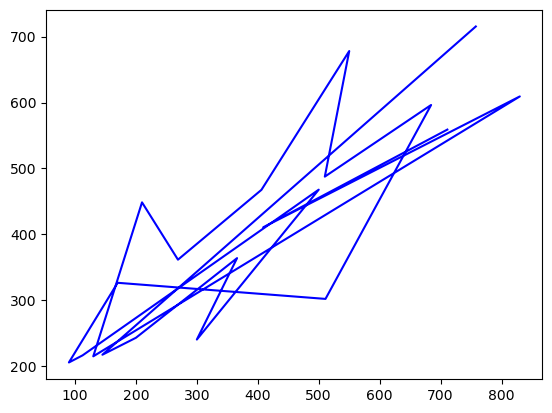

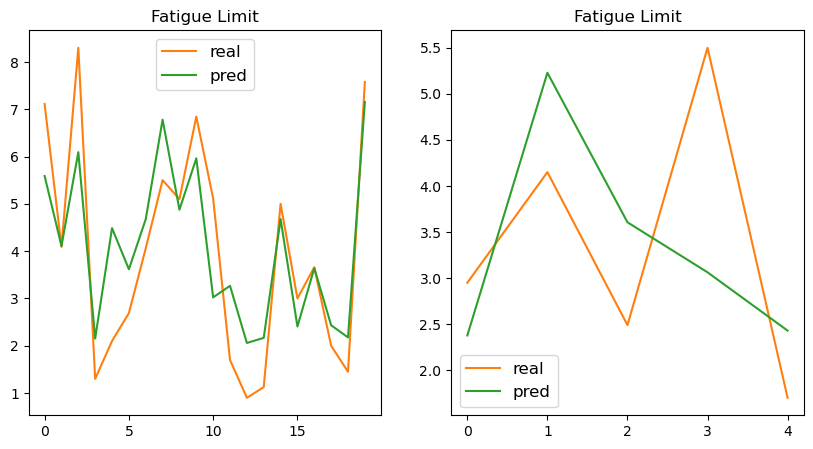

Epoch 591, loss: 13772.7685546875
Train set
[5.501     4.09      3.        2.        7.1111107 0.9       4.06
 8.3       2.69      1.45      5.111111  5.1       7.577778  6.8444448
 2.1       1.125     3.66      5.        1.3       1.7      ]
[6.78145   4.1050606 2.4060082 2.427155  5.588205  2.0291805 4.6738853
 6.086048  3.6143723 2.1607544 3.0187097 4.8680677 7.1742415 5.968308
 4.4597163 2.1425462 3.639769  4.6801567 2.133773  3.2408319]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.375367  5.228553  3.599669  3.0588336 2.4267218]


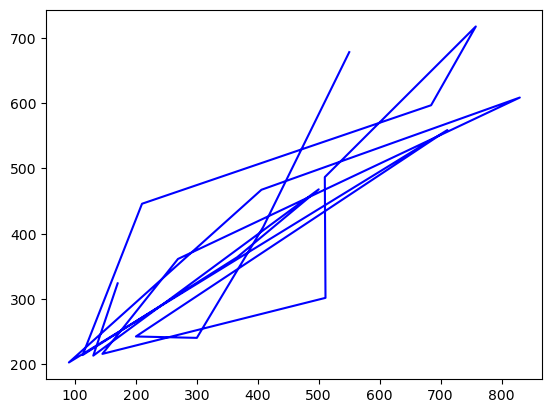

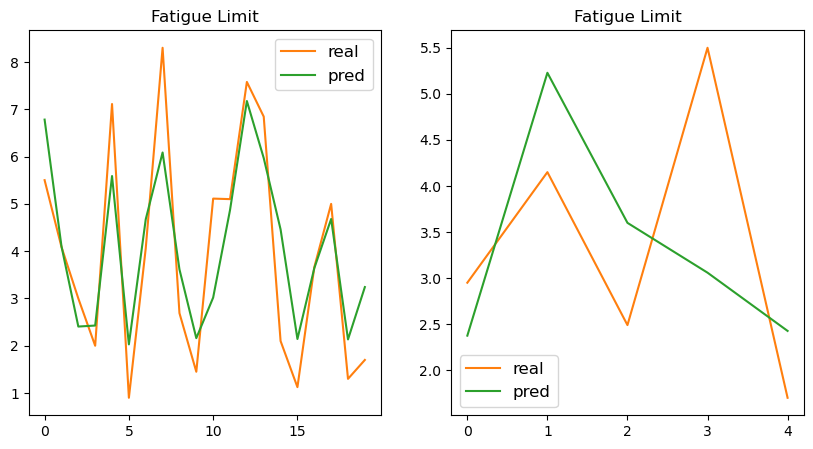

Epoch 601, loss: 13564.9970703125
Train set
[3.66      5.        1.125     1.3       7.1111107 2.        5.1
 0.9       7.577778  2.1       5.501     4.09      2.69      3.
 1.7       5.111111  1.45      4.06      6.8444448 8.3      ]
[3.6527305 4.6918645 2.122262  2.12073   5.5980186 2.4247427 4.867796
 2.004721  7.215609  4.443928  6.7968125 4.120545  3.617994  2.4105065
 3.2168558 3.0248191 2.1471322 4.6867876 5.9874372 6.099546 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3825386 5.2485104 3.6061935 3.0675623 2.4327822]


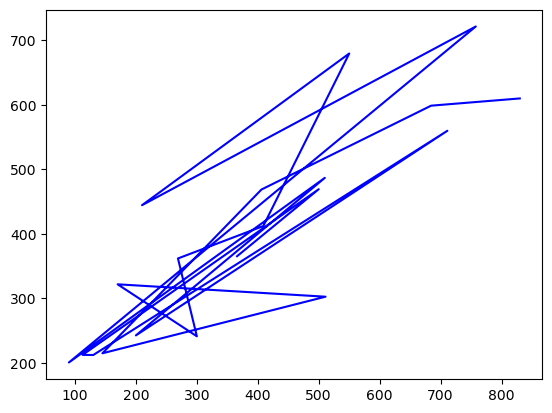

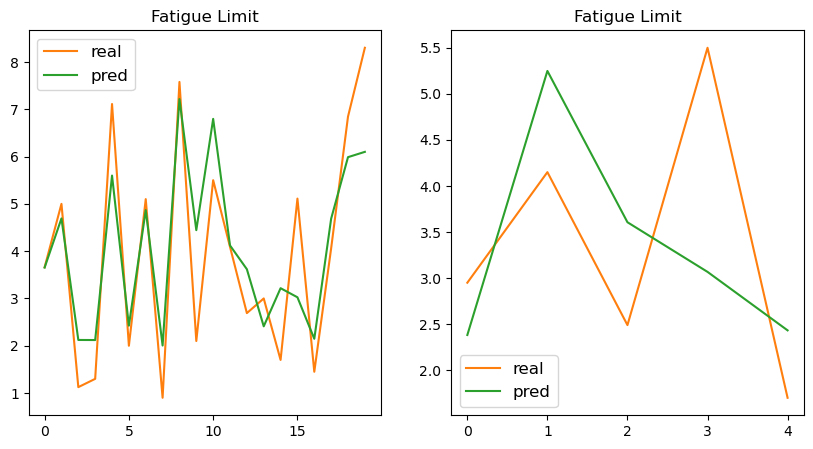

Epoch 611, loss: 13318.568359375
Train set
[1.125     6.8444448 4.06      5.        1.3       4.09      7.1111107
 3.        2.69      3.66      1.45      2.        0.9       8.3
 7.577778  5.501     1.7       2.1       5.1       5.111111 ]
[2.090932  5.997257  4.6878834 4.696135  2.099039  4.125737  5.598313
 2.4122972 3.6150198 3.6567538 2.1276875 2.4201293 1.967797  6.0971837
 7.2474794 6.799098  3.1815372 4.410185  4.857594  3.0237038]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3841507 5.2566633 3.6023993 3.0668063 2.4327886]


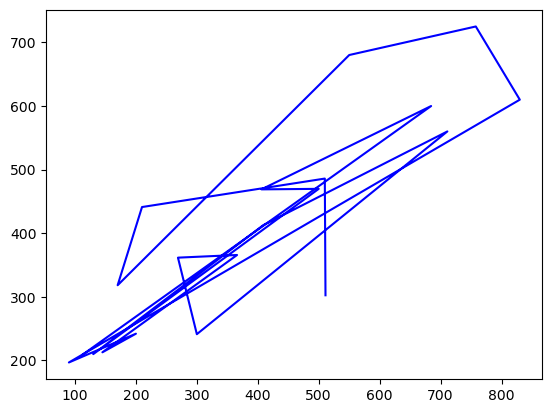

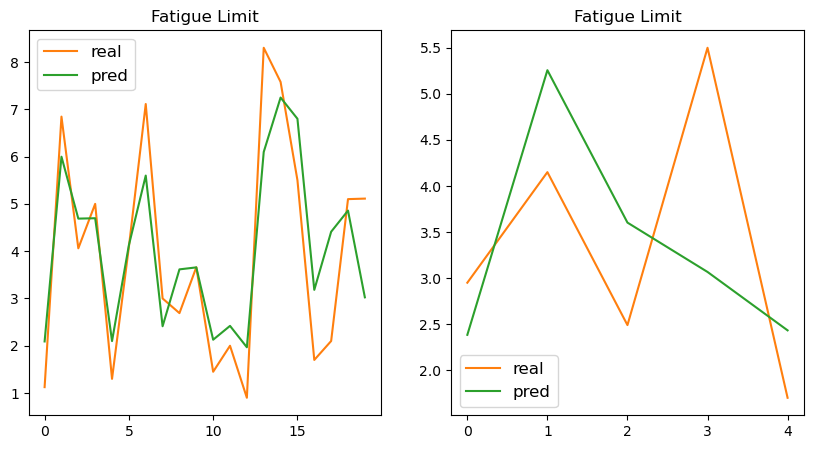

Epoch 621, loss: 13030.8857421875
Train set
[5.501     5.111111  0.9       7.1111107 2.69      8.3       2.1
 1.45      4.06      1.3       7.577778  3.        4.09      3.66
 6.8444448 1.7       2.        5.        5.1       1.125    ]
[6.7929573 3.0242422 1.9232374 5.5946183 3.6093042 6.0936894 4.3670077
 2.1037922 4.6881237 2.0746236 7.2733393 2.4140122 4.132717  3.661097
 6.0026217 3.1417868 2.4146678 4.6970854 4.8429465 2.0531533]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.39324   5.2659273 3.6056075 3.0659497 2.4401357]


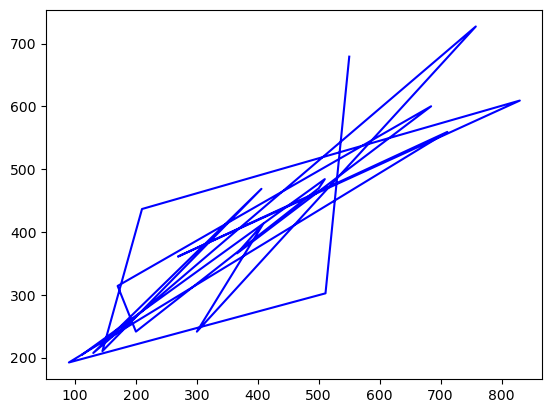

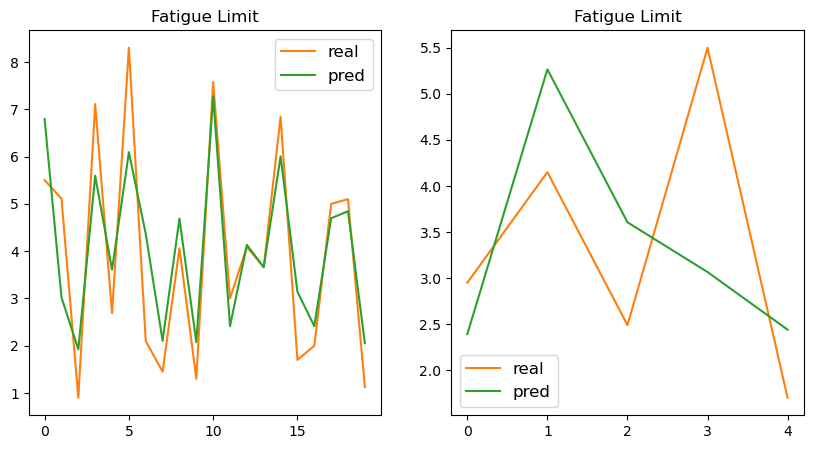

Epoch 631, loss: 12675.7470703125
Train set
[6.8444448 5.        1.3       1.7       7.577778  5.111111  5.1
 2.1       0.9       4.06      1.125     1.45      3.        4.09
 8.3       5.501     2.69      7.1111107 3.66      2.       ]
[6.0363684 4.720576  2.0580816 3.102259  7.330042  3.030533  4.85235
 4.3175197 1.8750811 4.694873  2.0097759 2.0875788 2.4284496 4.144448
 6.0983925 6.8149767 3.6214309 5.6188107 3.6690109 2.4116752]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.3892906 5.2498627 3.5913064 3.0583432 2.4343548]


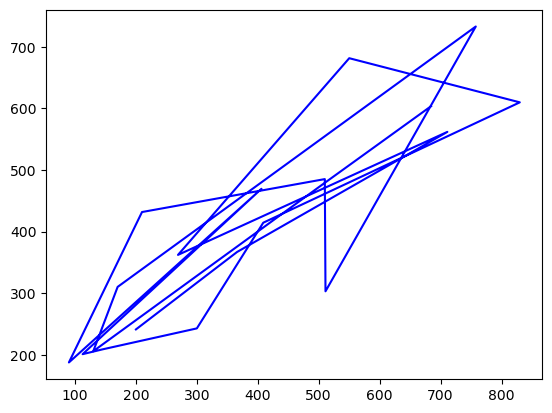

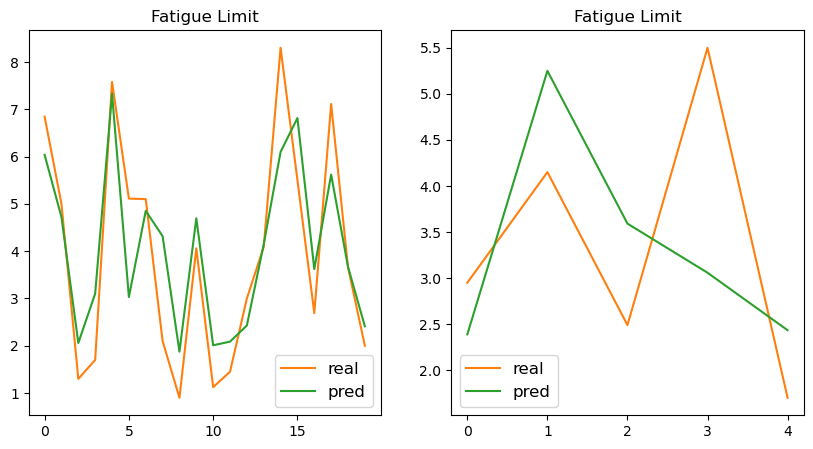

Epoch 641, loss: 12251.203125
Train set
[2.        4.06      4.09      1.45      5.501     1.125     6.8444448
 2.69      3.66      7.1111107 1.3       7.577778  1.7       5.1
 2.1       5.        5.111111  0.9       3.        8.3      ]
[2.4210315 4.726495  4.20958   2.0735357 6.8434486 1.968906  6.0814013
 3.6403341 3.72306   5.6542573 2.0436933 7.3977776 3.064321  4.8700633
 4.2758656 4.7530317 3.0586174 1.8287191 2.452299  6.1363506]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.427874  5.30452   3.6279893 3.1024253 2.4706273]


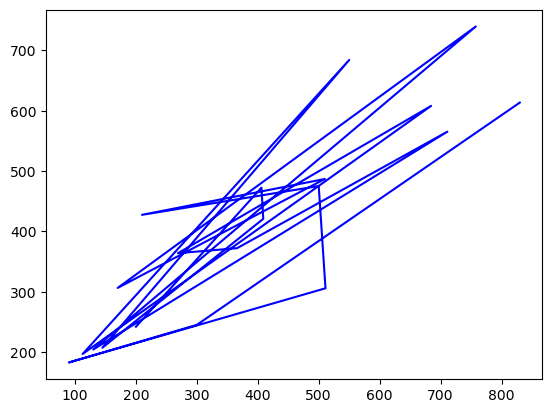

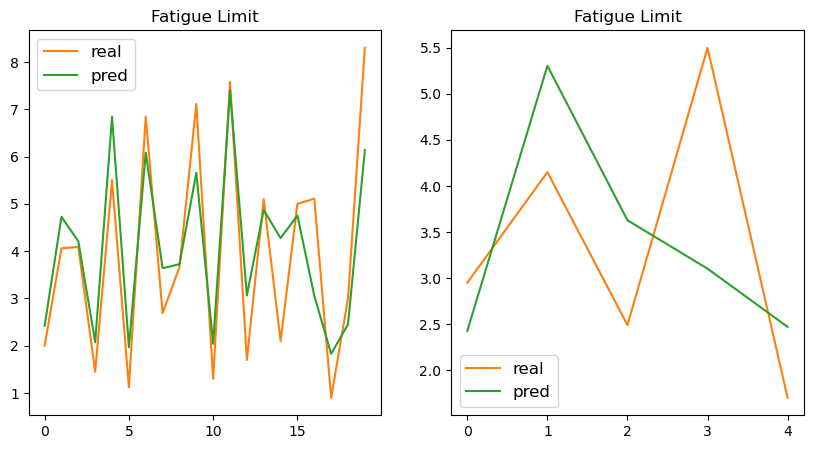

Epoch 651, loss: 11719.0361328125
Train set
[2.69      0.9       7.1111107 5.111111  5.        2.        4.09
 3.66      1.125     5.1       8.3       5.501     7.577778  1.3
 2.1       6.8444448 1.45      4.06      1.7       3.       ]
[3.6050346 1.7320888 5.6075683 3.0409636 4.718251  2.3930242 4.2026963
 3.7127082 1.8739642 4.811423  6.07218   6.7638454 7.3620715 1.9904785
 4.135317  6.039827  2.0203278 4.679878  2.9573321 2.4458103]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4296122 5.2869024 3.600686  3.1105824 2.4678733]


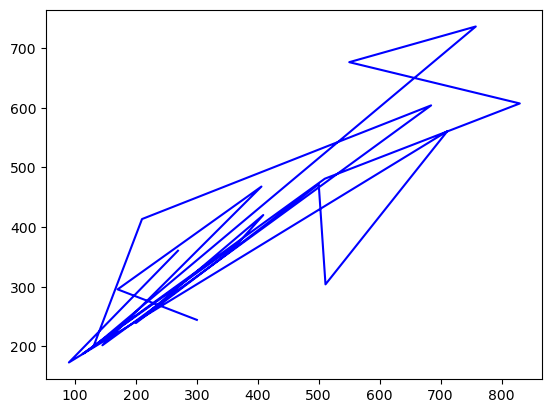

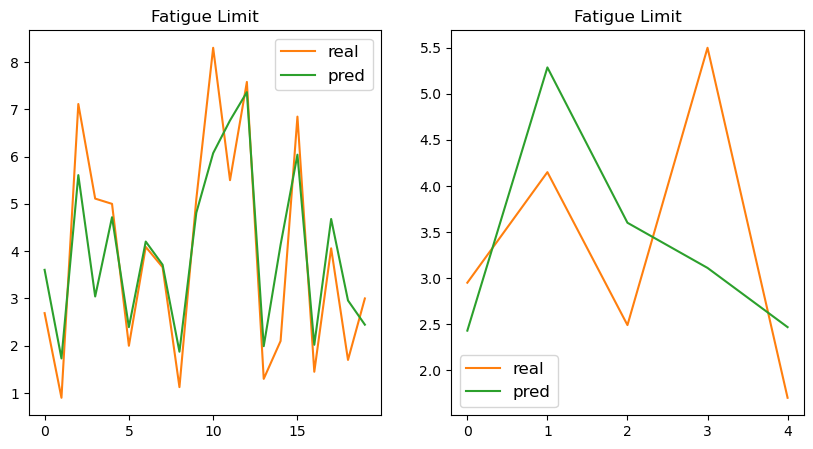

Epoch 661, loss: 11025.59765625
Train set
[0.9       5.        3.        7.1111107 5.501     5.1       2.69
 5.111111  3.66      1.125     2.1       1.45      1.7       4.06
 2.        6.8444448 1.3       8.3       4.09      7.577778 ]
[1.6550864 4.7474537 2.484257  5.636193  6.7560635 4.8118205 3.6165245
 3.095156  3.790828  1.803379  4.050403  1.9950707 2.8844612 4.724743
 2.400947  6.076671  1.9649533 6.129541  4.2966924 7.4171534]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.4600227 5.34246   3.59664   3.1740394 2.4912806]


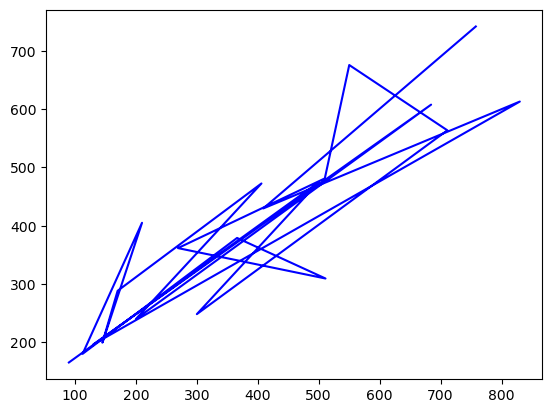

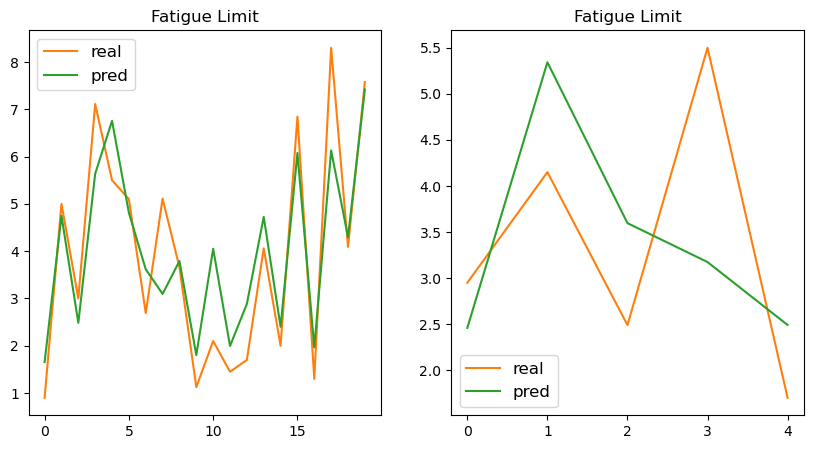

Epoch 671, loss: 10098.4814453125
Train set
[3.        1.7       0.9       5.501     5.        6.8444448 5.1
 1.45      7.1111107 1.125     2.69      1.3       4.06      8.3
 2.        3.66      4.09      7.577778  5.111111  2.1      ]
[2.5429308 2.7592726 1.5361136 6.7241235 4.7802205 6.115853  4.8013573
 1.9607551 5.6658907 1.6852363 3.6263871 1.9303255 4.755855  6.170727
 2.407211  3.8492439 4.3677616 7.467555  3.1533954 3.893837 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.5290558 5.383373  3.6118357 3.245261  2.54818  ]


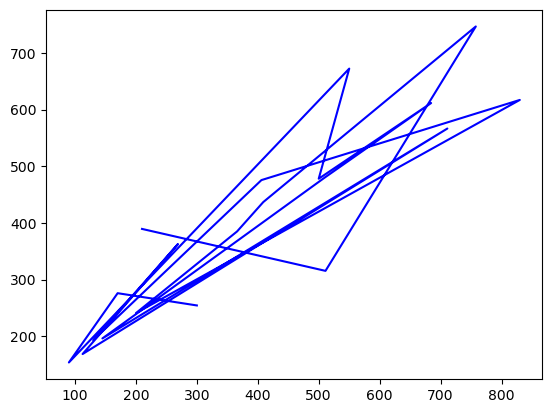

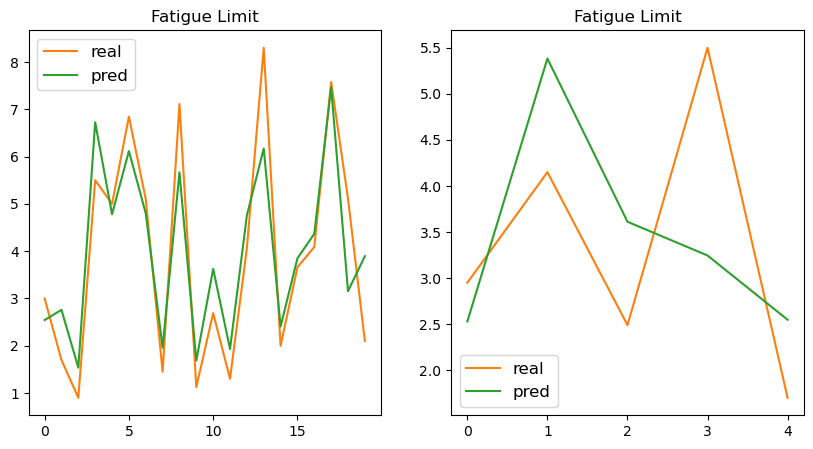

Epoch 681, loss: 8871.669921875
Train set
[1.45      4.09      2.        6.8444448 7.577778  3.        1.3
 3.66      5.        2.1       1.125     7.1111107 0.9       2.69
 5.501     8.3       4.06      1.7       5.1       5.111111 ]
[1.9297146 4.5184126 2.428705  6.1787276 7.5328417 2.6475685 1.8990312
 3.981479  4.8378963 3.6722143 1.5213478 5.719899  1.3794688 3.64541
 6.6710415 6.252432  4.8130426 2.5838394 4.7905025 3.273903 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.634035  5.483477  3.6182833 3.3964822 2.6325097]


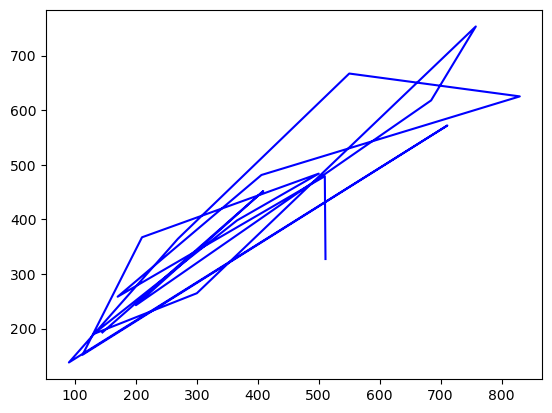

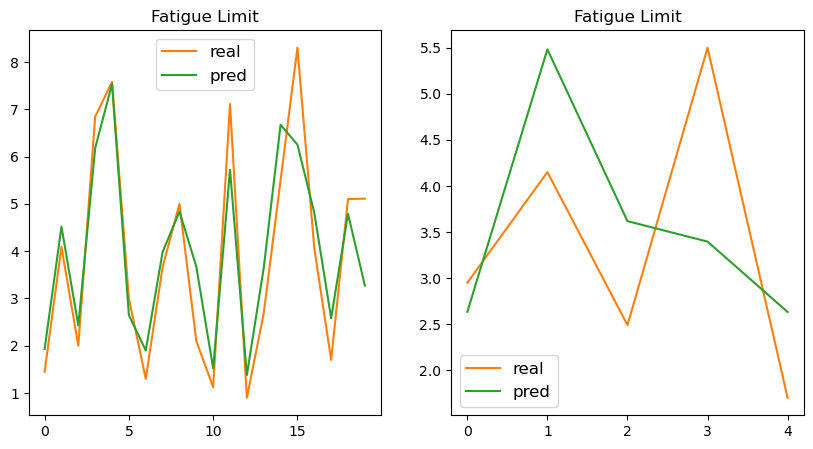

Epoch 691, loss: 7416.4140625
Train set
[1.125     2.1       5.        1.7       5.111111  2.        7.1111107
 8.3       3.        5.1       6.8444448 2.69      5.501     3.66
 4.06      0.9       1.3       4.09      7.577778  1.45     ]
[1.2766522 3.3169966 4.880327  2.3107147 3.3955228 2.4396927 5.7434254
 6.2943935 2.7862475 4.72855   6.2132354 3.6391408 6.518227  3.947693
 4.8305664 1.157658  1.8557942 4.47827   7.5454564 1.886484 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.837698  5.5677276 3.696872  3.5588381 2.8127532]


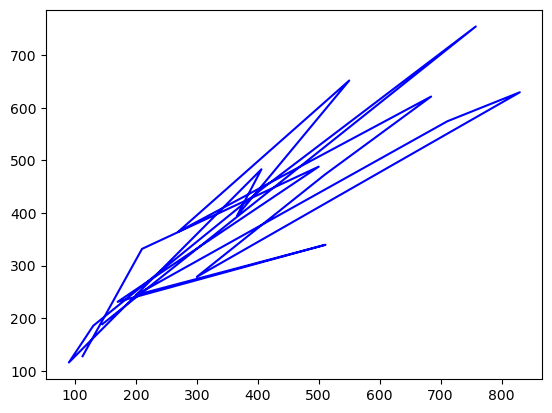

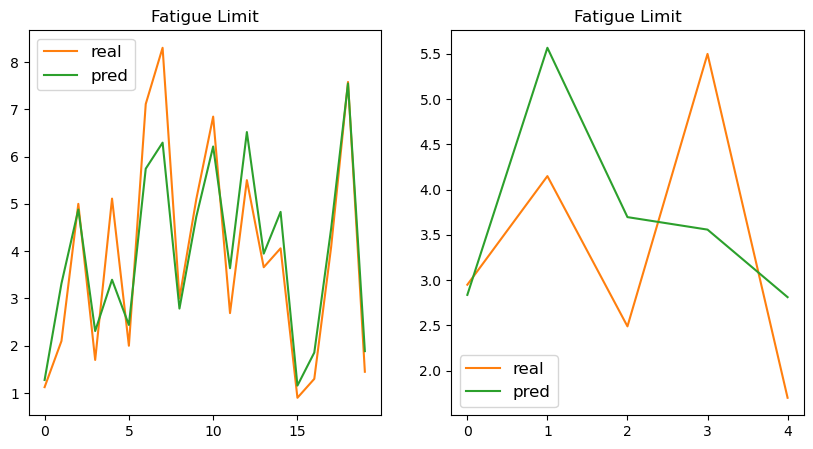

Epoch 701, loss: 6070.12646484375
Train set
[7.577778  2.        7.1111107 5.        0.9       3.        3.66
 8.3       2.1       1.125     1.7       4.09      5.501     5.1
 4.06      2.69      1.45      1.3       5.111111  6.8444448]
[7.582493  2.4861243 5.788655  4.941716  0.9488436 2.9617057 3.9468398
 6.403466  2.9501944 1.0513659 2.0328774 4.457919  6.3299193 4.6702795
 4.8883553 3.6432626 1.8640404 1.8503852 3.62428   6.2591553]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.0156422 5.736771  3.732447  3.7978845 2.9769175]


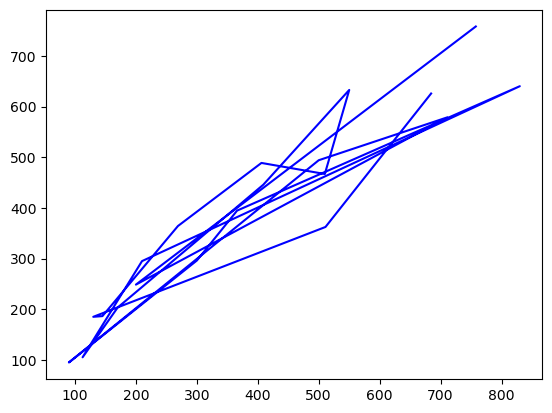

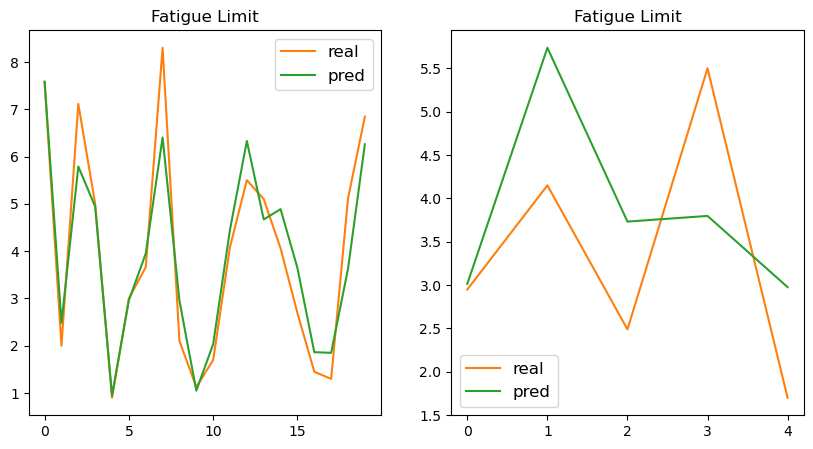

Epoch 711, loss: 5035.88525390625
Train set
[8.3       7.577778  1.7       5.1       2.1       3.        4.06
 5.501     5.111111  5.        4.09      2.69      2.        3.66
 7.1111107 1.45      0.9       6.8444448 1.3       1.125    ]
[6.6175365 7.68296   1.8351338 4.709801  2.6846125 3.1613798 5.0147295
 6.2388806 3.874526  5.0707445 4.362972  3.7113256 2.574032  3.8877265
 5.9263697 1.8925396 0.8257378 6.385021  1.888004  0.9230355]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.2076745 5.763693  3.7725053 3.9060755 3.1468933]


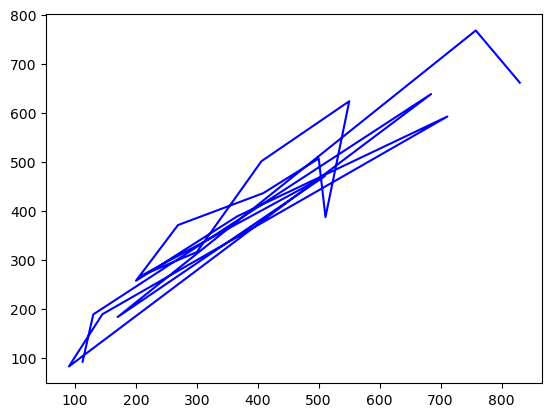

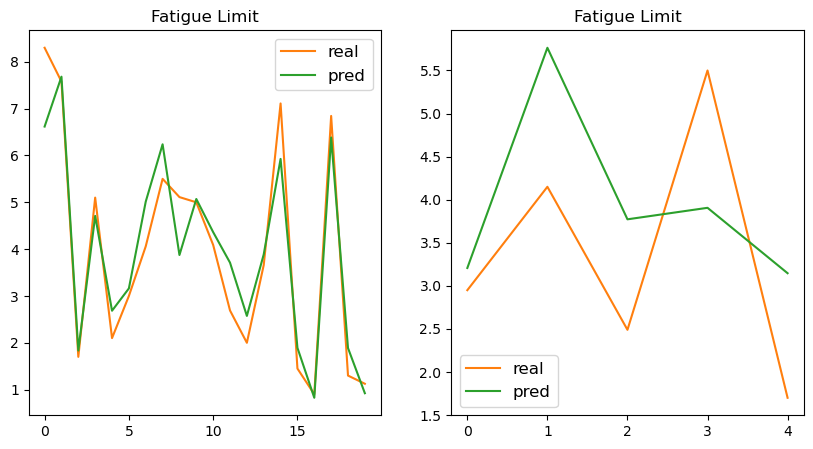

Epoch 721, loss: 4530.31298828125
Train set
[7.577778  5.1       0.9       4.06      5.111111  6.8444448 3.66
 7.1111107 3.        1.45      1.3       1.7       2.        5.
 4.09      2.69      5.501     2.1       1.125     8.3      ]
[7.5823913  4.651931   0.7412172  5.020425   4.0310125  6.3384233
 3.727308   5.916402   3.289695   1.8733859  1.8716867  1.6776009
 2.6204193  5.0590954  4.1537     3.690663   5.9889293  2.4721508
 0.82123977 6.6861424 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.3605824 5.898375  3.8057919 4.0849853 3.2918901]


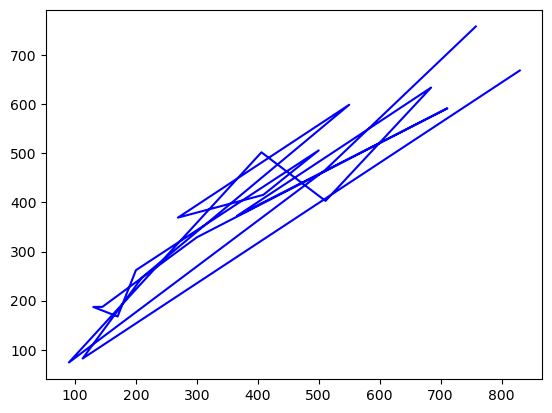

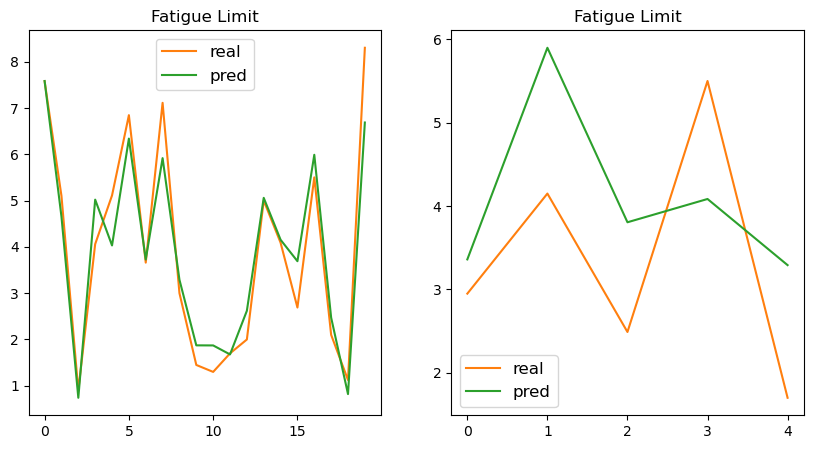

Epoch 731, loss: 3986.337158203125
Train set
[1.125     6.8444448 2.1       5.111111  3.        4.09      8.3
 2.69      2.        4.06      5.1       5.        1.45      3.66
 1.3       7.1111107 7.577778  0.9       1.7       5.501    ]
[0.7728216 6.4750385 2.315526  4.250716  3.4007142 4.132897  7.0018706
 3.796669  2.7003596 5.232727  4.789051  5.1847258 1.8686478 3.7172666
 1.8687961 6.0903087 7.644523  0.7005612 1.5489075 5.9963875]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4073226 5.8362584 3.7902005 4.0511556 3.3496733]


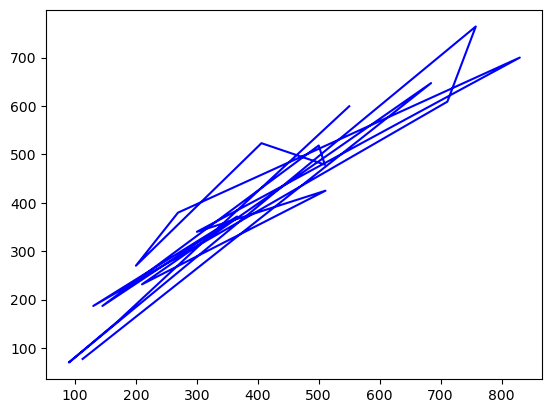

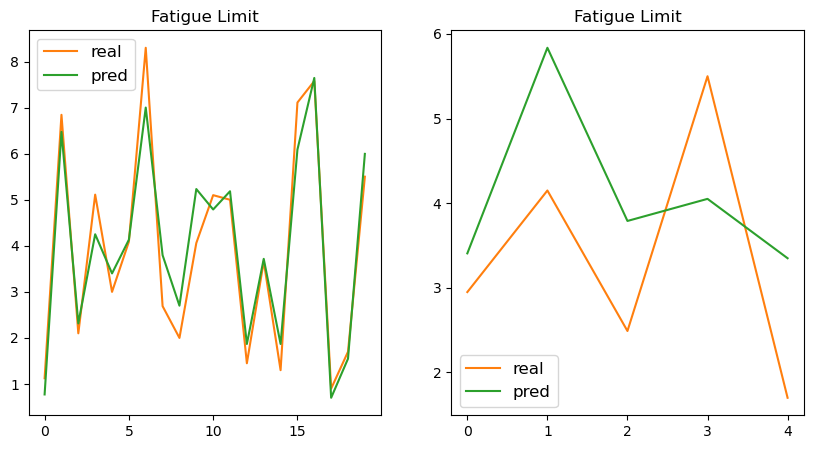

Epoch 741, loss: 3831.40869140625
Train set
[1.3       3.        2.69      8.3       3.66      1.125     1.7
 4.06      2.        1.45      5.501     4.09      0.9       2.1
 5.111111  5.1       5.        7.1111107 7.577778  6.8444448]
[1.8489716 3.508487  3.9108427 7.2189727 3.7681167 0.8818262 1.6471692
 5.379235  2.7648978 1.8641312 6.0784235 4.1923203 0.7877688 2.4557538
 4.407201  4.9549236 5.3063774 6.2696548 7.7290983 6.6234245]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4257233 5.829357  3.7091458 4.0432625 3.3328454]


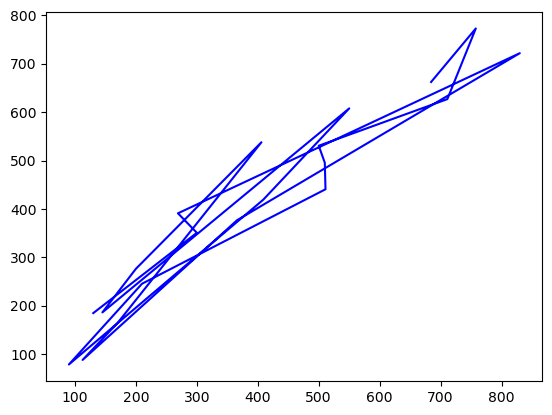

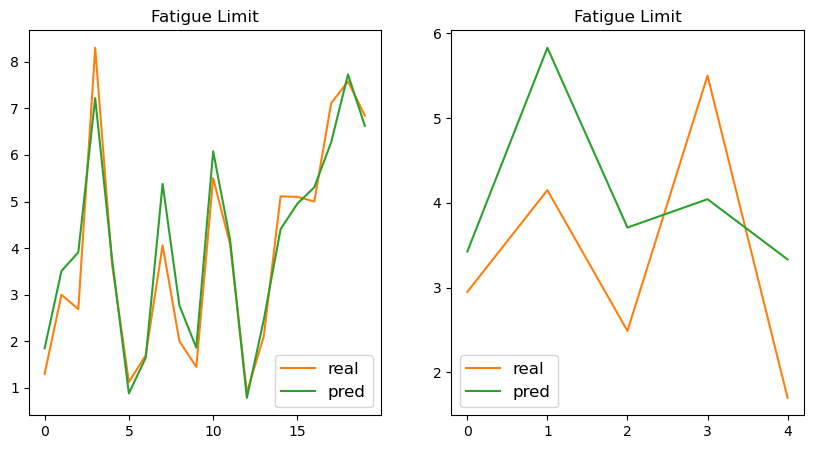

Epoch 751, loss: 3647.705078125
Train set
[5.111111  5.1       4.09      0.9       5.        1.125     1.3
 8.3       5.501     2.1       4.06      3.        1.45      2.
 6.8444448 7.577778  1.7       7.1111107 2.69      3.66     ]
[4.4498005  4.927818   4.2290187  0.75084853 5.249398   0.84730613
 1.7527275  7.3475237  5.9520698  2.374035   5.485701   3.4957566
 1.7481068  2.7554765  6.560682   7.661      1.5777239  6.2307463
 3.881658   3.8059912 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.3972921 5.823632  3.6759295 4.036497  3.3141723]


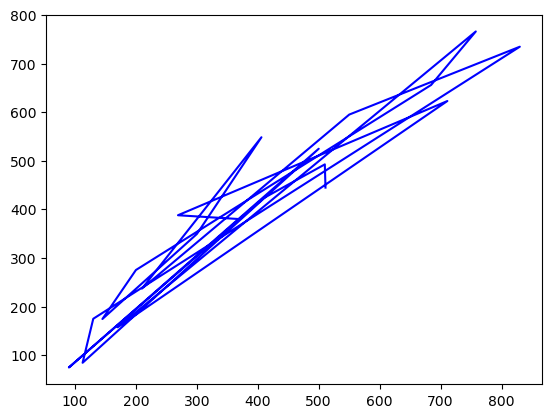

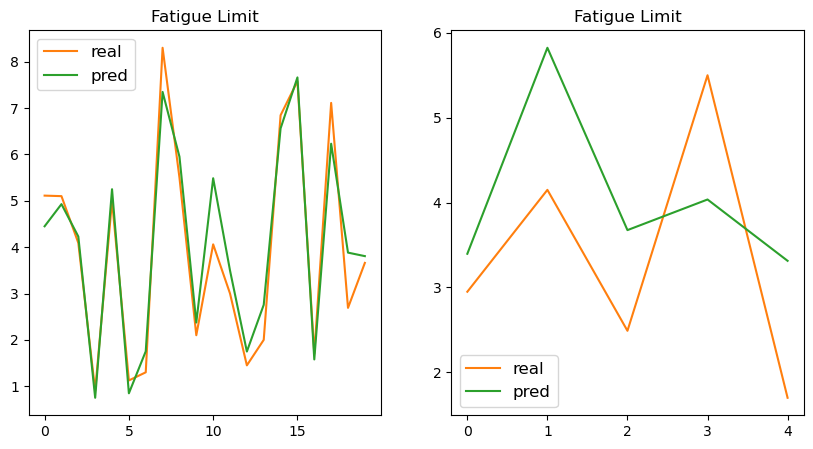

Epoch 761, loss: 3418.46435546875
Train set
[2.        4.09      5.501     2.1       3.        2.69      8.3
 5.111111  1.125     1.3       1.7       3.66      5.        7.1111107
 5.1       4.06      1.45      6.8444448 0.9       7.577778 ]
[2.692763   4.0630493  5.7580585  2.348187   3.4404318  3.808039
 7.1956525  4.422807   0.8168229  1.613787   1.5448452  3.6594164
 5.1405697  6.1249566  4.838381   5.3203607  1.6088588  6.4326777
 0.72764975 7.5851383 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4337986 5.862671  3.755018  4.103795  3.381763 ]


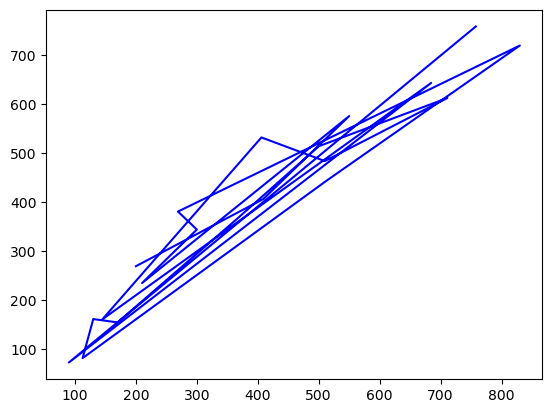

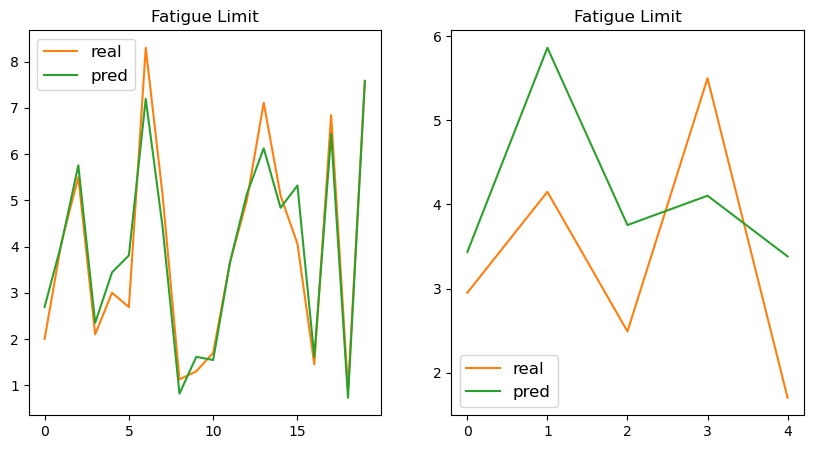

Epoch 771, loss: 3305.302001953125
Train set
[1.7       4.09      3.66      7.577778  3.        1.125     1.45
 6.8444448 2.1       5.111111  4.06      2.        8.3       5.1
 5.        5.501     0.9       7.1111107 1.3       2.69     ]
[1.5184016  4.079566   3.6736054  7.6923614  3.4779913  0.81823057
 1.5844319  6.4800367  2.319308   4.4943895  5.3753605  2.7062898
 7.3035145  4.897222   5.176732   5.7667212  0.73009515 6.1892896
 1.5898292  3.8453033 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4628286 5.94302   3.7737863 4.2018065 3.4081368]


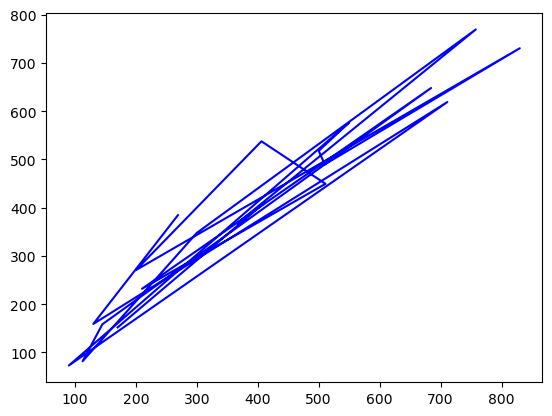

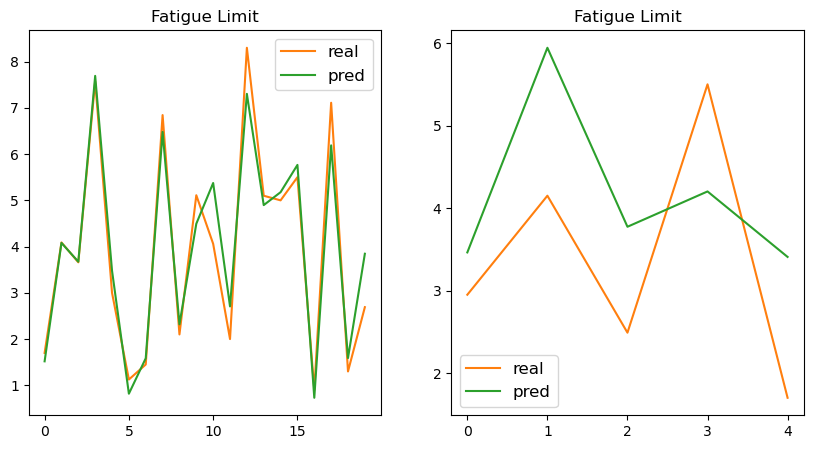

Epoch 781, loss: 3249.62548828125
Train set
[7.577778  5.111111  1.45      1.125     4.09      5.        7.1111107
 0.9       1.7       4.06      3.66      8.3       5.1       2.69
 1.3       5.501     3.        2.        2.1       6.8444448]
[7.780367   4.5852556  1.5955229  0.83988327 4.0900297  5.2316594
 6.2711363  0.7408828  1.519242   5.412711   3.6831472  7.3925714
 4.9695826  3.8937697  1.6006678  5.7950206  3.518279   2.7434797
 2.338676   6.549572  ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4029922 5.778738  3.6778917 4.1553173 3.3491416]


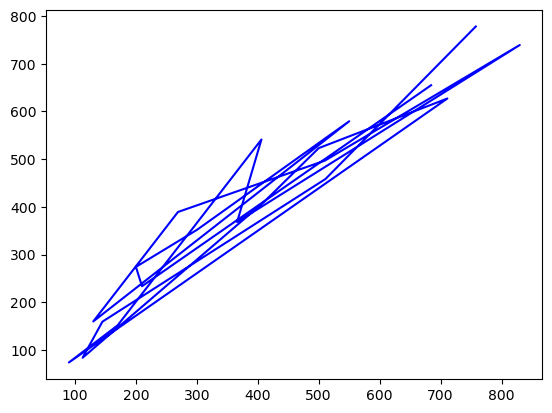

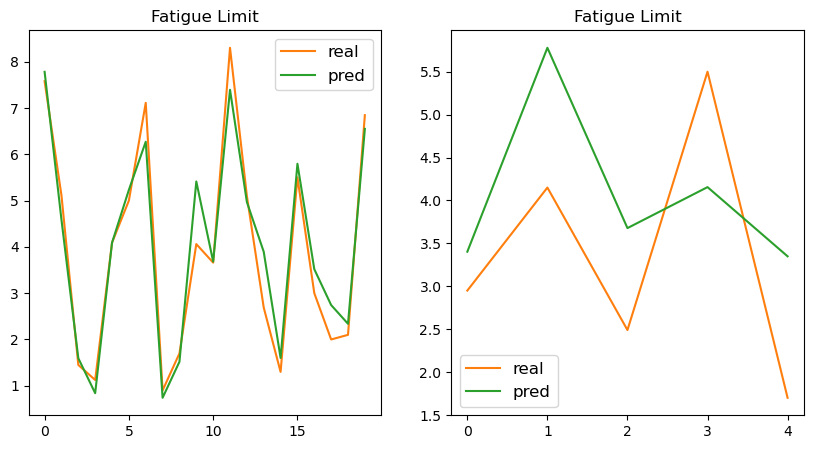

Epoch 791, loss: 3207.024169921875
Train set
[8.3       2.69      5.        5.501     5.1       1.45      1.7
 3.66      0.9       1.3       3.        1.125     2.        2.1
 4.06      4.09      6.8444448 5.111111  7.1111107 7.577778 ]
[7.209477   3.7665136  5.064659   5.5614257  4.8046675  1.5500996
 1.4449425  3.608245   0.7107634  1.5560459  3.4215207  0.80550903
 2.6731014  2.229741   5.243569   4.006179   6.3448777  4.5401692
 6.0832715  7.530437  ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4924634 5.998836  3.8099756 4.351345  3.4508874]


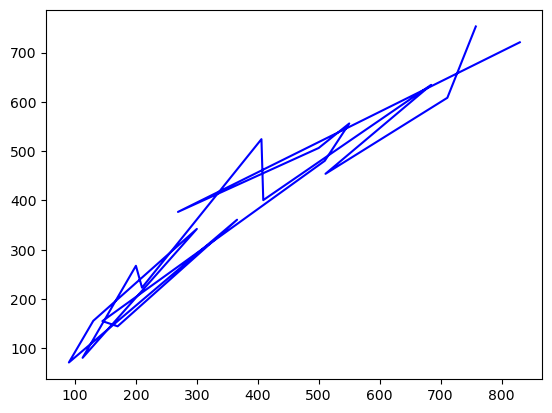

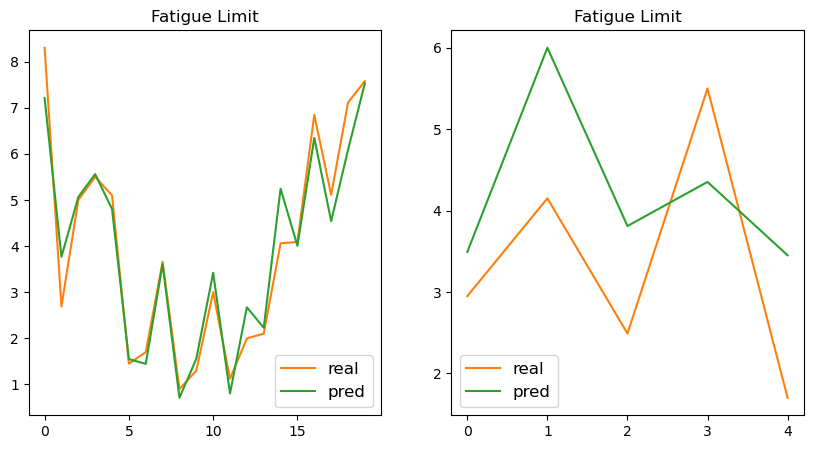

Epoch 801, loss: 3073.050048828125
Train set
[2.69      1.7       2.1       5.111111  5.1       1.3       7.577778
 6.8444448 4.09      1.125     8.3       7.1111107 3.66      3.
 5.        5.501     0.9       1.45      4.06      2.       ]
[3.874366   1.5015292  2.3090887  4.6457872  4.961865   1.5942267
 7.711801   6.514711   4.149256   0.8498097  7.429485   6.2552333
 3.735488   3.4759786  5.1938114  5.7169056  0.75106233 1.5887084
 5.382015   2.732298  ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4031477 5.8717747 3.7217455 4.323495  3.3765473]


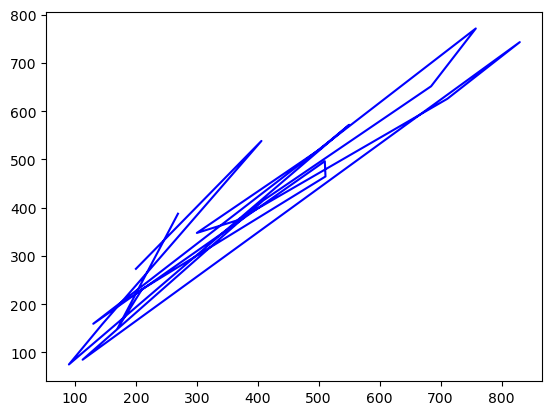

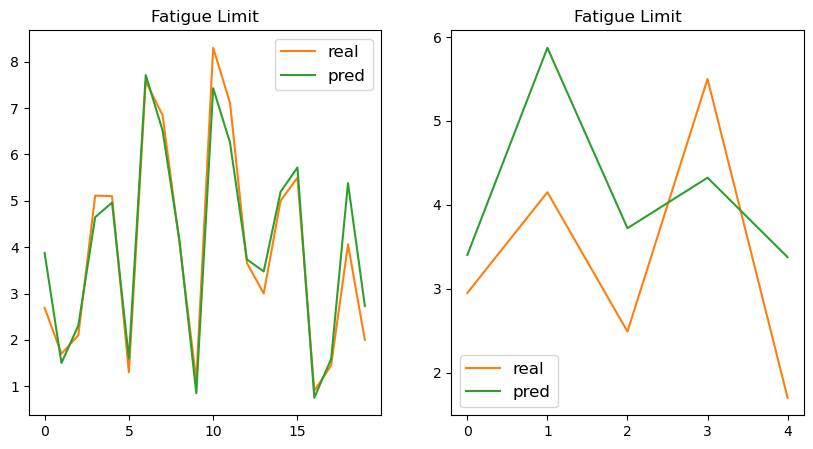

Epoch 811, loss: 2984.267822265625
Train set
[0.9       2.1       2.69      1.7       1.3       4.06      1.45
 5.111111  5.        8.3       3.        1.125     4.09      7.577778
 3.66      2.        5.1       6.8444448 7.1111107 5.501    ]
[0.7365072  2.276879   3.8204343  1.4733733  1.5698377  5.2853603
 1.5640862  4.628515   5.1235976  7.3416395  3.4110715  0.83681124
 4.0463076  7.6464844  3.6416879  2.6959963  4.896935   6.4413466
 6.1816826  5.6288404 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.409659  5.8691545 3.7631135 4.3653517 3.3981748]


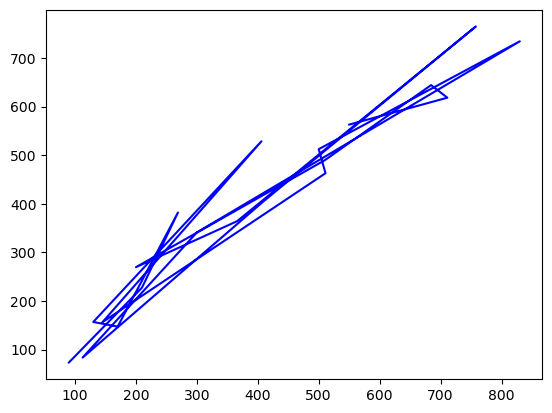

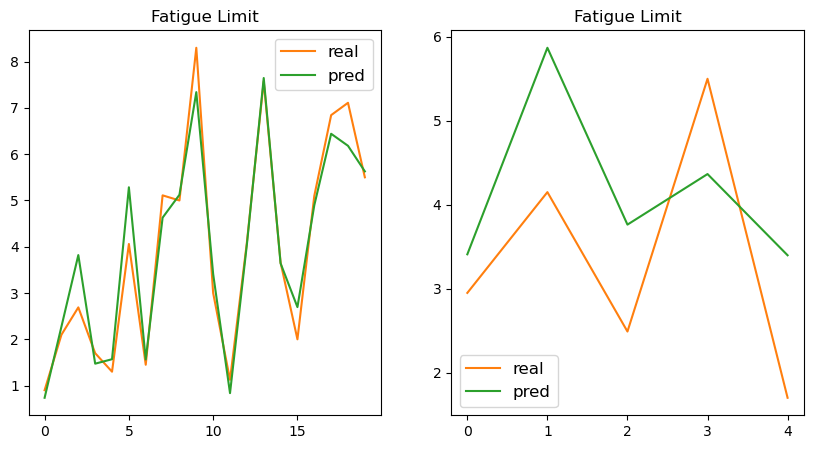

Epoch 821, loss: 2949.622314453125
Train set
[4.09      5.501     8.3       3.        2.        5.        1.45
 2.1       0.9       3.66      1.125     5.1       1.7       4.06
 6.8444448 1.3       7.577778  5.111111  7.1111107 2.69     ]
[4.024558   5.567073   7.2550426  3.359652   2.6419249  5.0656834
 1.5305519  2.2352915  0.71590376 3.6136506  0.8178028  4.8454514
 1.4446651  5.187467   6.380392   1.5368526  7.5726666  4.5919857
 6.1238265  3.7766747 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.4444373 5.9277344 3.8348937 4.481595  3.4470763]


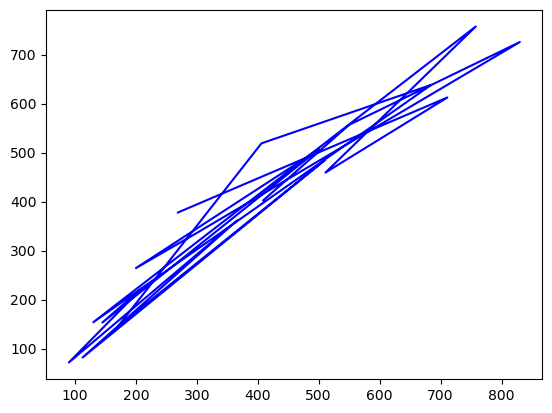

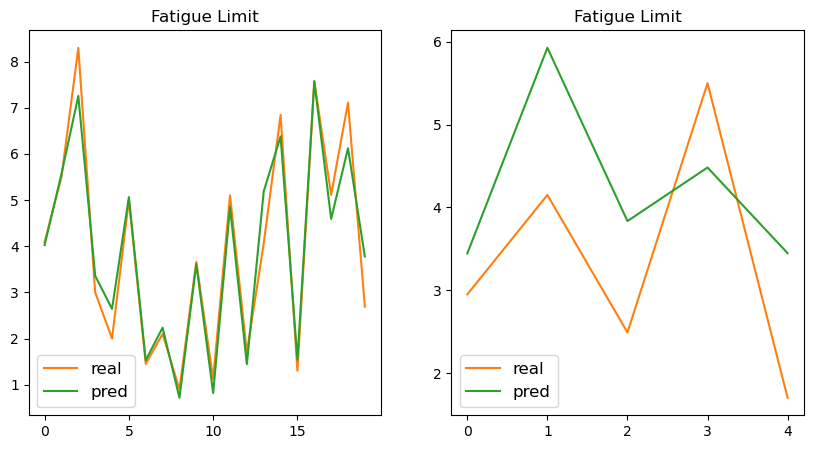

Epoch 831, loss: 2995.126220703125
Train set
[2.        3.66      1.45      2.1       3.        7.577778  1.7
 5.111111  4.09      5.        1.3       7.1111107 8.3       2.69
 0.9       1.125     6.8444448 5.501     5.1       4.06     ]
[2.7629428  3.7598832  1.6102382  2.374568   3.4762373  7.8642645
 1.5423998  4.773948   4.1869316  5.2951503  1.616249   6.4126177
 7.611402   3.9595065  0.78781486 0.88411033 6.673844   5.847684
 5.101415   5.423671  ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.3098583 5.70728   3.674553  4.4011564 3.3245099]


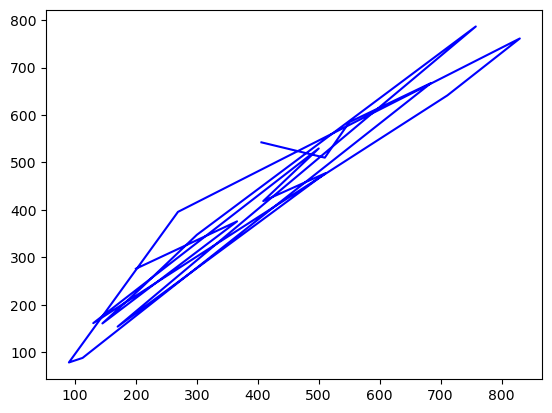

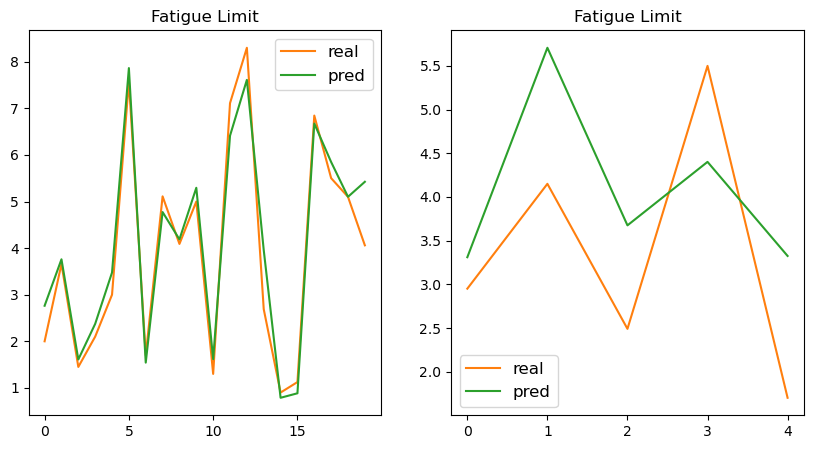

Epoch 841, loss: 2790.939453125
Train set
[5.501     4.06      5.        0.9       8.3       1.125     6.8444448
 5.1       2.69      1.3       3.66      1.45      2.        4.09
 7.577778  5.111111  3.        1.7       7.1111107 2.1      ]
[5.7480288 5.31409   5.2133923 0.7645214 7.5129795 0.8628814 6.5808287
 5.014937  3.8927262 1.5831168 3.739694  1.5788963 2.7117634 4.161814
 7.7665772 4.7437096 3.4151678 1.5084462 6.3209734 2.3322701]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.3424237 5.7583146 3.733064  4.5288    3.3685012]


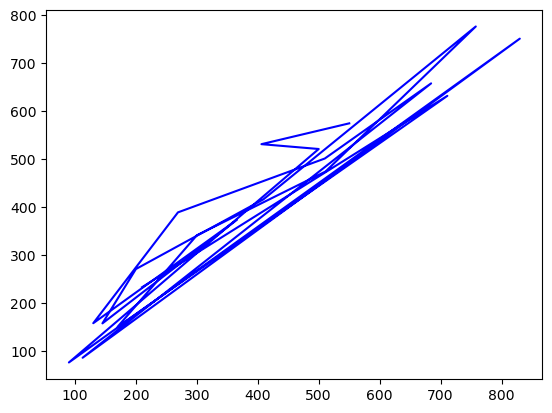

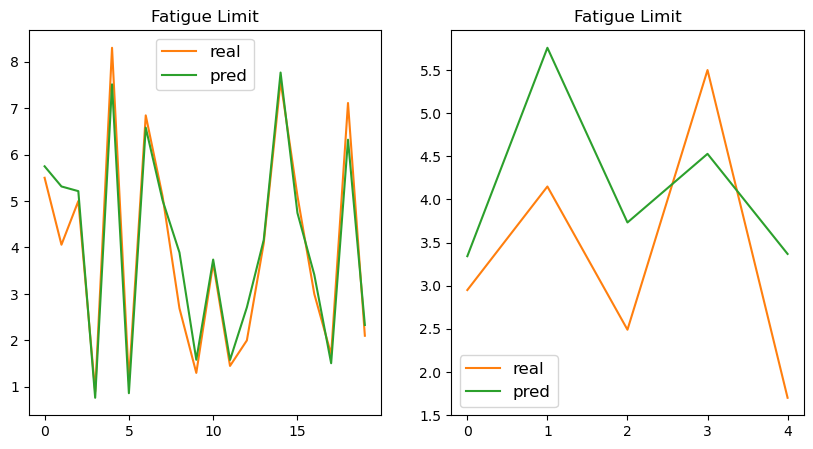

Epoch 851, loss: 2685.999267578125
Train set
[6.8444448 0.9       2.69      7.1111107 4.06      2.        7.577778
 3.66      5.1       5.501     4.09      2.1       3.        5.
 1.45      8.3       5.111111  1.7       1.125     1.3      ]
[6.5503564  0.75248355 3.8655722  6.2907686  5.2617183  2.6911051
 7.718012   3.6984348  4.981329   5.678234   4.1106243  2.3085775
 3.3883638  5.1826906  1.5723486  7.4945827  4.752051   1.4880551
 0.8479077  1.5792907 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.3372931 5.7290783 3.734273  4.5732627 3.3737566]


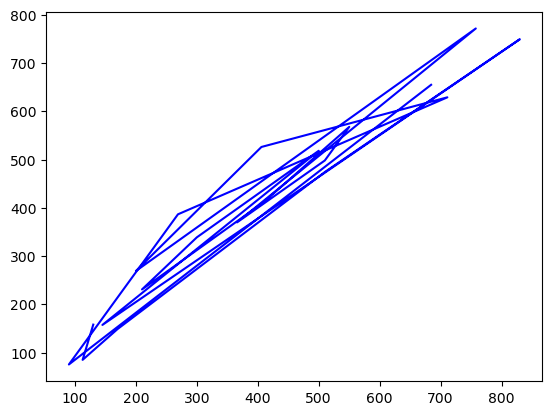

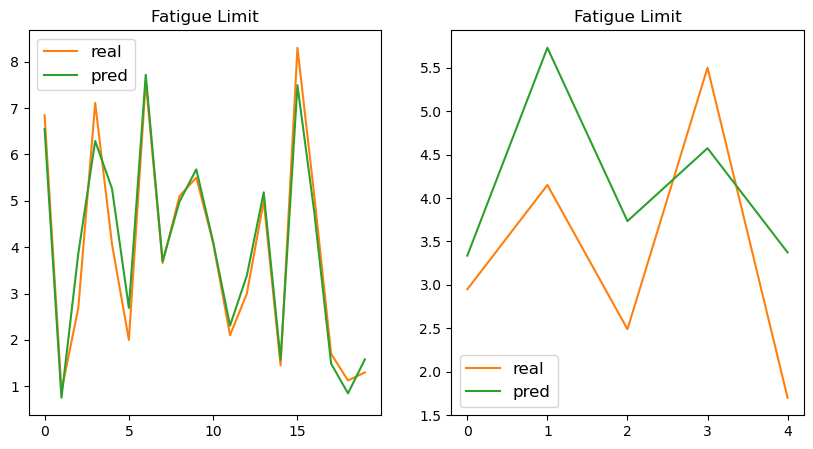

Epoch 861, loss: 2665.96923828125
Train set
[1.3       5.111111  8.3       1.7       4.06      2.69      4.09
 6.8444448 2.        5.1       7.577778  5.501     2.1       3.
 1.45      7.1111107 3.66      1.125     0.9       5.       ]
[1.5932019  4.810932   7.6105747  1.489709   5.309696   3.903535
 4.1410418  6.623371   2.7107599  5.036601   7.7833037  5.7247715
 2.3158376  3.4062238  1.5859929  6.360982   3.7292545  0.84739435
 0.7611451  5.234526  ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.2794907 5.6012807 3.6683102 4.5767727 3.3270457]


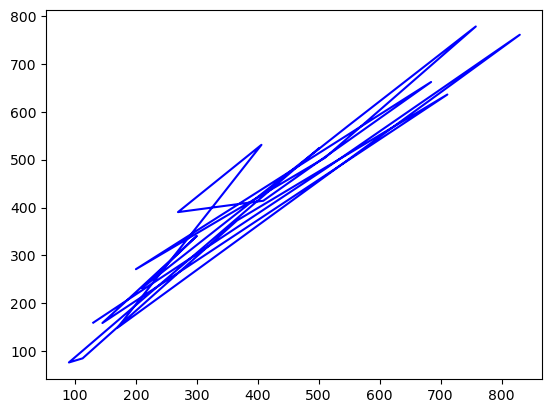

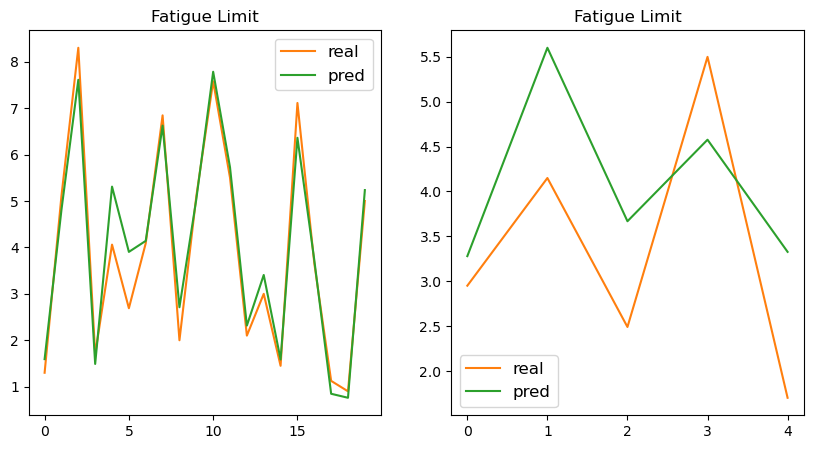

Epoch 871, loss: 2537.40087890625
Train set
[1.7       2.69      4.06      5.1       1.45      2.1       7.577778
 5.501     8.3       3.66      1.125     3.        5.111111  2.
 1.3       6.8444448 0.9       7.1111107 4.09      5.       ]
[1.4780586  3.8700855  5.2032323  4.9945583  1.5768864  2.30458
 7.7474275  5.6686974  7.523081   3.7009895  0.83948624 3.3675451
 4.798569   2.6734436  1.5792947  6.5885444  0.75070167 6.322584
 4.105234   5.1977386 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.266157  5.5604734 3.6680276 4.6653767 3.3257685]


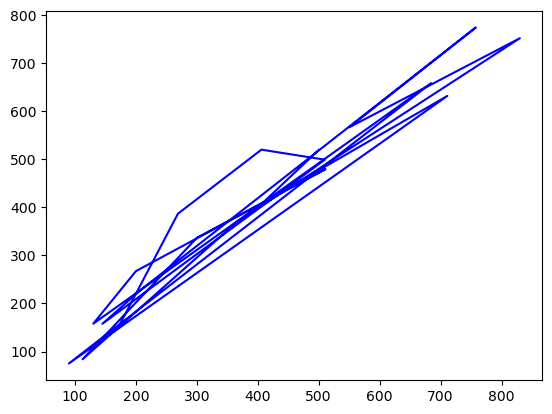

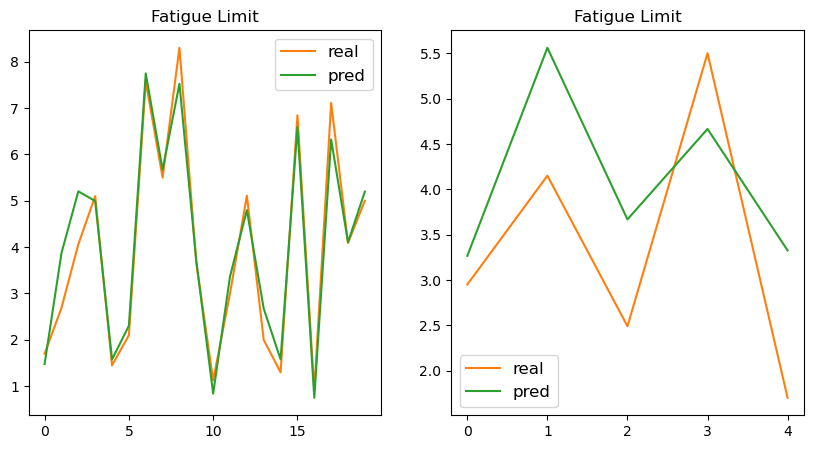

Epoch 881, loss: 2484.77197265625
Train set
[1.125     6.8444448 1.3       4.06      7.577778  1.45      2.
 5.111111  5.501     5.        8.3       3.66      2.1       7.1111107
 4.09      0.9       2.69      5.1       3.        1.7      ]
[0.80568117 6.4595613  1.5451152  5.0379705  7.614781   1.5422679
 2.5930884  4.7292686  5.528276   5.0836663  7.361121   3.586441
 2.2419882  6.189736   3.9698272  0.71668106 3.7744482  4.867456
 3.283277   1.4291549 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.3448424 5.707607  3.7933092 4.8376794 3.4172318]


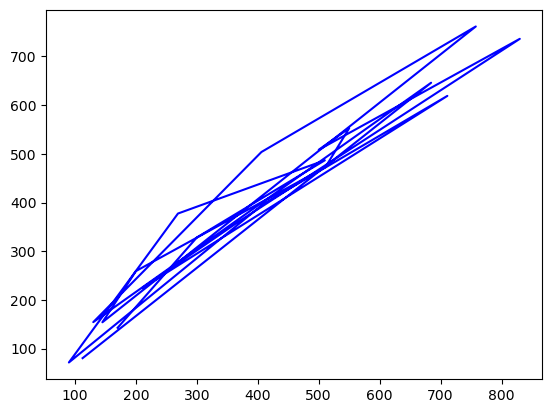

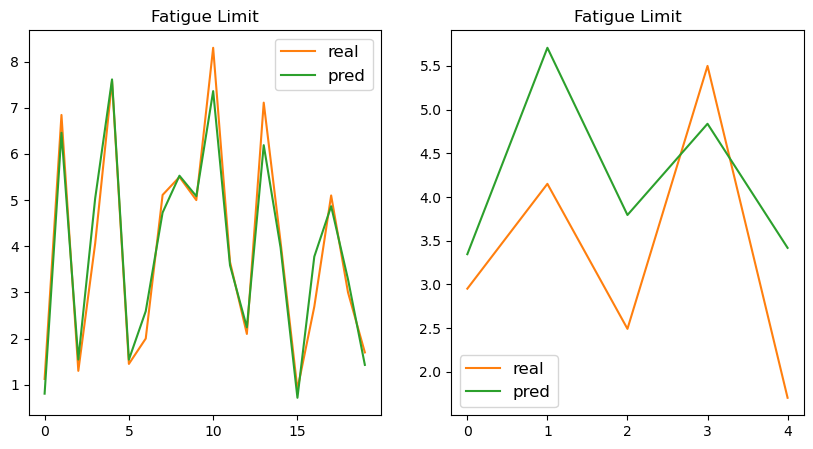

Epoch 891, loss: 2378.571533203125
Train set
[7.577778  3.        1.45      5.501     2.        4.09      3.66
 1.125     6.8444448 2.69      7.1111107 8.3       5.111111  5.
 0.9       1.7       4.06      5.1       1.3       2.1      ]
[7.7398686 3.3286626 1.5791173 5.652083  2.6411467 4.0672417 3.677182
 0.8307236 6.6022005 3.8549652 6.3263354 7.5580153 4.8238587 5.1905894
 0.744541  1.4724708 5.142365  4.9808755 1.5819081 2.3065908]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.2254386 5.5403113 3.6487525 4.8088317 3.309768 ]


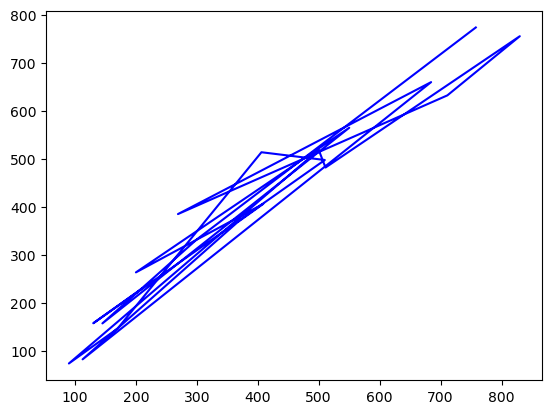

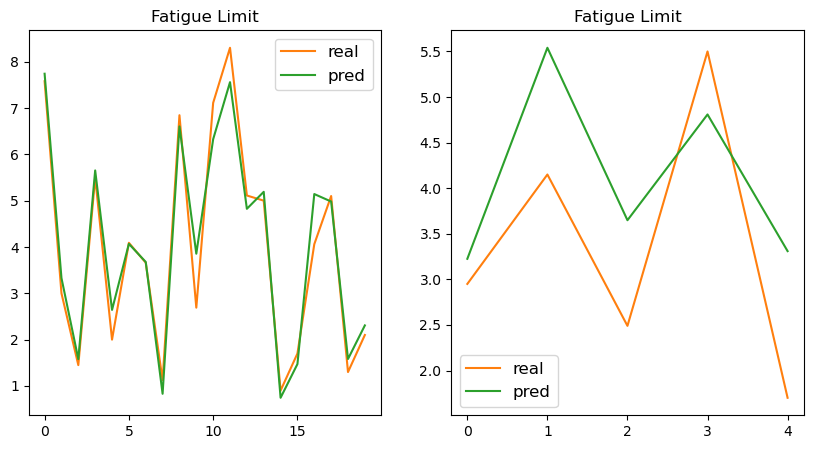

Epoch 901, loss: 2298.765625
Train set
[5.501     5.1       8.3       4.06      3.66      3.        0.9
 2.1       7.577778  7.1111107 1.125     4.09      5.        2.69
 1.7       2.        1.45      1.3       6.8444448 5.111111 ]
[5.590303   4.8853135  7.5028224  5.054982   3.6780639  3.2601883
 0.71676964 2.269014   7.6321926  6.2294397  0.8066049  4.0637646
 5.1055527  3.782287   1.4414383  2.5886724  1.5542313  1.5573976
 6.510304   4.7963676 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.2798603 5.661589  3.741833  5.0087676 3.377475 ]


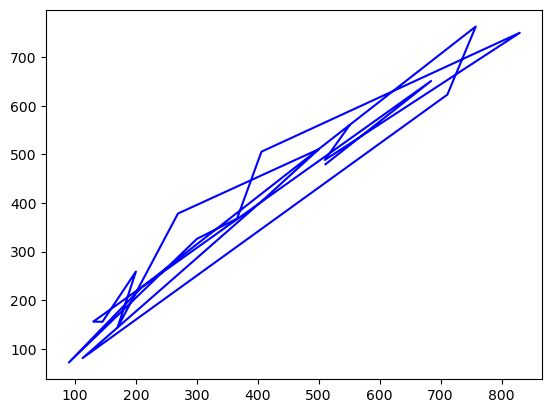

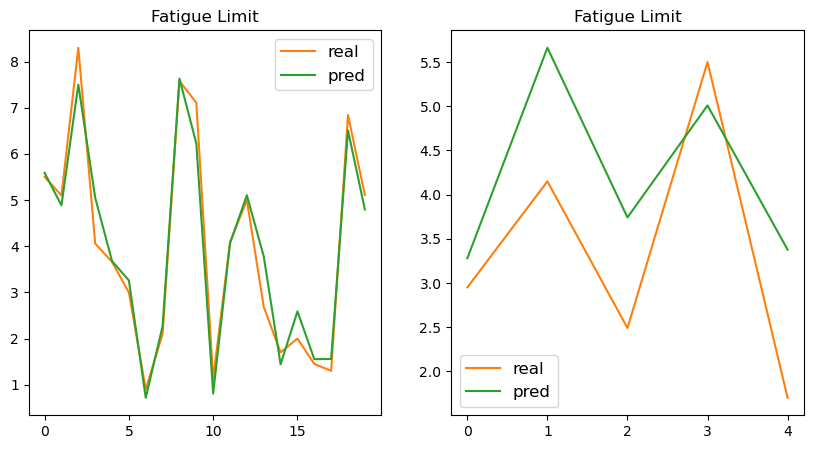

Epoch 911, loss: 2214.193603515625
Train set
[2.        2.1       1.7       7.577778  4.09      0.9       5.1
 7.1111107 6.8444448 5.111111  1.45      5.        5.501     4.06
 1.3       3.66      8.3       2.69      3.        1.125    ]
[2.591177   2.297302   1.4585245  7.6703863  4.10114    0.73802054
 4.910261   6.2676344  6.552748   4.8372836  1.577948   5.131737
 5.5672393  5.060218   1.5811756  3.7033873  7.572133   3.7981193
 3.2612095  0.8187981 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.2252917 5.527295  3.6801136 4.9853597 3.3343399]


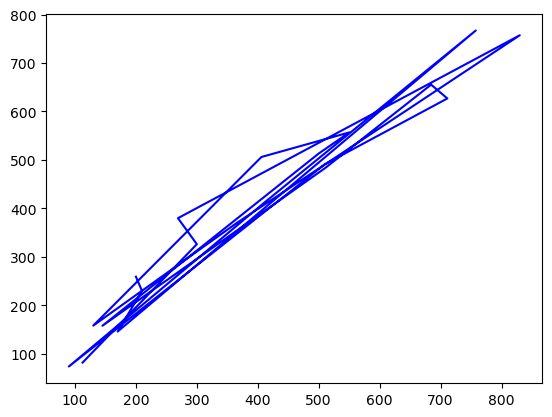

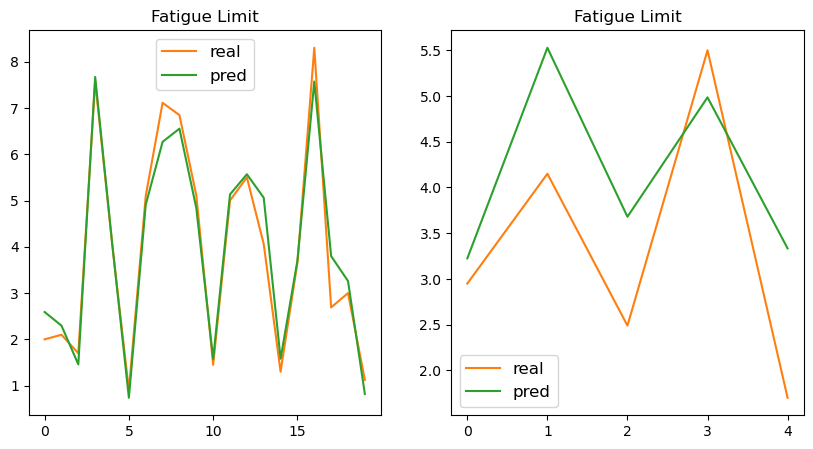

Epoch 921, loss: 2354.873291015625
Train set
[5.1       0.9       8.3       2.        1.7       5.501     4.06
 7.1111107 1.45      5.        1.3       5.111111  4.09      3.66
 3.        6.8444448 1.125     7.577778  2.1       2.69     ]
[5.1124406  0.768146   7.8160872  2.6764166  1.5111251  5.806512
 5.192337   6.504591   1.618544   5.321165   1.6216688  4.9659853
 4.1603456  3.761822   3.3523188  6.799519   0.84927636 7.8957076
 2.3746684  3.9435291 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.100875  5.2953033 3.5311422 4.8650346 3.2226112]


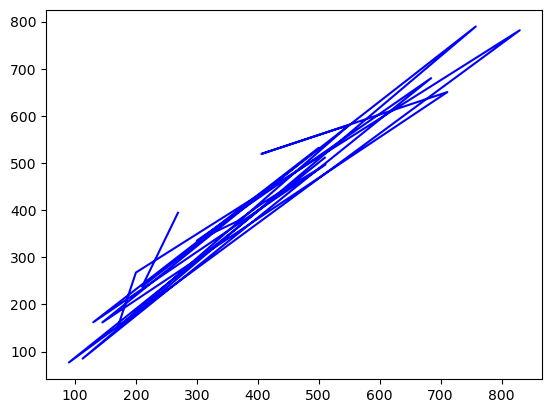

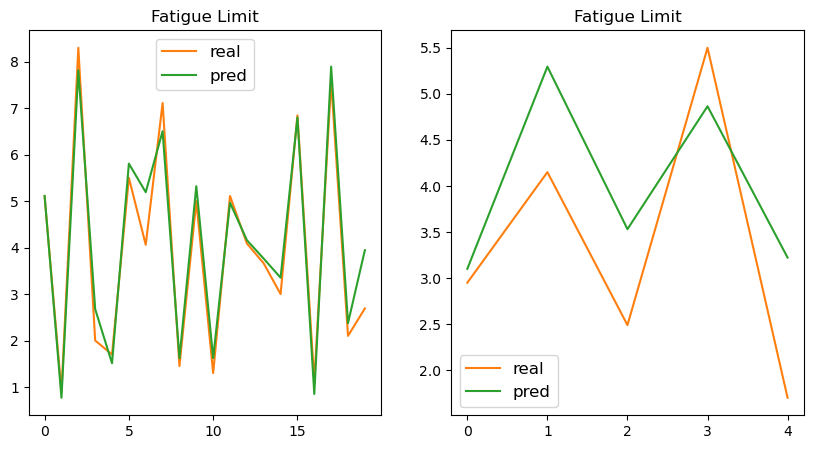

Epoch 931, loss: 2186.710693359375
Train set
[0.9       3.66      5.        1.3       2.69      7.577778  5.111111
 1.7       3.        4.09      7.1111107 1.45      1.125     2.1
 4.06      8.3       5.501     5.1       6.8444448 2.       ]
[0.6784992  3.6364918  5.0208983  1.5323195  3.7017648  7.4718623
 4.8112125  1.3953767  3.1607287  4.0155206  6.1478205  1.5283588
 0.77086276 2.220048   4.826735   7.3888354  5.4690742  4.788355
 6.438213   2.5150077 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.2615595 5.5137806 3.7682104 5.118629  3.3973358]


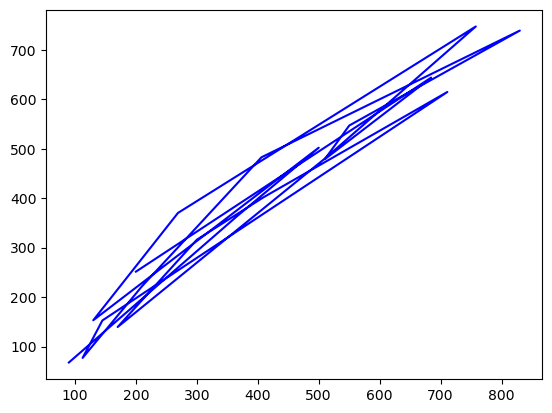

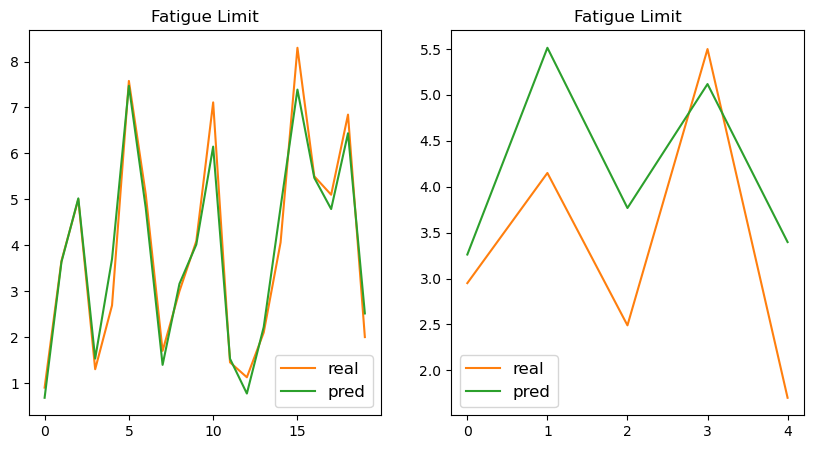

Epoch 941, loss: 2085.15576171875
Train set
[1.3       8.3       4.09      5.501     1.45      2.69      5.1
 4.06      0.9       2.        2.1       5.111111  7.1111107 6.8444448
 5.        3.        7.577778  1.125     3.66      1.7      ]
[1.6158105  7.8316026  4.138377   5.7249517  1.6123211  3.8803973
 5.0360236  5.104723   0.75080216 2.6241632  2.3685071  4.97938
 6.4350033  6.737806   5.2531543  3.2749     7.7400074  0.8498911
 3.7522137  1.5004873 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.1332493 5.2743654 3.6167595 4.970994  3.2810106]


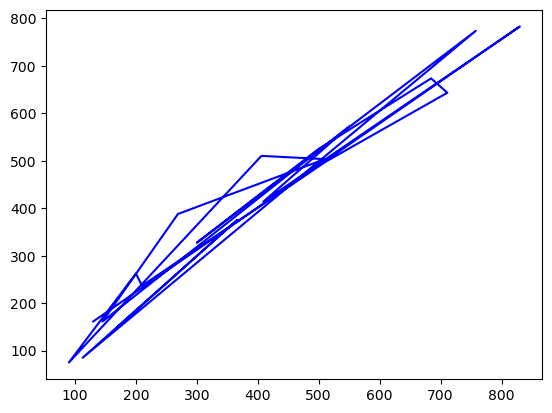

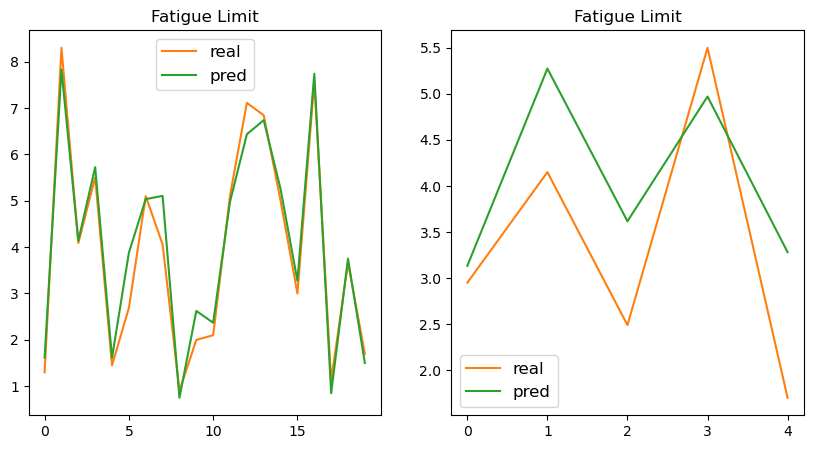

Epoch 951, loss: 1999.046142578125
Train set
[1.3       2.1       4.06      8.3       4.09      0.9       1.7
 5.501     5.        1.125     5.111111  1.45      2.69      6.8444448
 3.66      2.        3.        5.1       7.577778  7.1111107]
[1.5240226 2.2045782 4.7761693 7.466618  3.9747927 0.6615598 1.3777629
 5.4722056 5.0554495 0.7660044 4.840675  1.5197215 3.7164297 6.506635
 3.6047218 2.4864235 3.1370013 4.8161902 7.489993  6.1998243]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.1955717 5.3627453 3.7246635 5.1088414 3.3575757]


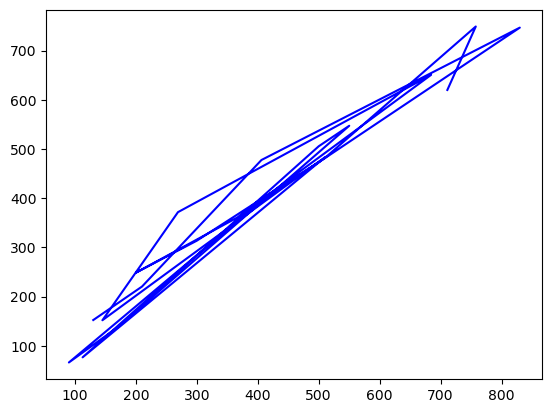

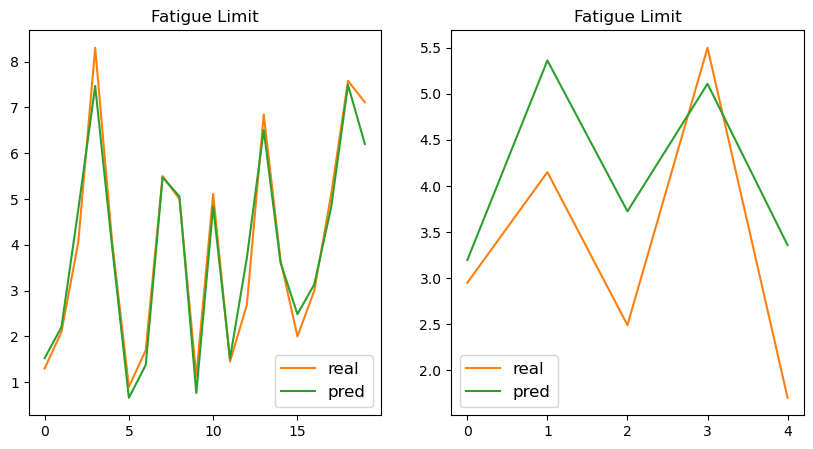

Epoch 961, loss: 1845.6353759765625
Train set
[3.        5.        1.45      2.        6.8444448 1.3       4.09
 0.9       5.501     5.1       8.3       1.125     5.111111  2.1
 4.06      1.7       7.577778  2.69      3.66      7.1111107]
[3.1760006  5.1562514  1.5508085  2.5513716  6.643591   1.5550604
 4.058761   0.6890831  5.614069   4.923096   7.7105465  0.79916155
 4.9609294  2.2649417  4.907249   1.4181861  7.616839   3.791332
 3.6542094  6.3290377 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.1645489 5.3259435 3.7020283 5.1678815 3.3396845]


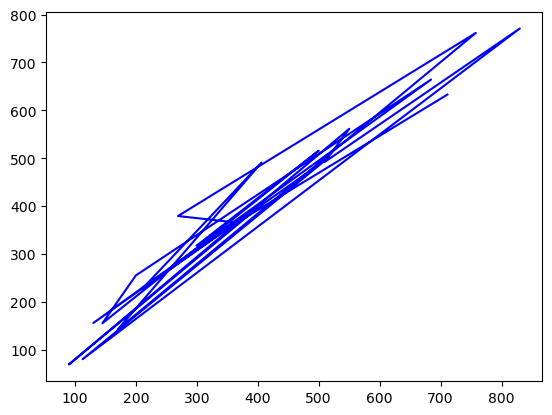

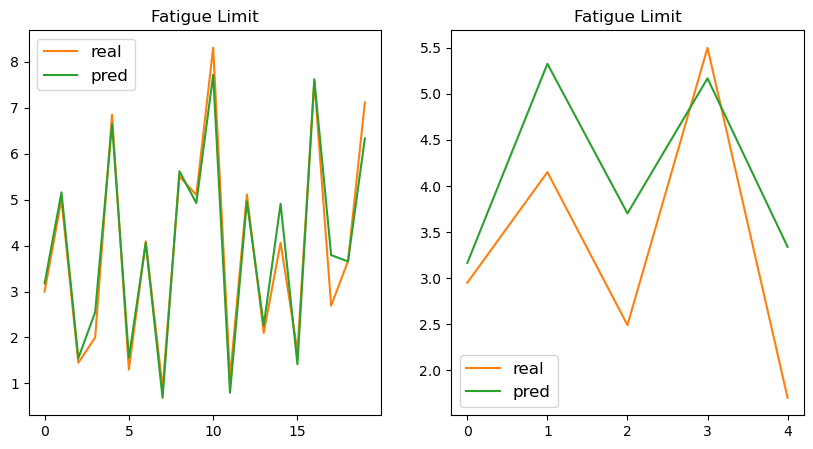

Epoch 971, loss: 1815.0015869140625
Train set
[0.9       2.1       1.3       5.111111  5.        4.09      3.
 8.3       3.66      5.501     4.06      5.1       6.8444448 1.45
 1.7       2.        1.125     7.577778  7.1111107 2.69     ]
[0.7224778 2.3283007 1.5904535 5.0227904 5.2298417 4.189108  3.2047656
 7.809204  3.6996386 5.665488  4.927373  5.0015364 6.7432795 1.5862366
 1.4608656 2.573681  0.8354168 7.6987457 6.425531  3.8451989]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.0895388 5.205942  3.6136587 5.056052  3.276448 ]


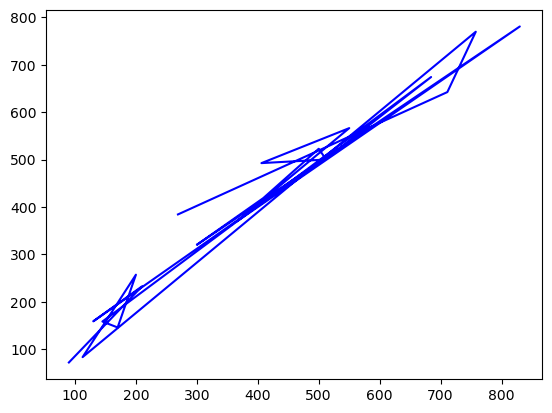

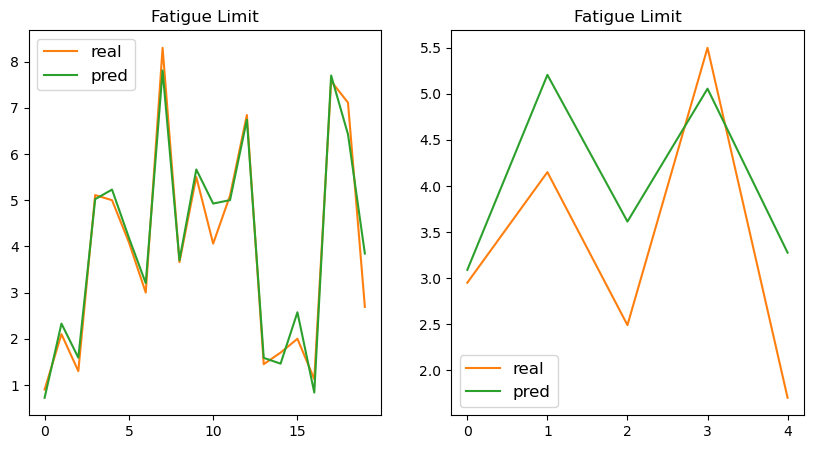

Epoch 981, loss: 1712.7587890625
Train set
[4.09      7.577778  6.8444448 0.9       3.66      5.1       1.7
 1.45      5.501     8.3       1.3       3.        5.        2.
 1.125     7.1111107 4.06      2.69      5.111111  2.1      ]
[4.063454   7.6243763  6.6734734  0.6954195  3.5902326  4.9314384
 1.4354619  1.5524592  5.6456776  7.651198   1.5570908  3.1483135
 5.1643615  2.5083559  0.82235855 6.353657   4.76168    3.7892206
 4.9761324  2.2954504 ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[3.153716  5.274966  3.7219498 5.1953197 3.3544443]


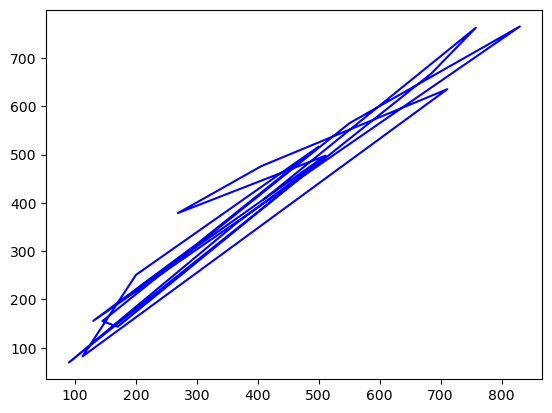

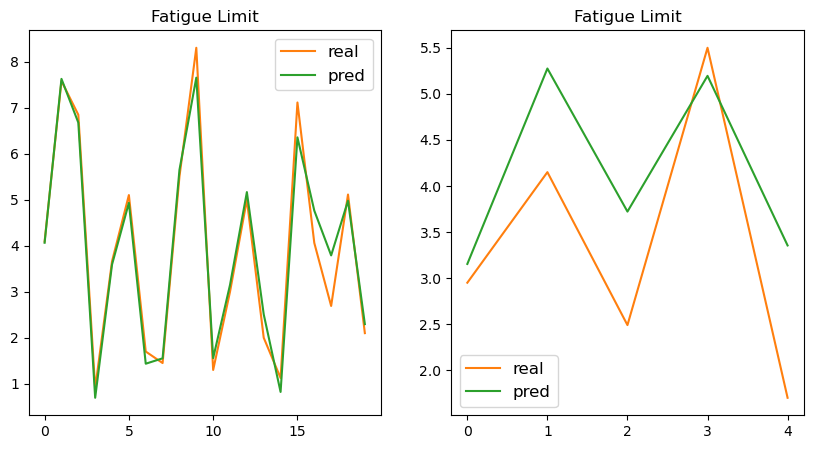

Epoch 991, loss: 1836.147216796875
Train set
[3.        2.1       5.111111  2.        6.8444448 2.69      7.577778
 7.1111107 4.06      5.1       1.45      5.        8.3       5.501
 4.09      1.7       1.3       1.125     0.9       3.66     ]
[3.2241943  2.3721914  5.093828   2.5890641  6.8593755  3.90517
 7.811973   6.542241   4.9408402  5.097474   1.5939692  5.311064
 7.9621806  5.8236995  4.1882     1.4943175  1.5985632  0.86828035
 0.74239427 3.703162  ]
Test set
[2.95      4.15      2.49      5.5       1.7010001]
[2.9733787 5.085883  3.4855359 5.081546  3.1841571]


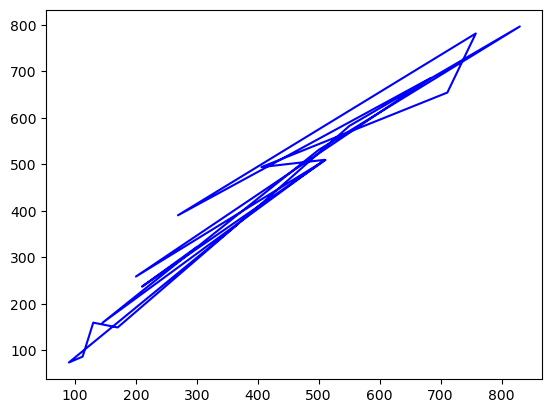

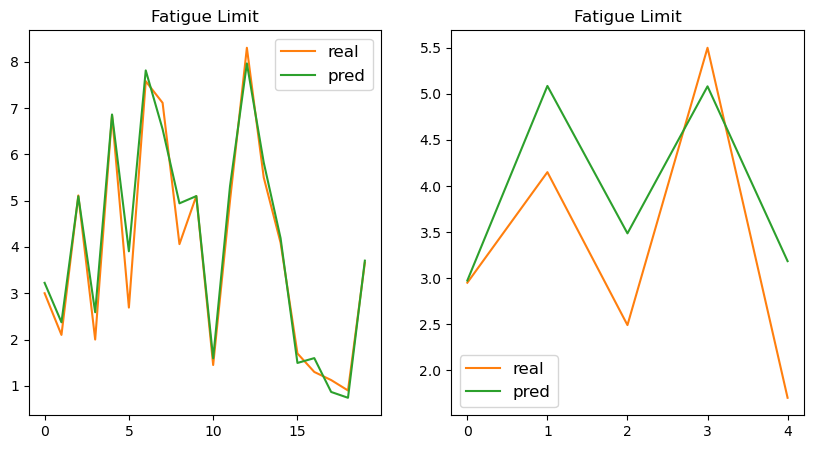

In [8]:
model = SingleOutputNeuralNetwork()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
loss_func = torch.nn.MSELoss()  # this is for regression mean squared loss

# Train the model
num_epochs = 1000 #100000
losses = []

plt.ion()

for epoch in range(num_epochs):
    for x_batch, y_batch in train_loader:
        # Forward pass
        y_predict = model(x_batch)
        loss = loss_func(y_predict, y_batch)
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        losses.append(loss.item())
        y_test_predict = model(df_x_test)
        
        if epoch % 10 == 0:
            print(f"Epoch {epoch+1}, loss: {loss.item()}")
            print("Train set")
            print(y_batch.data.numpy().squeeze()/100)
            print(y_predict.detach().numpy().squeeze()/100)
            print("Test set")
            print(df_y_test.data.numpy().squeeze()/100)
            print(y_test_predict.detach().numpy().squeeze()/100)
            
            plt.cla()
            plt.plot(y_batch,y_predict.detach().numpy()[:,0],'b-')
              
            fig, axs = plt.subplots(1, 2, figsize =(10, 5))
            # Real Values
            axs[0].plot(y_batch.data.numpy().squeeze()/100,'tab:orange', label = 'real')
            axs[0].set_title('Fatigue Limit')
            axs[0].legend(fontsize ='large')
            
            axs[1].plot(df_y_test.data.numpy().squeeze()/100, 'tab:orange',label = 'real')
            axs[1].set_title('Fatigue Limit')
            axs[1].legend(fontsize ='large')    
            
            # Predicted Values
            axs[0].plot(y_predict.detach().numpy().squeeze()/100,'tab:green',label = 'pred')
            axs[0].set_title('Fatigue Limit')
            axs[0].legend(fontsize ='large')

            axs[1].plot(y_test_predict.detach().numpy().squeeze()/100,'tab:green',label = 'pred')
            axs[1].set_title('Fatigue Limit')
            axs[1].legend(fontsize ='large')
        
            plt.draw();plt.pause(0.05)
                 
plt.ioff()
plt.show()

# Random Forest

[317.  108.  269.   82.1 140.  158.5 265.5 200.  189.5  51.5 258.5 193.
 120.  165.5 162.2 104.  217.  182.5 272.5 207.  224.  192.8 125.5 186.
 104.3  54.  122.  124.   89.5  98.9 111.7 145.  158.5  97.8 100.  116.8
 185.5 116.2 227.5 154.  109.4 104.  112.7 124.  210.5 132.6 178.  104.4]
[296.26  112.554 250.15   83.976 126.582 166.546 266.39  200.16  185.15
  63.168 254.25  188.77  115.616 168.96  141.538 111.176 215.36  180.516
 269.34  215.86  219.23  174.426 122.542 182.55  103.494  63.61  123.816
 124.202  79.31  104.982 112.554 145.83  150.15  103.88  109.068 120.066
 184.236 118.82  237.65  140.9   111.702 110.774 117.656 124.172 209.79
 128.014 181.59  105.854]
Train R^2 σf 	: 0.9821960016027212
Train MSE σf	: 63.86773441666666
Test R^2 σf	: 0.8581101785090497
Test MSE σf	: 311.40874433333295


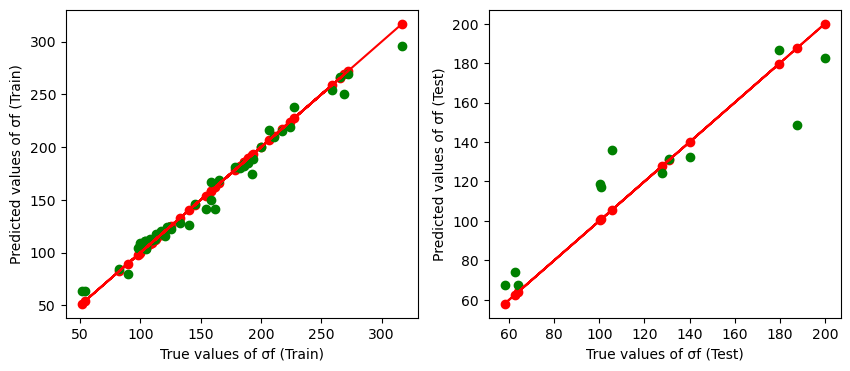

[ -77.  -79. -102.  -96. -107.  -74.  -89.  -80.  -90.  -59.  -90.  -71.
  -95.  -65. -135.  -92.  -81.  -80.  -81.  -82.  -70. -120. -102.  -73.
 -107.  -73.  -73.  -70. -120. -126.  -96. -100.  -90.  -82.  -80.  -97.
  -57.  -86.  -80. -140.  -75.  -71.  -66.  -70.  -90. -103.  -67.  -83.]
[ -78.38        -83.6725      -96.76       -105.24        -99.12
  -73.0352381   -89.71        -79.77        -82.57333333  -73.24
  -92.57        -71.78        -91.76        -66.48       -119.14
  -85.56        -80.7         -78.9477381   -80.8         -89.01
  -72.98       -109.46666667 -102.48        -76.31190476 -105.7
  -79.78        -75.70857143  -73.69666667 -114.12       -108.68
 -100.62        -93.72        -91.5         -89.95        -79.86
 -100.28        -69.24        -87.81333333  -80.07583333 -127.1
  -84.10666667  -86.42        -71.1         -69.06        -85.69
 -103.28        -70.62        -87.73666667]
Train R^2 b 	: 0.8671147113003199
Train MSE b	: 46.12411458185704
Test R^2 b	: 0

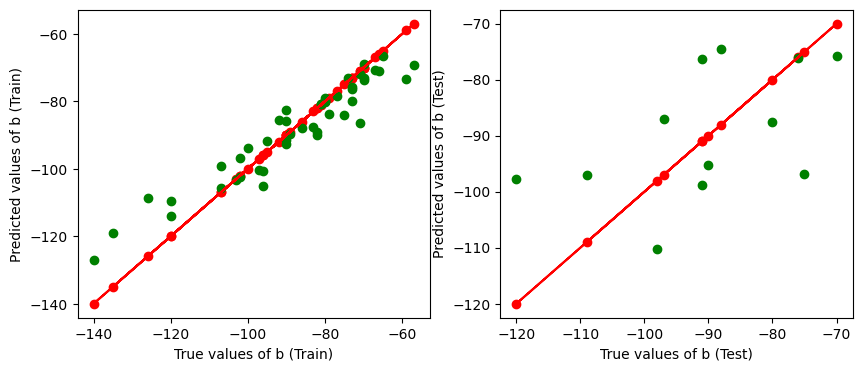

[ 8.  36.1 10.  21.6 44.9 45.   7.  40.  50.  30.  18.  40.  45.  30.
 51.5 31.6  9.  45.   7.  20.  60.  73.4 43.  60.  30.9 11.  41.  66.
 41.  43.3 26.4 22.  27.  18.7 32.  25.7 38.  53.4 25.  61.  30.9 16.
 30.9 66.  60.  60.2 32.  51.3]
[12.58       38.28345238 17.416      26.07333333 45.6265013  47.46963146
  8.48       46.15294444 46.55020491 28.068      20.348      39.71977778
 43.50835051 35.778      42.85721429 37.10080808 20.856      49.53758066
 11.08       21.928      44.41728571 59.278      39.39144444 52.06621429
 27.74333333 20.796      39.55947273 59.53639019 34.32533333 40.01406782
 29.335      25.86       26.86       26.85304762 36.70747273 29.21861905
 38.291      47.76071429 21.86       50.892      34.83890909 31.33
 37.64044444 56.63636364 47.73316667 51.82633333 35.18       50.27723665]
Train R^2 εf 	: 0.8543103547348286
Train MSE εf	: 43.706992223582056
Test R^2 εf	: 0.2207690467494331
Test MSE εf	: 338.37368204561136


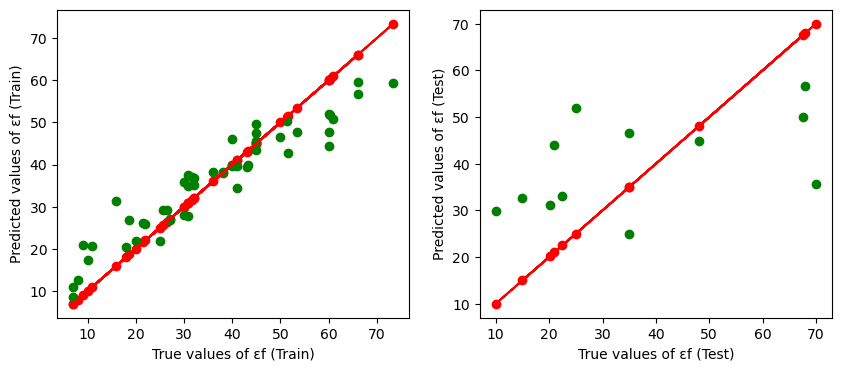

[-148.  -101.6  -84.  -106.  -106.  -136.  -152.  -146.  -150.  -102.
 -112.  -114.  -108.  -124.  -109.6 -106.  -122.  -150.  -120.  -154.
 -150.  -128.4 -105.8 -140.   -96.   -82.  -120.  -138.  -102.  -102.4
  -92.4 -102.  -106.  -106.  -116.   -92.8 -130.  -111.  -136.  -114.
 -100.4  -94.  -102.8 -138.  -152.  -116.  -112.  -111.4]
[-140.32       -103.78       -103.44       -103.60266667 -107.73733333
 -136.248      -142.68       -139.92       -145.76       -100.24266667
 -118.104      -123.44       -109.248      -126.4        -108.82
 -105.384      -131.2        -144.808      -128.36       -135.256
 -136.12       -122.216      -102.568      -139.84        -97.256
  -89.568      -119.032      -131.808       -97.40266667 -102.268
  -95.008      -110.848      -106.528      -106.364      -114.148
  -94.98       -133.248      -108.71733333 -135.44       -107.836
 -100.636       -98.372      -111.74       -131.704      -142.12
 -111.12       -118.28       -109.74933333]
Train R^2 c 	: 

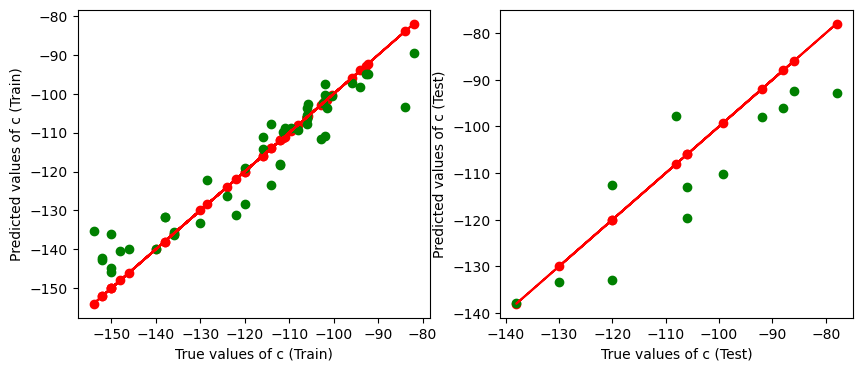

In [115]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

x_array = [5,6,7,8]
x_array_label = ['σf', 'b', 'εf', 'c']

plt.ion()

for x_input in range(len(x_array)):
    plt.ion()

    forest = RandomForestRegressor(n_estimators = 50, random_state= 1, max_depth = 10)

    df_x = pd.read_excel(root,usecols=[0,1,2,3,4])
    df_y = pd.read_excel(root,usecols= [x_array[x_input]]) # Using 1 variable for each random forest
    
    X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 100)
    
    y_train = np.ravel(y_train)
    
    forest.fit(X_train, y_train)
    
    y_train_pred = forest.predict(X_train)
    y_test_pred  = forest.predict(X_test)

    print(y_train)
    print(y_train_pred)
    
    f, axes = plt.subplots(1, 2, figsize = (10,4))
    axes[0].plot(y_train, y_train, color = 'r')
    axes[0].scatter(y_train, y_train, color = 'r')
    axes[0].scatter(y_train, y_train_pred, color = 'g')
    axes[0].set_xlabel("True values of " + x_array_label[x_input] + " (Train)")
    axes[0].set_ylabel("Predicted values of " + x_array_label[x_input] + " (Train)")
    
    axes[1].plot(y_test, y_test, color = 'r')
    axes[1].scatter(y_test, y_test, color = 'r')
    axes[1].scatter(y_test, y_test_pred, color = 'g')
    axes[1].set_xlabel("True values of " + x_array_label[x_input] + " (Test)")
    axes[1].set_ylabel("Predicted values of " + x_array_label[x_input] + " (Test)")
    
    mse_train = mean_squared_error(y_train, y_train_pred)
    mse_test  = mean_squared_error(y_test, y_test_pred)
    
    var_train = forest.score(X_train, y_train)
    var_test  = forest.score(X_test, y_test)
    
    print("Train R^2 " + x_array_label[x_input] + " \t:", var_train)
    print("Train MSE " + x_array_label[x_input] + "\t:", mse_train)
    print("Test R^2 " + x_array_label[x_input] + "\t:", var_test)
    print("Test MSE " + x_array_label[x_input] + "\t:", mse_test)
    
    plt.draw();plt.pause(0.05)

plt.ioff()
plt.show()

Train R^2 σf 	: 0.9831708208732242
Train MSE σf	: 60.3707953087501
Test R^2 σf	: 0.852713473302957
Test MSE σf	: 323.25301317592687


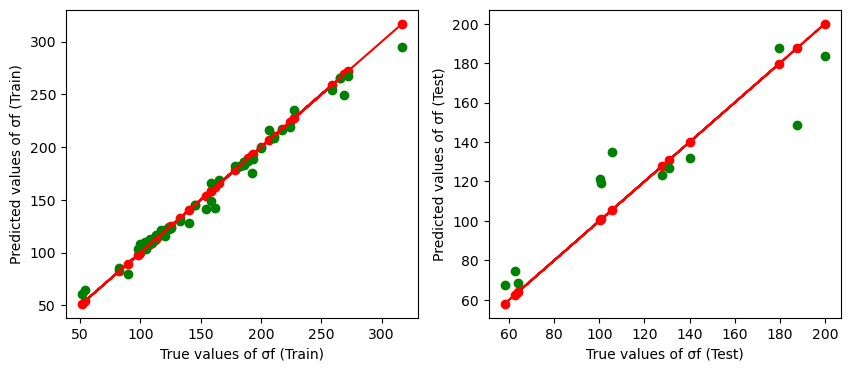

In [45]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

plt.ion()

x_array = [5,6,7,8]
x_array_label = ['σf', 'b', 'εf', 'c']

forest = RandomForestRegressor(random_state= 1, max_depth = 10)

df_x = pd.read_excel(root,usecols=[0,1,2,3,4])
df_y = pd.read_excel(root,usecols=[5]) # Using 1 variable for each random forest

X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 100)

y_train = np.ravel(y_train)

forest.fit(X_train, y_train)

y_train_pred = forest.predict(X_train)
y_test_pred  = forest.predict(X_test)

f, axes = plt.subplots(1, 2, figsize = (10,4))
axes[0].plot(y_train, y_train, color = 'r')
axes[0].scatter(y_train, y_train, color = 'r')
axes[0].scatter(y_train, y_train_pred, color = 'g')
axes[0].set_xlabel("True values of " + 'σf' + " (Train)")
axes[0].set_ylabel("Predicted values of " + 'σf' + " (Train)")

axes[1].plot(y_test, y_test, color = 'r')
axes[1].scatter(y_test, y_test, color = 'r')
axes[1].scatter(y_test, y_test_pred, color = 'g')
axes[1].set_xlabel("True values of " + 'σf' + " (Test)")
axes[1].set_ylabel("Predicted values of " + 'σf' + " (Test)")

mse_train = mean_squared_error(y_train, y_train_pred)
mse_test  = mean_squared_error(y_test, y_test_pred)

var_train = forest.score(X_train, y_train)
var_test  = forest.score(X_test, y_test)

print("Train R^2 " + 'σf' + " \t:", var_train)
print("Train MSE " + 'σf' + "\t:", mse_train)
print("Test R^2 " + 'σf' + "\t:", var_test)
print("Test MSE " + 'σf' + "\t:", mse_test)

plt.ioff()

# MLPRegressor

Train R^2 σf 	: 0.9748977515946485
Train MSE σf	: 90.04852160957397
Test R^2 σf	: 0.7620326815372895
Test MSE σf	: 522.2721619927432


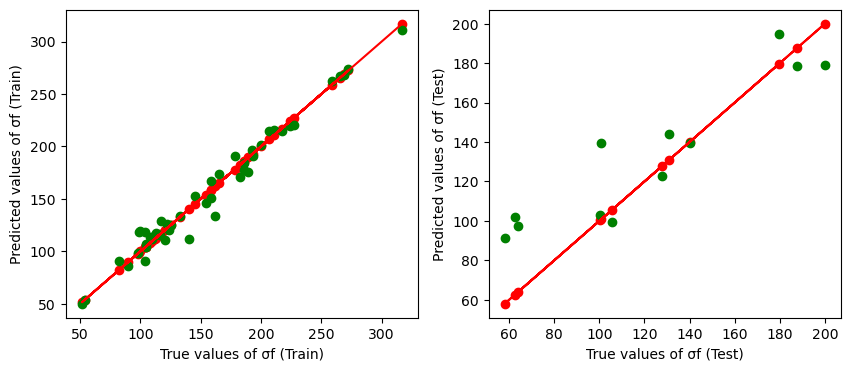

In [52]:
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error

plt.ion()

MLP_model = MLPRegressor(solver = 'lbfgs', activation = 'relu', max_iter= 3000, random_state = 100)

df_x = pd.read_excel(root,usecols=[0,1,2,3,4])
df_y = pd.read_excel(root,usecols=[5]) # Using 1 variable for each MLPRegressor

X_train, X_test, y_train, y_test = train_test_split(df_x, df_y, test_size = 0.2, random_state = 100)

y_train = np.ravel(y_train)

MLP_model.fit(X_train, y_train)

y_train_pred = MLP_model.predict(X_train)
y_test_pred  = MLP_model.predict(X_test)

f, axes = plt.subplots(1, 2, figsize = (10,4))
axes[0].plot(y_train, y_train, color = 'r')
axes[0].scatter(y_train, y_train, color = 'r')
axes[0].scatter(y_train, y_train_pred, color = 'g')
axes[0].set_xlabel("True values of " + 'σf' + " (Train)")
axes[0].set_ylabel("Predicted values of " + 'σf' + " (Train)")

axes[1].plot(y_test, y_test, color = 'r')
axes[1].scatter(y_test, y_test, color = 'r')
axes[1].scatter(y_test, y_test_pred, color = 'g')
axes[1].set_xlabel("True values of " + 'σf' + " (Test)")
axes[1].set_ylabel("Predicted values of " + 'σf' + " (Test)")

mse_train = mean_squared_error(y_train, y_train_pred)
mse_test  = mean_squared_error(y_test, y_test_pred)

var_train = MLP_model.score(X_train, y_train)
var_test  = MLP_model.score(X_test, y_test)

print("Train R^2 " + 'σf' + " \t:", var_train)
print("Train MSE " + 'σf' + "\t:", mse_train)
print("Test R^2 " + 'σf' + "\t:", var_test)
print("Test MSE " + 'σf' + "\t:", mse_test)

plt.ioff()